# **Data import**

In [ ]:
import pandas as pd

In [ ]:
#Getting Data source
!pip install -q kaggle

In [ ]:
from google.colab import drive #เชื่อม gg drive
drive.mount('/content/gdrive') #ไฟล์ชื่อ gdrive

Mounted at /content/gdrive


In [ ]:
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle" #สร้าง Floder ชื่อว่า  kaggle

In [ ]:
!kaggle datasets download -d mirichoi0218/insurance

  0% 0.00/16.0k [00:00<?, ?B/s]
100% 16.0k/16.0k [00:00<00:00, 24.1MB/s]


In [ ]:
!unzip /content/insurance.zip  && rm /content/insurance.zip

Archive:  /content/insurance.zip
  inflating: insurance.csv           


In [ ]:
path = "/content/insurance.csv"
df = pd.read_csv(path) #เก็บข้อมูล insurance ไว้ในตัวแปร df
df

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
...,...,...,...,...,...,...,...
1333,50,male,30.970,3,no,northwest,10600.54830
1334,18,female,31.920,0,no,northeast,2205.98080
1335,18,female,36.850,0,no,southeast,1629.83350
1336,21,female,25.800,0,no,southwest,2007.94500


# **Data Preparation (EDA)**

## **1. ทำความรู้จักกับข้อมูล**

In [ ]:
df.shape #ดูขนาดของข้อมูล

(1338, 7)

In [ ]:
df.info() #ดูภาพรวมของข้อมูลว่าแต่ละคอลัมน์เป็น Type อะไรและดูว่าข้อมูลมี Missing Value หรือไม่
#จากที่ดู Output แล้วข้อมูลไม่มี Missing Value

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


## **2. ตรวจสอบความถูกต้องของข้อมูล**

In [ ]:
df.isnull().sum() #ตรวจสอบ null อีกครั้งว่าไม่มี null ทุกคอลัมน์

age         0
sex         0
bmi         0
children    0
smoker      0
region      0
charges     0
dtype: int64

In [ ]:
#แปลงข้อมูล sex
male = 1
female = 2
df['sex'] = [male if a == 'male' else female for a in df['sex']]

In [ ]:
#แปลงข้อมูล smoker
yes = 1
no = 0
df['smoker'] = [yes if a == 'yes' else no for a in df['smoker']]

In [ ]:
def c_region(r):
  if r == 'southeast':
    return 1
  elif r =='southwest':
    return 2
  elif r =='northwest':
    return 3
  elif r =='northeast':
    return 4

In [ ]:
#แปลงข้อมูล region
df['region'] = [c_region(i) for i in df['region']]

## **3. สำรวจข้อมูลเชิงสถิติ**

In [ ]:
df.describe() #ดูค่าสถิติเบื้องต้นของข้อมูล

,age,sex,bmi,children,smoker,region,charges
count,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000,1338.000000
mean,39.207025,1.494768,30.663397,1.094918,0.204783,2.455157,13270.422265
std,14.049960,0.500160,6.098187,1.205493,0.403694,1.130197,12110.011237
min,18.000000,1.000000,15.960000,0.000000,0.000000,1.000000,1121.873900
25%,27.000000,1.000000,26.296250,0.000000,0.000000,1.000000,4740.287150
50%,39.000000,1.000000,30.400000,1.000000,0.000000,2.000000,9382.033000
75%,51.000000,2.000000,34.693750,2.000000,0.000000,3.000000,16639.912515
max,64.000000,2.000000,53.130000,5.000000,1.000000,4.000000,63770.428010


## **4. ความสัมพันธ์ของข้อมูล**

<Axes: >

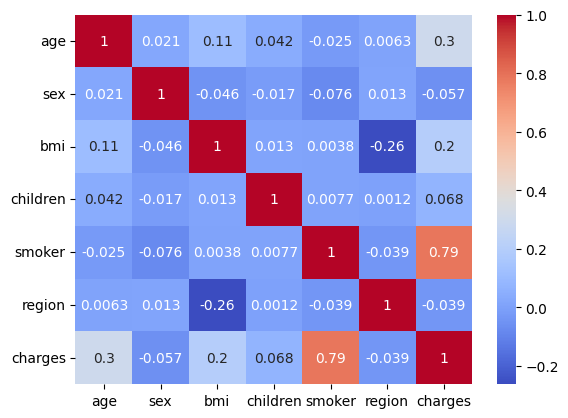

In [ ]:
import seaborn as sns
sns.heatmap(df.corr(), cmap='coolwarm', annot=True) #ดูความสัมพันธ์ของทุกตัวแปร

##**5. สร้าง Box plot ดู Outlier**

{'whiskers': [<matplotlib.lines.Line2D at 0x7fbdcc2b1330>,
 'caps': [<matplotlib.lines.Line2D at 0x7fbdcc2b1870>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fbdcc2b1090>,
 'medians': [<matplotlib.lines.Line2D at 0x7fbdcc2b1db0>,
 'fliers': [<matplotlib.lines.Line2D at 0x7fbdcc2b2050>,
 'means': []}

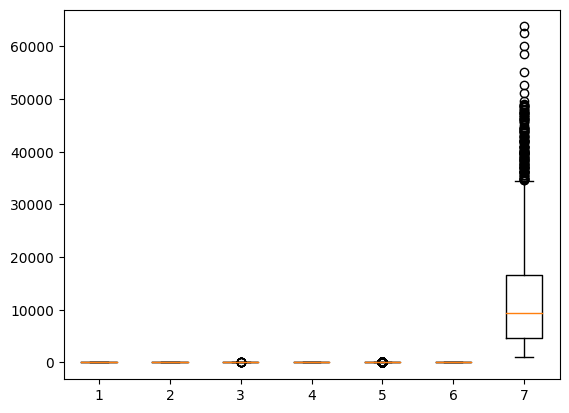

In [ ]:
#สร้าง Boxplot
import matplotlib.pyplot as plt
plt.boxplot(df)

{'whiskers': [<matplotlib.lines.Line2D at 0x7fbdcc19fb20>,
 'caps': [<matplotlib.lines.Line2D at 0x7fbdcc1dc0a0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fbdcc19f880>,
 'medians': [<matplotlib.lines.Line2D at 0x7fbdcc1dc5e0>,
 'fliers': [],
 'means': []}

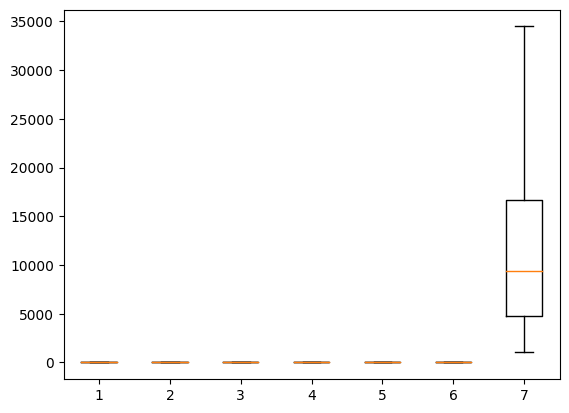

In [ ]:
#สร้าง Boxplot ที่ซ่อน Outliers
plt.boxplot(df, showfliers = False)

# **Regression Model**

## **Original**

In [ ]:
!pip install catboost #ติดตั้ง catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.5/98.5 MB 4.1 MB/s eta 0:00:00


In [ ]:
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import cross_val_score

In [ ]:
y = df["charges"]
X = df.drop(columns= ['charges'])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
#random_state คือการ set seed, test_size แบ่งชุดทดสอบเป็น 20%

In [ ]:
#สร้าง list ที่เก็บ วิธีต่างๆและชื่อของ Modelต่างๆ
model_re = [
   [KNeighborsRegressor(n_neighbors = 3), ' KNeighborsRegressor'],
   [DecisionTreeRegressor(), 'DecisionTreeRegressor'],
   [GradientBoostingRegressor(), 'XGBoostRegressor'],
   [LinearRegression(), ' LinearRegression'],
   [RandomForestRegressor(), 'RandomForestRegressor'],
   [BaggingRegressor(), 'BaggingRegressor'],
   [AdaBoostRegressor(), 'AdaBoostRegressor'],
   [MLPRegressor(), 'MLPRegressor'],
   [SVR(), 'SVR'],
   [GaussianProcessRegressor(), 'GaussianProcessRegressor'],
   [LGBMRegressor(), 'lightGBM'],
   [CatBoostRegressor(), 'CatBoostRegressor']
]

In [ ]:
model_scores = []

#สร้าง for loop มา fit model และหา y_pred ตามวิธีที่กำหนดไว้ใน model_re และวัดประสิทธิภาพโดยเก็บไว้ใน model_scores
#โดยวัดประสิทธิภาพ 4 ตัวนั้นคือMSE, MAE, RMSE, R_Squared
for model, name in model_re:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    MSE = mean_squared_error(y_test, y_pred)
    MAE = mean_absolute_error(y_test, y_pred)
    RMSE = np.sqrt(MSE)
    R_Squared = r2_score(y_test, y_pred)

    model_scores.append([MSE, MAE, RMSE, R_Squared, name])

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000406 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score 13346.089733
Learning rate set to 0.041383
0:	learn: 11642.0956712	total: 48.6ms	remaining: 48.6s
1:	learn: 11306.4501348	total: 52.4ms	remaining: 26.2s
2:	learn: 10977.9833538	total: 54ms	remaining: 17.9s
3:	learn: 10664.7285260	total: 55.5ms	remaining: 13.8s
4:	learn: 10342.7045711	total: 57.7ms	remaining: 11.5s
5:	learn: 10038.8822953	total: 59.9ms	remaining: 9.92s
6:	learn: 9779.4536553	total: 61.8ms	remaining: 8.77s
7:	learn: 9515.4396882	total: 63.7ms	remaining: 7.9s
8:	learn: 9255.4327854	total: 65.6ms	remaining: 7.22s
9:	learn: 9031.6324561	total: 67.6ms	remaining: 6.69s
10:	learn: 8807.5911

### **Perfomance**

In [ ]:
#นำข้อมูลแปลงเป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['MSE','MAE','RMSE','R-squared', 'regression'])

#เรียงลำดับโดยค่า R-squared จากมากไปน้อย
dscore_class.sort_values(by='R-squared', ascending=False)

,MSE,MAE,RMSE,R-squared,regression
2,1.877942e+07,2397.931240,4333.523209,0.879037,XGBoostRegressor
11,2.014933e+07,2515.947313,4488.800296,0.870213,CatBoostRegressor
10,2.070811e+07,2570.574991,4550.616571,0.866613,lightGBM
5,2.146597e+07,2495.322713,4633.138112,0.861732,BaggingRegressor
4,2.149919e+07,2497.412414,4636.722430,0.861518,RandomForestRegressor
6,2.587429e+07,3968.592859,5086.677312,0.833337,AdaBoostRegressor
3,3.354491e+07,4174.047876,5791.796559,0.783928,LinearRegression
1,4.393153e+07,3198.254554,6628.086395,0.717025,DecisionTreeRegressor
0,1.425240e+08,7514.107972,11938.340753,0.081964,KNeighborsRegressor
7,1.463230e+08,7840.914922,12096.404381,0.057493,MLPRegressor


### **Compairision Y_test & Y_predict**

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000198 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score 13346.089733
Learning rate set to 0.041383
0:	learn: 11642.0956712	total: 5.59ms	remaining: 5.58s
1:	learn: 11306.4501348	total: 10.4ms	remaining: 5.19s
2:	learn: 10977.9833538	total: 12.3ms	remaining: 4.08s
3:	learn: 10664.7285260	total: 16.6ms	remaining: 4.12s
4:	learn: 10342.7045711	total: 35.5ms	remaining: 7.07s
5:	learn: 10038.8822953	total: 41ms	remaining: 6.78s
6:	learn: 9779.4536553	total: 45.3ms	remaining: 6.43s
7:	learn: 9515.4396882	total: 59.1ms	remaining: 7.32s
8:	learn: 9255.4327854	total: 68.7ms	remaining: 7.56s
9:	learn: 9031.6324561	total: 70.2ms	remaining: 6.95s
10:	learn: 8807.5911269	total: 72.1ms	remaining: 6.48s
11:	learn: 8580.4745143	tota

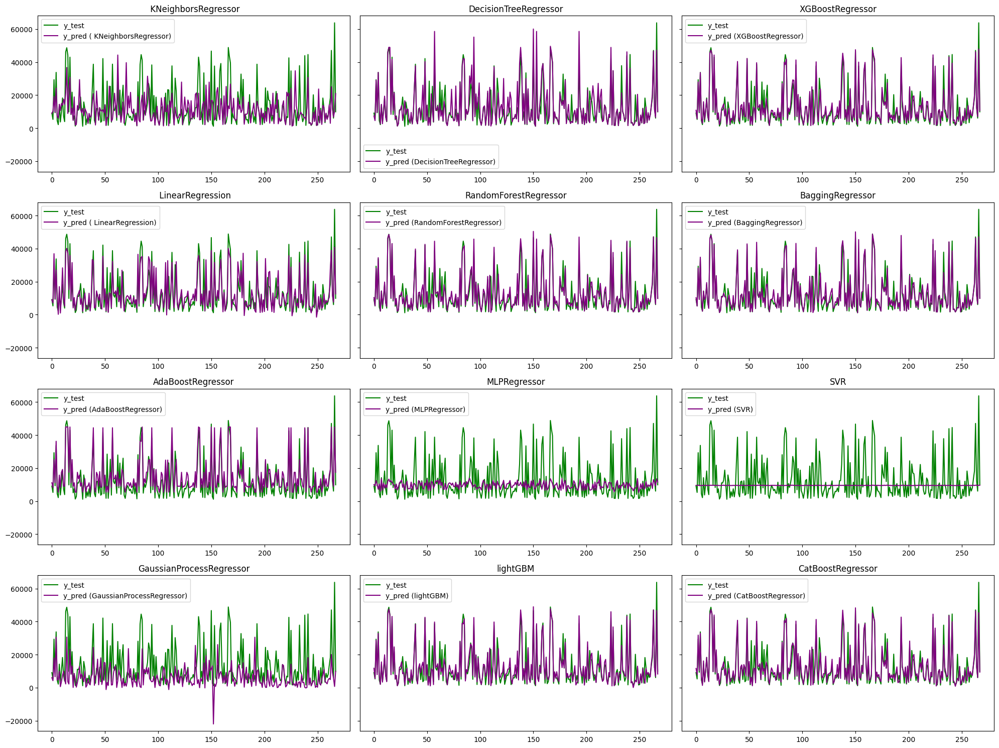

In [ ]:
# สร้างลิสต์เพื่อเก็บผลลัพธ์ของทุกโมเดล
model_predicts = []

# วนลูปทุกโมเดลใน algo
for model, model_name in model_re:
    # สร้างลิสต์เพื่อเก็บผลลัพธ์ของแต่ละโมเดล
    model_predict = []

    # ทำการฝึกสอนและทำนายบนข้อมูลทดสอบ
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # เก็บผลลัพธ์ลงในลิสต์ model_predict
    model_predict.append([y_pred, model_name])

    # เก็บลิสต์ model_predict ลงในลิสต์ model_predicts
    model_predicts.append(model_predict)

# พล็อตกราฟเส้นสำหรับทุกโมเดล
# สร้าง subplot พล็อตกราฟเส้นสำหรับทุกโมเดล
fig, axes = plt.subplots(4,3, figsize=(20, 15), sharey=True)
for i, model_predict in enumerate(model_predicts):
    y_pred, model_name = model_predict[0]

    # ทำกราฟเส้นบน subplot แต่ละตำแหน่ง
    axes.flatten()[i].plot(range(len(y_test)), y_test, label='y_test', color='green')
    axes.flatten()[i].plot(range(len(y_pred)), y_pred, label=f'y_pred ({model_name})', color='purple')
    axes.flatten()[i].set_title(f'{model_name.split("(")[0]}')
    axes.flatten()[i].legend()

# ปรับแต่งรายละเอียดกราฟ
plt.tight_layout()
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score 13346.089733
Learning rate set to 0.041383
0:	learn: 11642.0956712	total: 3.38ms	remaining: 3.38s
1:	learn: 11306.4501348	total: 5.99ms	remaining: 2.99s
2:	learn: 10977.9833538	total: 7.71ms	remaining: 2.56s
3:	learn: 10664.7285260	total: 9.23ms	remaining: 2.3s
4:	learn: 10342.7045711	total: 11.4ms	remaining: 2.26s
5:	learn: 10038.8822953	total: 13.9ms	remaining: 2.3s
6:	learn: 9779.4536553	total: 16.1ms	remaining: 2.28s
7:	learn: 9515.4396882	total: 18.4ms	remaining: 2.28s
8:	learn: 9255.4327854	total: 20.4ms	remaining: 2.25s
9:	learn: 9031.6324561	total: 28.2ms	remaining: 2.79s
10:	learn: 8807.5911269	total: 30ms	remaining: 2.7s
11:	learn: 8580.4745143	total: 

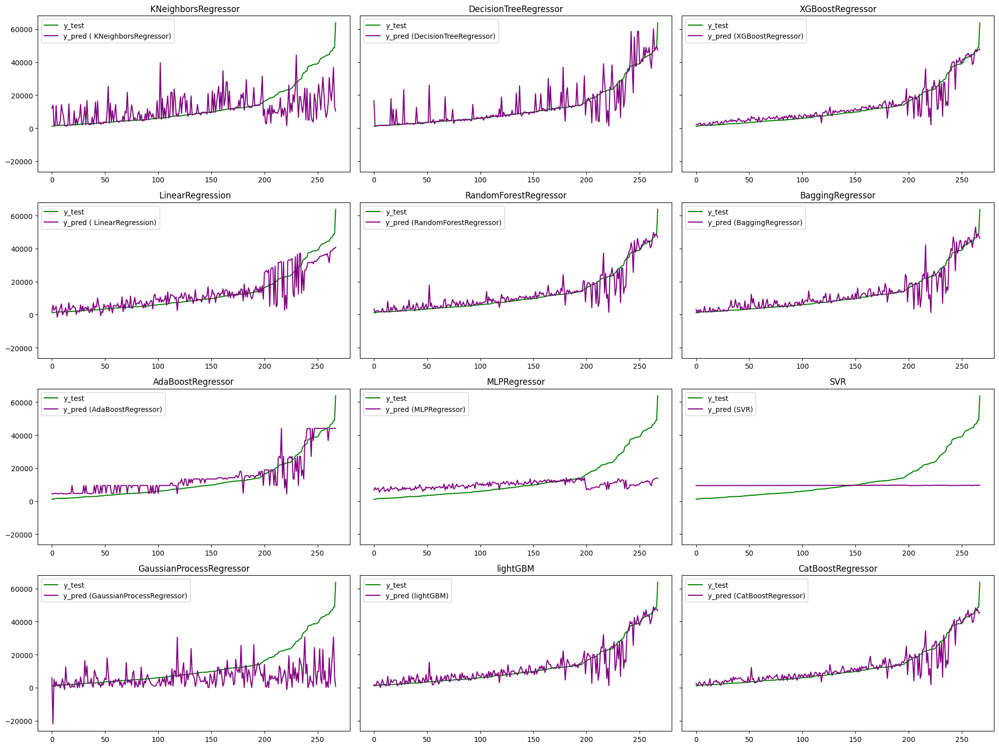

In [ ]:
# สร้างลิสต์เพื่อเก็บผลลัพธ์ของทุกโมเดล
model_predicts = []

# วนลูปทุกโมเดลใน algo
for model, model_name in model_re:
    # สร้างลิสต์เพื่อเก็บผลลัพธ์ของแต่ละโมเดล
    model_predict = []

    # ทำการฝึกสอนและทำนายบนข้อมูลทดสอบ
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # เก็บผลลัพธ์ลงในลิสต์ model_predict
    model_predict.append([y_pred, model_name])

    # เก็บลิสต์ model_predict ลงในลิสต์ model_predicts
    model_predicts.append(model_predict)

# พล็อตกราฟเส้นสำหรับทุกโมเดล
# สร้าง subplot พล็อตกราฟเส้นสำหรับทุกโมเดล
fig, axes = plt.subplots(4,3, figsize=(20, 15), sharey=True)

y_test = np.array(y_test)

for i, model_predict in enumerate(model_predicts):
    y_pred, model_name = model_predict[0]

    d = {'y_pred': y_pred, 'y_test': y_test}
    fg = pd.DataFrame(data=d)
    fg = fg.sort_values('y_test').reset_index().drop(columns='index')
    #fg.to_csv(f'/content/gdrive/MyDrive/Colab Notebooks/Data_Tool/Regression/Pred/{model_name}_Original.csv', index=False, header=True)

    # ทำกราฟเส้นบน subplot แต่ละตำแหน่ง
    axes.flatten()[i].plot(range(len(fg.y_test)), fg.y_test, label='y_test', color='green')
    axes.flatten()[i].plot(range(len(fg.y_pred)), fg.y_pred, label=f'y_pred ({model_name})', color='purple')
    axes.flatten()[i].set_title(f'{model_name.split("(")[0]}')
    axes.flatten()[i].legend()

# ปรับแต่งรายละเอียดกราฟ
plt.tight_layout()
plt.show()

### **Cross Validation**

In [ ]:
model_scores = []
# วนลูปใน model_re(modelต่างๆ) ที่สร้างเอาไว้
for model, name in model_re:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    # คำนวณ MSE จาก MAE
    MSE_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_mean_squared_error').mean()
    MAE_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_mean_absolute_error').mean()

    # คำนวณ RMSE จาก Rsquare
    RMSE_scores = np.sqrt(-MSE_scores)
    Rsquare_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2').mean()

    # เพิ่มค่าที่วัดประสิทธิภาพทั้งหมดลงในตัวแปร model_scores
    model_scores.append([MSE_scores, MAE_scores, RMSE_scores, Rsquare_scores, name])

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Streaming output truncated to the last 5000 lines.
4:	learn: 10460.1407577	total: 5.07ms	remaining: 1.01s
5:	learn: 10167.2595803	total: 6.01ms	remaining: 997ms
6:	learn: 9904.7230091	total: 6.92ms	remaining: 981ms
7:	learn: 9650.7774827	total: 7.9ms	remaining: 980ms
8:	learn: 9399.3325985	total: 8.77ms	remaining: 966ms
9:	learn: 9181.8883926	total: 9.92ms	remaining: 982ms
10:	learn: 8959.3122828	total: 10.4ms	remaining: 939ms
11:	learn: 8736.8765537	total: 11.4ms	remaining: 936ms
12:	learn: 8557.1435412	total: 12.2ms	remaining: 929ms
13:	learn: 8351.3041166	total: 12.7ms	remaining: 894ms
14:	learn: 8168.6742514	total: 13.5ms	remaining: 885ms
15:	learn: 7983.9513076	total: 14.4ms	remaining: 883ms
16:	learn: 7792.3364447	total: 15.3ms	remaining: 884ms
17:	learn: 7616.0452580	total: 17.1ms	remaining: 931ms
18:	learn: 7437.7642262	total: 18ms	remaining: 930ms
19:	learn: 7278.5757713	total: 19ms	remaining: 932ms
20:	learn: 7131.8412184	total: 19.9ms	remaining: 929ms
21:	learn: 6984.4702030

In [ ]:
dscore_class = pd.DataFrame(model_scores, columns = ['MSE_scores','MAE_scores','RMSE_scores','Rsquare_scores', 'regression'])
dscore_class.sort_values(by='Rsquare_scores', ascending=False)

,MSE_scores,MAE_scores,RMSE_scores,Rsquare_scores,regression
2,-2.237779e+07,-2663.274568,4730.516972,0.841795,XGBoostRegressor
4,-2.492411e+07,-2772.355925,4992.404817,0.825698,RandomForestRegressor
11,-2.509642e+07,-2882.982583,5009.632489,0.822172,CatBoostRegressor
10,-2.535372e+07,-2971.164475,5035.247399,0.820200,lightGBM
6,-2.829282e+07,-4148.092292,5319.099806,0.816404,AdaBoostRegressor
5,-2.650951e+07,-2900.938719,5148.739103,0.809240,BaggingRegressor
3,-3.782829e+07,-4238.987203,6150.470584,0.733914,LinearRegression
1,-4.232476e+07,-3051.684745,6505.748277,0.694410,DecisionTreeRegressor
0,-1.442490e+08,-7908.735183,12010.369160,-0.004965,KNeighborsRegressor
8,-1.587136e+08,-8261.862282,12598.157485,-0.101450,SVR


## **Cut Outlier By Boxplot**

In [ ]:
#ทำการคัดลอก df มาใส่ในตัวแปร df_cutout เพื่อที่จะตัด outlier
df_cutout = df.copy()

In [ ]:
#แปลงข้อมูลเป็น Z-score
from scipy.stats import zscore
df_cutout['z'] = df_cutout[["charges"]].apply(zscore) #สร้าง column ใหม่ที่ชือว่า z โดยใช้ method ที่ชื่อว่า apply กับ column charges
df_cutout

,age,sex,bmi,children,smoker,region,charges,z
0,19,2,27.900,0,1,2,16884.92400,0.298584
1,18,1,33.770,1,0,1,1725.55230,-0.953689
2,28,1,33.000,3,0,1,4449.46200,-0.728675
3,33,1,22.705,0,0,3,21984.47061,0.719843
4,32,1,28.880,0,0,3,3866.85520,-0.776802
...,...,...,...,...,...,...,...,...
1333,50,1,30.970,3,0,3,10600.54830,-0.220551
1334,18,2,31.920,0,0,4,2205.98080,-0.914002
1335,18,2,36.850,0,0,1,1629.83350,-0.961596
1336,21,2,25.800,0,0,2,2007.94500,-0.930362


{'whiskers': [<matplotlib.lines.Line2D at 0x7fbd952ea920>,
 'caps': [<matplotlib.lines.Line2D at 0x7fbd952eae60>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fbd952ea6b0>],
 'medians': [<matplotlib.lines.Line2D at 0x7fbd952eb3a0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7fbd952eb640>],
 'means': []}

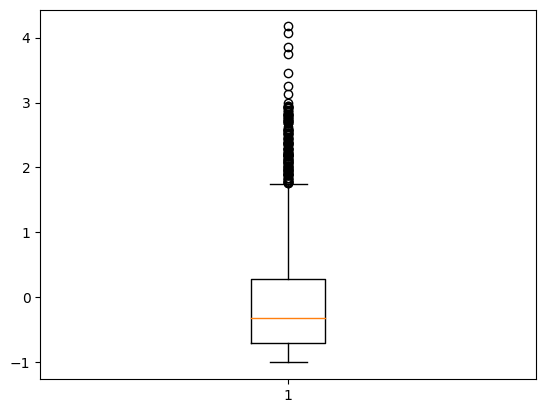

In [ ]:
plt.boxplot(df_cutout['z'])

{'whiskers': [<matplotlib.lines.Line2D at 0x7fbd95378100>,
 'caps': [<matplotlib.lines.Line2D at 0x7fbd95378640>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fbd9534be20>],
 'medians': [<matplotlib.lines.Line2D at 0x7fbd95378b80>],
 'fliers': [],
 'means': []}

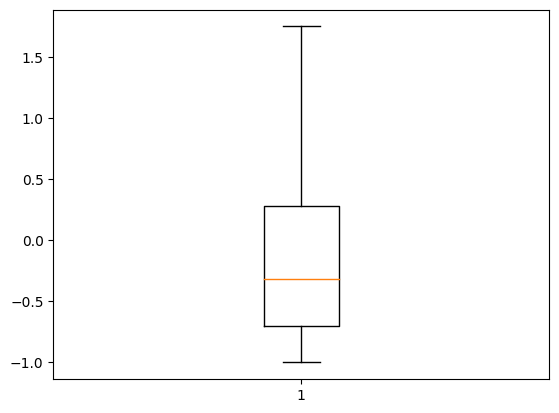

In [ ]:
#สร้าง Boxplot ที่ซ่อน Outliers
plt.boxplot(df_cutout['z'],showfliers = False)

In [ ]:
#ตัดข้อมูลที่เป็น Outlier ออกจากตาราง
balance = df_cutout[df_cutout['z']<0.75]
cutoutlier = balance[balance['z'] >= -1]
cutoutlier

,age,sex,bmi,children,smoker,region,charges,z
0,19,2,27.900,0,1,2,16884.92400,0.298584
1,18,1,33.770,1,0,1,1725.55230,-0.953689
2,28,1,33.000,3,0,1,4449.46200,-0.728675
3,33,1,22.705,0,0,3,21984.47061,0.719843
4,32,1,28.880,0,0,3,3866.85520,-0.776802
...,...,...,...,...,...,...,...,...
1332,52,2,44.700,3,0,2,11411.68500,-0.153545
1333,50,1,30.970,3,0,3,10600.54830,-0.220551
1334,18,2,31.920,0,0,4,2205.98080,-0.914002
1335,18,2,36.850,0,0,1,1629.83350,-0.961596


In [ ]:
y1 = cutoutlier["charges"]
X1 = cutoutlier.iloc[:,:6].copy()

X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

model_scores1 = []
#สร้าง for loop มา fit model และหา y_pred ตามวิธีที่กำหนดไว้ใน algo และวัดประสิทธิภาพโดยเก็บไว้ใน model_scores
#โดยวัดประสิทธิภาพ 4 ตัวนั้นคือMSE, MAE, RMSE, R_Squared
for model, name in model_re:
    model.fit(X1_train, y1_train)
    y_pred1 = model.predict(X1_test)

    MSE = mean_squared_error(y1_test, y_pred1)
    MAE = mean_absolute_error(y1_test, y_pred1)
    RMSE = np.sqrt(MSE)
    R_Squared = r2_score(y1_test, y_pred1)

    model_scores1.append([MSE, MAE, RMSE, R_Squared, name])

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000140 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 318
[LightGBM] [Info] Number of data points in the train set: 874, number of used features: 6
[LightGBM] [Info] Start training from score 8497.141842
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Learning rate set to 0.040081
0:	learn: 5084.8883330	total: 871us	remaining: 871ms
1:	learn: 4961.2200258	total: 1.86ms	remaining: 930ms
2:	learn: 4846.1137965	total: 4.47ms	remaining: 1.49s
3:	learn: 4730.6615061	total: 4.86ms	remaining: 1.21s
4:	learn: 4638.1961897	total: 6.17ms	remaining: 1.23s
5:	learn: 4542.7721657	total: 7.17ms	remaining: 1.19s
6:	learn: 4439.9087620	total: 8.62ms	remaining: 1.22s
7:	learn: 4348.0736908	total: 10.4ms	remaining: 1.29s
8:	learn: 4266.5574997	total: 12.2ms	remaining: 1.34s
9:	learn: 4178.5063919	total: 13.1ms	remaining: 1.29s
10:	learn: 4098

### **Perfomance**

In [ ]:
dscore_class = pd.DataFrame(model_scores1, columns = ['MSE','MAE','RMSE','R-squared', 'regression'])
dscore_class.sort_values(by='R-squared', ascending=False) #เรียงลำดับโดยค่าR-squaredจากมากไปน้อย

,MSE,MAE,RMSE,R-squared,regression
3,8.966584e+06,1403.111887,2994.425529,0.663684,LinearRegression
2,9.201894e+06,1279.671031,3033.462305,0.654858,XGBoostRegressor
10,9.681568e+06,1384.234780,3111.521840,0.636866,lightGBM
4,9.797946e+06,1393.529527,3130.167019,0.632501,RandomForestRegressor
5,9.822999e+06,1370.415242,3134.166386,0.631561,BaggingRegressor
11,1.017266e+07,1358.192023,3189.460465,0.618446,CatBoostRegressor
6,1.055582e+07,2212.643709,3248.971573,0.604075,AdaBoostRegressor
0,1.894179e+07,2289.139868,4352.216766,0.289536,KNeighborsRegressor
1,1.986512e+07,1794.548111,4457.030000,0.254904,DecisionTreeRegressor
7,2.297576e+07,3281.162316,4793.303590,0.138231,MLPRegressor


### **Compairision Y_test & Y_predict**

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 318
[LightGBM] [Info] Number of data points in the train set: 874, number of used features: 6
[LightGBM] [Info] Start training from score 8497.141842
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Learning rate set to 0.040081
0:	learn: 5084.8883330	total: 700us	remaining: 700ms
1:	learn: 4961.2200258	total: 1.25ms	remaining: 625ms
2:	learn: 4846.1137965	total: 2ms	remaining: 665ms
3:	learn: 4730.6615061	total: 2.4ms	remaining: 596ms
4:	learn: 4638.1961897	total: 3.12ms	remaining: 621ms
5:	learn: 4542.7721657	total: 4.56ms	remaining: 755ms
6:	learn: 4439.9087620	total: 6.11ms	remaining: 867ms
7:	learn: 4348.0736908	total: 7.23ms	remaining: 897ms
8:	learn: 4266.5574997	total: 8.12ms	remaining: 894ms
9:	learn: 4178.5063919	total: 8.96ms	remaining: 887ms
10:	learn: 4098.996

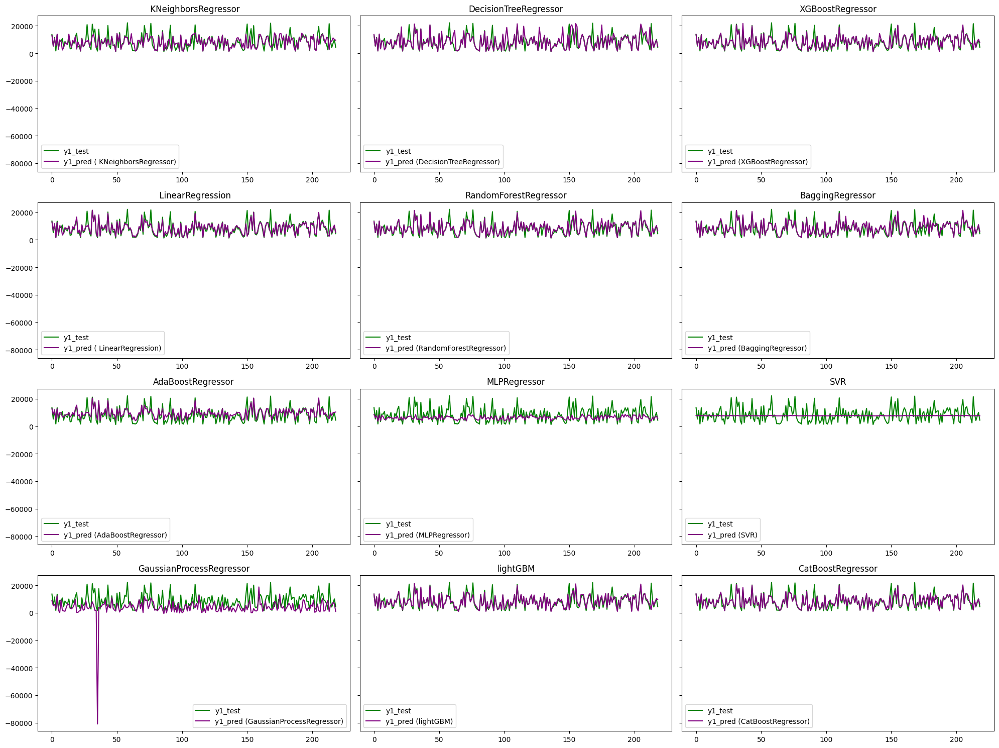

In [ ]:
# สร้างลิสต์เพื่อเก็บผลลัพธ์ของทุกโมเดล
model_predicts1 = []

# วนลูปทุกโมเดลใน algo
for model1, model_name in model_re:
    # สร้างลิสต์เพื่อเก็บผลลัพธ์ของแต่ละโมเดล
    model_predict1= []

    # ทำการฝึกสอนและทำนายบนข้อมูลทดสอบ
    model1.fit(X1_train, y1_train)
    y1_pred = model1.predict(X1_test)

    # เก็บผลลัพธ์ลงในลิสต์ model_predict
    model_predict1.append([y1_pred, model_name])

    # เก็บลิสต์ model_predict ลงในลิสต์ model_predicts
    model_predicts1.append(model_predict1)

# พล็อตกราฟเส้นสำหรับทุกโมเดล
# สร้าง subplot พล็อตกราฟเส้นสำหรับทุกโมเดล
fig, axes = plt.subplots(4,3, figsize=(20, 15), sharey=True)
for i, model_predict1 in enumerate(model_predicts1):
    y1_pred, model_name = model_predict1[0]

    # ทำกราฟเส้นบน subplot แต่ละตำแหน่ง
    axes.flatten()[i].plot(range(len(y1_test)), y1_test, label='y1_test', color='green')
    axes.flatten()[i].plot(range(len(y1_pred)), y1_pred, label=f'y1_pred ({model_name})', color='purple')
    axes.flatten()[i].set_title(f'{model_name.split("(")[0]}')
    axes.flatten()[i].legend()

# ปรับแต่งรายละเอียดกราฟ
plt.tight_layout()
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000150 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 318
[LightGBM] [Info] Number of data points in the train set: 874, number of used features: 6
[LightGBM] [Info] Start training from score 8497.141842
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Learning rate set to 0.040081
0:	learn: 5084.8883330	total: 2.35ms	remaining: 2.35s
1:	learn: 4961.2200258	total: 3.43ms	remaining: 1.71s
2:	learn: 4846.1137965	total: 4.33ms	remaining: 1.44s
3:	learn: 4730.6615061	total: 4.78ms	remaining: 1.19s
4:	learn: 4638.1961897	total: 5.62ms	remaining: 1.12s
5:	learn: 4542.7721657	total: 6.47ms	remaining: 1.07s
6:	learn: 4439.9087620	total: 7.53ms	remaining: 1.07s
7:	learn: 4348.0736908	total: 8.77ms	remaining: 1.09s
8:	learn: 4266.5574997	total: 10.4ms	remaining: 1.15s
9:	learn: 4178.5063919	total: 12.8ms	remaining: 1.27s
10:	learn: 409

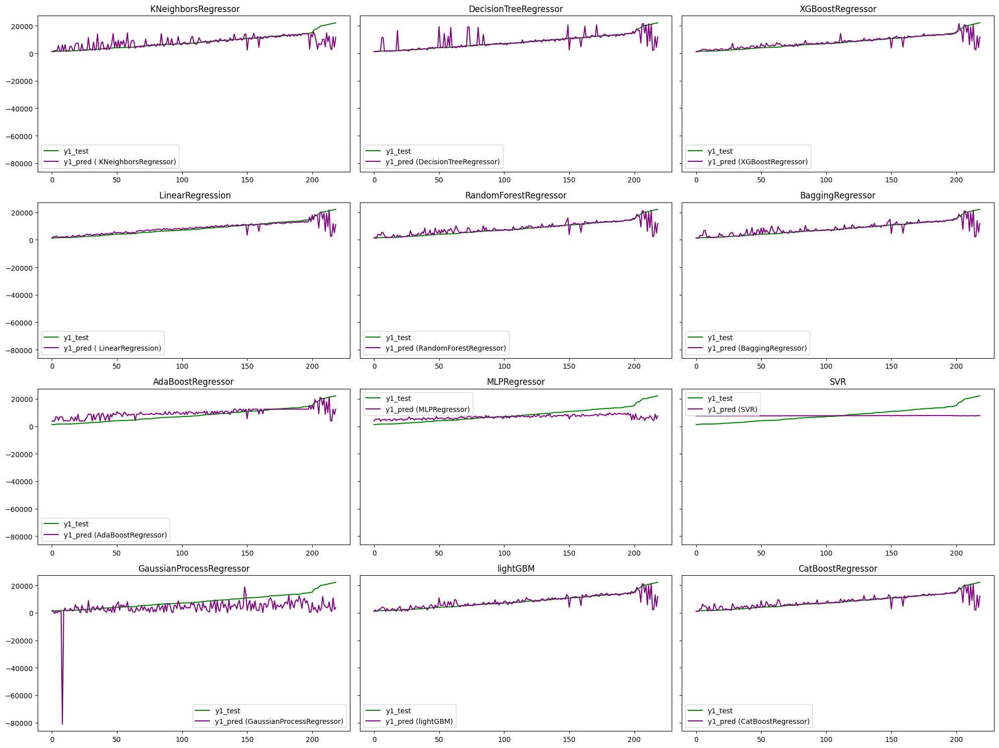

,MSE_scores,MAE_scores,RMSE_scores,Rsquare_scores,regression
0,-1.893093e+07,-2445.436859,4350.968795,0.302899,KNeighborsRegressor
1,-1.452283e+07,-1573.672357,3810.882707,0.470065,DecisionTreeRegressor
2,-7.213310e+06,-1254.655868,2685.760538,0.734348,XGBoostRegressor
3,-6.951467e+06,-1341.411037,2636.563417,0.743369,LinearRegression
4,-7.848435e+06,-1290.732063,2801.505926,0.707698,RandomForestRegressor
5,-9.099177e+06,-1360.540533,3016.484244,0.706810,BaggingRegressor
6,-1.239888e+07,-2407.608487,3521.204921,0.591320,AdaBoostRegressor
7,-3.758896e+07,-4263.283178,6130.983744,-0.332643,MLPRegressor
8,-2.761727e+07,-4237.309725,5255.213672,-0.024918,SVR
9,-5.415005e+07,-5260.966231,7358.672077,-1.018837,GaussianProcessRegressor


In [ ]:
# สร้างลิสต์เพื่อเก็บผลลัพธ์ของทุกโมเดล
model_predicts1 = []

# วนลูปทุกโมเดลใน algo
for model1, model_name in model_re:
    # สร้างลิสต์เพื่อเก็บผลลัพธ์ของแต่ละโมเดล
    model_predict1= []

    # ทำการฝึกสอนและทำนายบนข้อมูลทดสอบ
    model1.fit(X1_train, y1_train)
    y1_pred = model1.predict(X1_test)

    # เก็บผลลัพธ์ลงในลิสต์ model_predict
    model_predict1.append([y1_pred, model_name])

    # เก็บลิสต์ model_predict ลงในลิสต์ model_predicts
    model_predicts1.append(model_predict1)

# พล็อตกราฟเส้นสำหรับทุกโมเดล
# สร้าง subplot พล็อตกราฟเส้นสำหรับทุกโมเดล
fig, axes = plt.subplots(4,3, figsize=(20, 15), sharey=True)
for i, model_predict1 in enumerate(model_predicts1):
    y1_pred, model_name = model_predict1[0]

    d = {'y1_pred': y1_pred, 'y1_test': y1_test}
    fg = pd.DataFrame(data=d)
    fg = fg.sort_values('y1_test').reset_index().drop(columns='index')
    #fg.to_csv(f'/content/gdrive/MyDrive/Colab Notebooks/Data_Tool/Regression/{model_name}_Delete_Outliner.csv', index=False, header=True)

    # ทำกราฟเส้นบน subplot แต่ละตำแหน่ง
    axes.flatten()[i].plot(range(len(fg.y1_test)), fg.y1_test, label='y1_test', color='green')
    axes.flatten()[i].plot(range(len(fg.y1_pred)), fg.y1_pred, label=f'y1_pred ({model_name})', color='purple')
    axes.flatten()[i].set_title(f'{model_name.split("(")[0]}')
    axes.flatten()[i].legend()

# ปรับแต่งรายละเอียดกราฟ
plt.tight_layout()
plt.show()
dscore_class

### **Cross Validation**

In [ ]:
y1 = cutoutlier["charges"]
X1 = cutoutlier.iloc[:,:6].copy()

X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

In [ ]:
model_scores = []

for model, name in model_re:
    model.fit(X1_train, y1_train)
    y_pred = model.predict(X1_test)
    # คำนวณ MSE จาก MAE
    MSE_scores = cross_val_score(model, X1_train, y1_train, cv=5, scoring='neg_mean_squared_error').mean()
    MAE_scores = cross_val_score(model, X1_train, y1_train, cv=5, scoring='neg_mean_absolute_error').mean()

    # คำนวณ RMSE จาก MSE
    RMSE_scores = np.sqrt(-MSE_scores)
    Rsquare_scores = cross_val_score(model, X1_train, y1_train, cv=5, scoring='r2').mean()

    # เพิ่มค่าที่วัดประสิทธิภาพทั้งหมดลงในตัวแปร model_scores
    model_scores.append([MSE_scores, MAE_scores, RMSE_scores, Rsquare_scores, name])

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

Streaming output truncated to the last 5000 lines.
4:	learn: 4560.1473356	total: 4.67ms	remaining: 929ms
5:	learn: 4471.4157023	total: 5.97ms	remaining: 990ms
6:	learn: 4372.7376581	total: 7.37ms	remaining: 1.04s
7:	learn: 4281.5841289	total: 8.23ms	remaining: 1.02s
8:	learn: 4200.9333741	total: 9.29ms	remaining: 1.02s
9:	learn: 4119.0658381	total: 10.5ms	remaining: 1.04s
10:	learn: 4038.3404494	total: 11.7ms	remaining: 1.05s
11:	learn: 3956.7061500	total: 12.5ms	remaining: 1.03s
12:	learn: 3886.6061602	total: 13ms	remaining: 990ms
13:	learn: 3813.3594750	total: 13.7ms	remaining: 965ms
14:	learn: 3745.7853677	total: 14.9ms	remaining: 976ms
15:	learn: 3685.4445244	total: 16.2ms	remaining: 996ms
16:	learn: 3628.3308582	total: 17ms	remaining: 984ms
17:	learn: 3578.6851139	total: 17.9ms	remaining: 975ms
18:	learn: 3522.9972820	total: 18.8ms	remaining: 968ms
19:	learn: 3471.1924238	total: 19.5ms	remaining: 957ms
20:	learn: 3423.2767512	total: 20.4ms	remaining: 951ms
21:	learn: 3377.4604472	

In [ ]:
dscore_class = pd.DataFrame(model_scores, columns = ['MSE_scores','MAE_scores','RMSE_scores','Rsquare_scores', 'regression'])
dscore_class.sort_values(by='Rsquare_scores', ascending=False)

,MSE_scores,MAE_scores,RMSE_scores,Rsquare_scores,regression
3,-6.951467e+06,-1341.411037,2636.563417,0.743369,LinearRegression
2,-7.213310e+06,-1254.655868,2685.760538,0.734348,XGBoostRegressor
10,-7.875591e+06,-1406.696311,2806.348260,0.708703,lightGBM
4,-7.848435e+06,-1290.732063,2801.505926,0.707698,RandomForestRegressor
5,-9.099177e+06,-1360.540533,3016.484244,0.706810,BaggingRegressor
11,-8.217724e+06,-1318.602291,2866.657359,0.695928,CatBoostRegressor
6,-1.239888e+07,-2407.608487,3521.204921,0.591320,AdaBoostRegressor
1,-1.452283e+07,-1573.672357,3810.882707,0.470065,DecisionTreeRegressor
0,-1.893093e+07,-2445.436859,4350.968795,0.302899,KNeighborsRegressor
8,-2.761727e+07,-4237.309725,5255.213672,-0.024918,SVR


# **Classification Model**

In [ ]:
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

In [ ]:
#เก็บ model ที่จะใช้ไว้ในตัวแปร model_class
model_class = [
   [KNeighborsClassifier(n_neighbors = 3), 'KNeighborsClassifier'],
   [GaussianNB(), 'naive_bayes'],
   [DecisionTreeClassifier(), 'DecisionTreeClassifier'],
   [GradientBoostingClassifier(), 'XGBoostClassifier'],
   [RandomForestClassifier(), 'RandomForestClassifier'],
   [BaggingClassifier(), 'BaggingClassifier'],
   [ExtraTreesClassifier(), 'ExtraTreesClassifier'],
   [MLPClassifier(), 'MLPClassifier'],
   [SVC(), 'SVC'],
   [GradientBoostingClassifier(), 'GaussianProcessClassifier'],
   [LGBMClassifier(), 'lightGBMClassifier'],
   [CatBoostClassifier(), 'CatBoostClassifier']
]

## **1000 per range**


### **Original**

#### **Convert Data**

In [ ]:
#แบ่งข้อมูลเป็นช่วงละ 1000 แล้วเก็บไว้ในตัวแปร Class
df['Class'] = pd.cut(df['charges'], bins=range(0, int(df['charges'].max()) + 1001, 1000), labels=False)

In [ ]:
#สร้างตัวแปร X และ y
X = df.iloc[:,:6]
y = df['Class']

#แบ่งข้อมูลสำหรับ Train และ Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X_train, y_train)

    #Predict Model
    y_pred = model.predict(X_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    accuracy = accuracy_score(y_test, y_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.0794
0:	learn: 3.8639446	total: 29.6ms	remaining: 29.5s
1:	learn: 3.7397573	total: 54.2ms	remaining: 27.1s
2:	learn: 3.6458567	total: 79.3ms	remaining: 26.3s
3:	learn: 3.4756345	total: 104ms	remaining: 26s
4:	learn: 3.2762031	total: 129ms	remaining: 25.6s
5:	learn: 3.1932630	total: 156ms	remaining: 25.9s
6:	learn: 3.0686935	total: 187ms	remaining: 26.6s
7:	learn: 3.0092311	total: 232ms	remaining: 28.8s
8:	learn: 2.9030952	total: 257ms	remaining: 28.3s
9:	learn: 2.8204160	total: 265ms	remaining: 26.2s
10:	learn: 2.7632587	total: 288ms	remaining: 25.9s
11:	learn: 2.6971751	total: 312ms	remaining: 25.7s
12:	learn: 2.6249564	total: 336ms	remaining: 25.5s
13:	learn: 2.5727129	total: 361ms	remaining: 25.4s
14:	learn: 2.5335104	total: 387ms	remaining: 25.4s
15:	learn: 2.4933956	total: 411ms	remaining: 25.3s
16:	learn: 2.4523897	total: 444ms	remaining: 25.7s
17:	learn: 2.4073244	total: 469ms	remaining: 25.6s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_1000.csv', index = False, header = True)

####**Barchart**

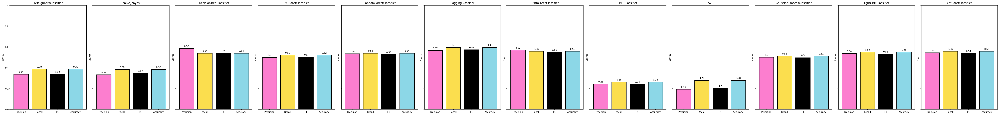

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

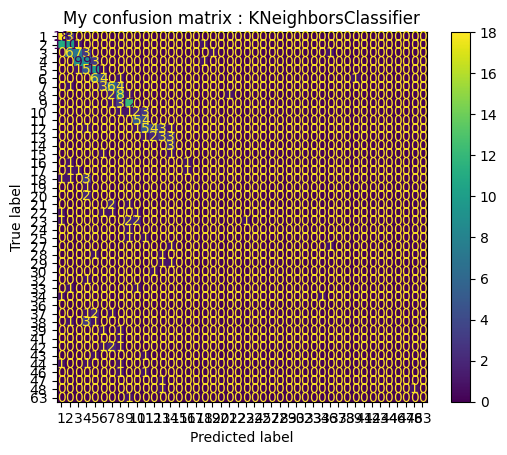

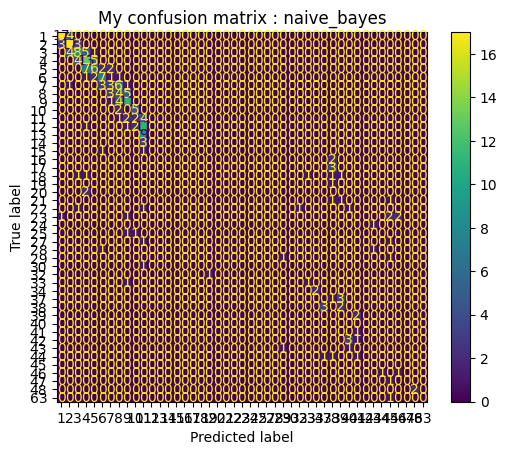

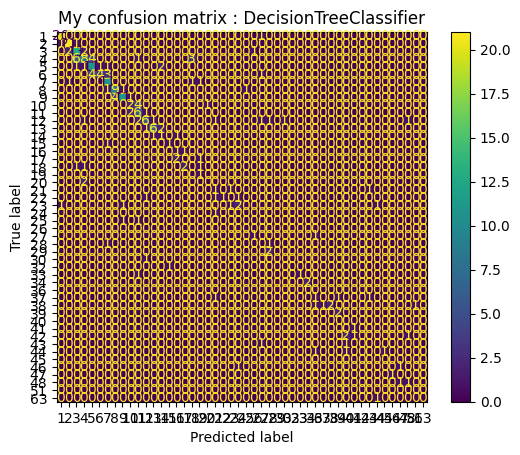

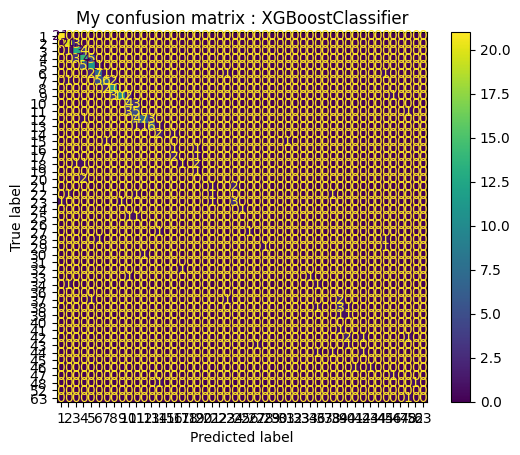

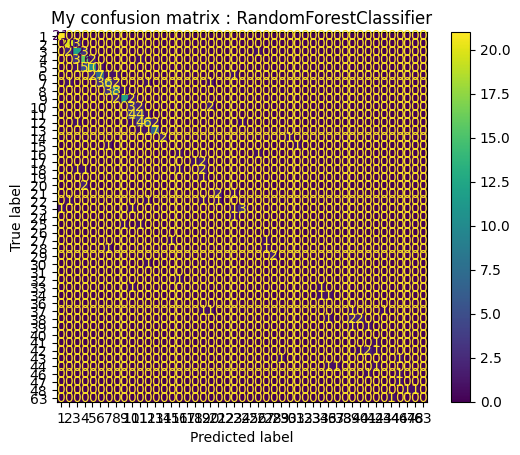

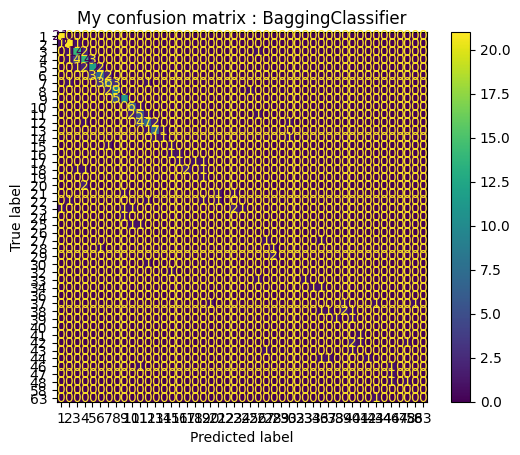

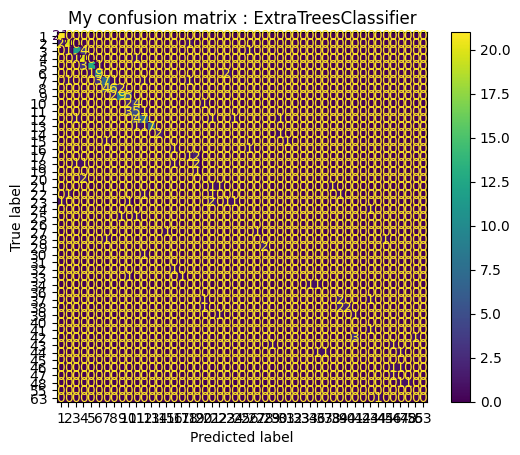

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


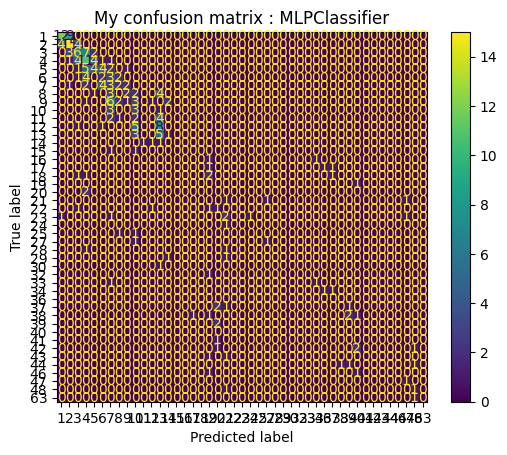

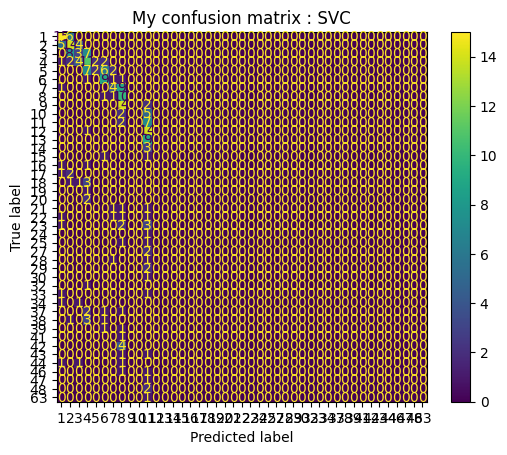

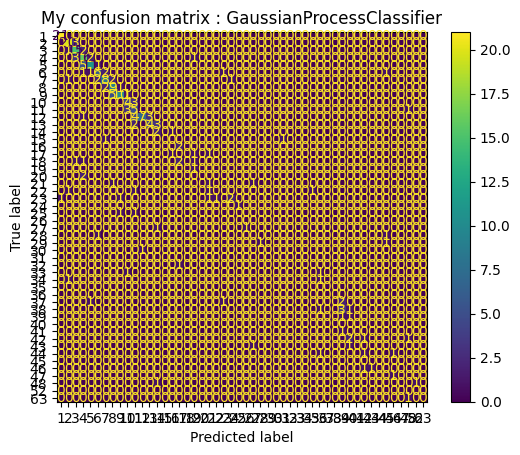

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[LightGBM] [Info] Start training from score -3.391895
[LightGBM] [

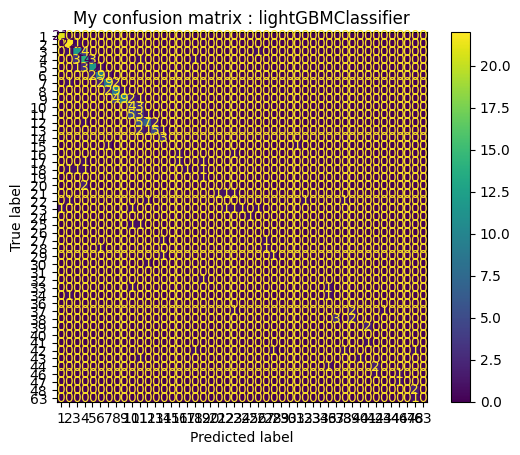

Learning rate set to 0.0794
0:	learn: 3.8639446	total: 36.5ms	remaining: 36.5s
1:	learn: 3.7397573	total: 61.1ms	remaining: 30.5s
2:	learn: 3.6458567	total: 87ms	remaining: 28.9s
3:	learn: 3.4756345	total: 111ms	remaining: 27.5s
4:	learn: 3.2762031	total: 137ms	remaining: 27.2s
5:	learn: 3.1932630	total: 160ms	remaining: 26.5s
6:	learn: 3.0686935	total: 184ms	remaining: 26.1s
7:	learn: 3.0092311	total: 221ms	remaining: 27.4s
8:	learn: 2.9030952	total: 244ms	remaining: 26.9s
9:	learn: 2.8204160	total: 253ms	remaining: 25s
10:	learn: 2.7632587	total: 276ms	remaining: 24.8s
11:	learn: 2.6971751	total: 300ms	remaining: 24.7s
12:	learn: 2.6249564	total: 325ms	remaining: 24.7s
13:	learn: 2.5727129	total: 348ms	remaining: 24.5s
14:	learn: 2.5335104	total: 372ms	remaining: 24.4s
15:	learn: 2.4933956	total: 410ms	remaining: 25.2s
16:	learn: 2.4523897	total: 445ms	remaining: 25.7s
17:	learn: 2.4073244	total: 472ms	remaining: 25.8s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2.3

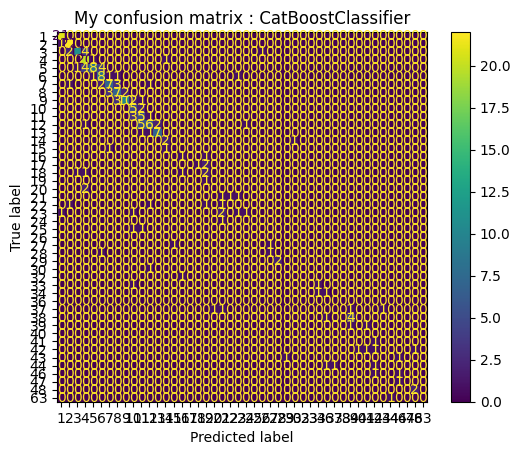

In [ ]:
for model,model_name in model_class:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_test = np.array(y_test)

    #หาค่า unique labels จากการรวม y_test และ y_pred
    unique_labels = np.unique(np.concatenate((y_test, y_pred), axis=None))
    labels = [str(label) for label in unique_labels]

    #คำนวณค่า Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot()

    #ใส่ชื่อตามชื่อของโมเดล
    plt.title("My confusion matrix : "+model_name)

    #แสดงผลกราฟ Confusion Matrix
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X_train, y_train)

  #Predict Model
  y_pred = model.predict(X_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000133 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000035 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 38.1ms	remaining: 38s
1:	learn: 3.7699887	total: 66.2ms	remaining: 33s
2:	learn: 3.6374395	total: 93ms	remaining: 30.9s
3:	learn: 3.4525588	total: 99.9ms	remaining: 24.9s
4:	learn: 3.3043578	total: 122ms	remaining: 24.3s
5:	learn: 3.1974232	total: 132ms	remaining: 21.8s
6:	learn: 3.1168060	total: 154ms	remaining: 21.8s
7:	learn: 3.0316053	total: 178ms	remaining: 22.1s
8:	learn: 2.9164232	total: 215ms	remaining: 23.7s
9:	learn: 2.8308825	total: 251ms	remaining: 24.9s
10:	learn: 2.7641192	total: 291ms	remaining: 26.2s
11:	learn: 2.7040077	total: 321ms	remaining: 26.4s
12:	learn: 2.6391498	total: 343ms	remaining: 26.1s
13:	learn: 2.5783828	total: 366ms	remaining: 25.8s
14:	learn: 2.5194223	total: 388ms	remaining: 25.5s
15:	learn: 2.4762742	total: 411ms	remaining: 25.3s
16:	learn: 2.4362766	total: 450ms	remaining: 26s
17:	learn: 2.4019272	total: 496ms	remaining: 27.1s
18:	learn: 2.3726398	total: 537ms	remaining: 27.7s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 22.6ms	remaining: 22.6s
1:	learn: 3.6812507	total: 44.4ms	remaining: 22.2s
2:	learn: 3.5943361	total: 66ms	remaining: 21.9s
3:	learn: 3.4173746	total: 74ms	remaining: 18.4s
4:	learn: 3.2722143	total: 98.3ms	remaining: 19.6s
5:	learn: 3.1947988	total: 120ms	remaining: 19.9s
6:	learn: 3.1147909	total: 142ms	remaining: 20.1s
7:	learn: 3.0563794	total: 164ms	remaining: 20.3s
8:	learn: 2.9807241	total: 186ms	remaining: 20.5s
9:	learn: 2.8957365	total: 226ms	remaining: 22.4s
10:	learn: 2.8284835	total: 263ms	remaining: 23.7s
11:	learn: 2.7719337	total: 301ms	remaining: 24.8s
12:	learn: 2.7037490	total: 340ms	remaining: 25.8s
13:	learn: 2.6334962	total: 368ms	remaining: 25.9s
14:	learn: 2.5791356	total: 394ms	remaining: 25.9s
15:	learn: 2.5369880	total: 416ms	remaining: 25.6s
16:	learn: 2.4966701	total: 451ms	remaining: 26.1s
17:	learn: 2.4538217	total: 490ms	remaining: 26.7s
18:	learn: 2.4011134	total: 515ms	remaining: 26.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 53.9ms	remaining: 26.9s
2:	learn: 3.6334421	total: 91.1ms	remaining: 30.3s
3:	learn: 3.4849033	total: 106ms	remaining: 26.3s
4:	learn: 3.3442909	total: 127ms	remaining: 25.3s
5:	learn: 3.2557597	total: 149ms	remaining: 24.7s
6:	learn: 3.1410990	total: 171ms	remaining: 24.2s
7:	learn: 3.0848395	total: 201ms	remaining: 24.9s
8:	learn: 3.0093885	total: 236ms	remaining: 26s
9:	learn: 2.9314518	total: 284ms	remaining: 28.1s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 361ms	remaining: 29.7s
12:	learn: 2.7327315	total: 383ms	remaining: 29s
13:	learn: 2.6843200	total: 405ms	remaining: 28.5s
14:	learn: 2.6309948	total: 427ms	remaining: 28s
15:	learn: 2.5896154	total: 450ms	remaining: 27.7s
16:	learn: 2.5443380	total: 472ms	remaining: 27.3s
17:	learn: 2.5020189	total: 502ms	remaining: 27.4s
18:	learn: 2.4589923	total: 542ms	remaining: 28s
19:	learn: 2.4106644	total: 571ms	remaining: 28s
20:	learn: 2.3709353	total: 593ms	remaining: 27.7s

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8064426	total: 32.5ms	remaining: 32.5s
1:	learn: 3.7095437	total: 65.5ms	remaining: 32.7s
2:	learn: 3.6234020	total: 92.3ms	remaining: 30.7s
3:	learn: 3.5219364	total: 115ms	remaining: 28.6s
4:	learn: 3.3261204	total: 137ms	remaining: 27.2s
5:	learn: 3.2046959	total: 158ms	remaining: 26.2s
6:	learn: 3.1324966	total: 182ms	remaining: 25.8s
7:	learn: 3.0746523	total: 226ms	remaining: 28.1s
8:	learn: 2.9722810	total: 266ms	remaining: 29.3s
9:	learn: 2.8863538	total: 282ms	remaining: 27.9s
10:	learn: 2.8240149	total: 319ms	remaining: 28.7s
11:	learn: 2.7591890	total: 341ms	remaining: 28.1s
12:	learn: 2.6853846	total: 373ms	remaining: 28.4s
13:	learn: 2.6191711	total: 396ms	remaining: 27.9s
14:	learn: 2.5691761	total: 419ms	remaining: 27.5s
15:	learn: 2.5250907	total: 456ms	remaining: 28.1s
16:	learn: 2.4830234	total: 487ms	remaining: 28.2s
17:	learn: 2.4407160	total: 513ms	remaining: 28s
18:	learn: 2.4025737	total: 535ms	remaining: 27.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3322320	total: 108ms	remaining: 21.6s
5:	learn: 3.2643425	total: 148ms	remaining: 24.6s
6:	learn: 3.1809232	total: 184ms	remaining: 26.2s
7:	learn: 3.1211707	total: 223ms	remaining: 27.7s
8:	learn: 3.0450874	total: 257ms	remaining: 28.3s
9:	learn: 2.9612655	total: 279ms	remaining: 27.6s
10:	learn: 2.8920670	total: 300ms	remaining: 27s
11:	learn: 2.8145660	total: 330ms	remaining: 27.2s
12:	learn: 2.7392359	total: 369ms	remaining: 28s
13:	learn: 2.6846049	total: 394ms	remaining: 27.8s
14:	learn: 2.6274903	total: 416ms	remaining: 27.3s
15:	learn: 2.5862957	total: 438ms	remaining: 26.9s
16:	learn: 2.5426484	total: 459ms	remaining: 26.5s
17:	learn: 2.4982743	total: 480ms	remaining: 26.2s
18:	learn: 2.4573390	total: 502ms	remaining: 25.9s
19:	learn: 2.4102792	total: 523ms	remaining: 25.6s
20:	learn: 2.3700533	total: 566ms	remaining: 26.4s
21:	learn: 2.3452094	total: 603ms	remaining: 26.8s
22:	learn: 2.3196629	total: 633ms	remaining: 26.9s
23:	learn: 2.2819446	total: 654ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.7ms	remaining: 22.6s
1:	learn: 3.7484080	total: 45.1ms	remaining: 22.5s
2:	learn: 3.6594905	total: 67.4ms	remaining: 22.4s
3:	learn: 3.4810880	total: 78.4ms	remaining: 19.5s
4:	learn: 3.3331988	total: 111ms	remaining: 22.1s
5:	learn: 3.2592621	total: 133ms	remaining: 22.1s
6:	learn: 3.1544492	total: 156ms	remaining: 22.1s
7:	learn: 3.0923563	total: 178ms	remaining: 22.1s
8:	learn: 3.0187806	total: 217ms	remaining: 23.9s
9:	learn: 2.9371069	total: 256ms	remaining: 25.3s
10:	learn: 2.8695088	total: 293ms	remaining: 26.3s
11:	learn: 2.8133799	total: 330ms	remaining: 27.1s
12:	learn: 2.7372023	total: 359ms	remaining: 27.3s
13:	learn: 2.6678466	total: 381ms	remaining: 26.8s
14:	learn: 2.6137397	total: 403ms	remaining: 26.5s
15:	learn: 2.5615789	total: 432ms	remaining: 26.6s
16:	learn: 2.5207092	total: 471ms	remaining: 27.2s
17:	learn: 2.4795757	total: 502ms	remaining: 27.4s
18:	learn: 2.4402746	total: 525ms	remaining: 27.1s
19:	lea

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3411053	total: 106ms	remaining: 21.1s
5:	learn: 3.2449077	total: 141ms	remaining: 23.4s
6:	learn: 3.1621918	total: 173ms	remaining: 24.5s
7:	learn: 3.1034455	total: 200ms	remaining: 24.8s
8:	learn: 2.9965094	total: 234ms	remaining: 25.7s
9:	learn: 2.9180163	total: 265ms	remaining: 26.3s
10:	learn: 2.8470785	total: 287ms	remaining: 25.8s
11:	learn: 2.7752889	total: 312ms	remaining: 25.7s
12:	learn: 2.7037633	total: 343ms	remaining: 26.1s
13:	learn: 2.6674419	total: 379ms	remaining: 26.7s
14:	learn: 2.6170536	total: 402ms	remaining: 26.4s
15:	learn: 2.5754001	total: 423ms	remaining: 26s
16:	learn: 2.5307902	total: 459ms	remaining: 26.5s
17:	learn: 2.4925670	total: 490ms	remaining: 26.8s
18:	learn: 2.4529037	total: 539ms	remaining: 27.8s
19:	learn: 2.4058253	total: 577ms	remaining: 28.3s
20:	learn: 2.3778239	total: 620ms	remaining: 28.9s
21:	learn: 2.3530449	total: 657ms	remaining: 29.2s
22:	learn: 2.3276181	total: 693ms	remaining: 29.4s
23:	learn: 2.2887251	total: 727ms	remai

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8381744	total: 34.7ms	remaining: 34.7s
1:	learn: 3.7004105	total: 69.9ms	remaining: 34.9s
2:	learn: 3.6104702	total: 104ms	remaining: 34.6s
3:	learn: 3.4342228	total: 111ms	remaining: 27.6s
4:	learn: 3.2911717	total: 132ms	remaining: 26.3s
5:	learn: 3.1853531	total: 141ms	remaining: 23.4s
6:	learn: 3.0793088	total: 163ms	remaining: 23.1s
7:	learn: 2.9817558	total: 185ms	remaining: 23s
8:	learn: 2.9069319	total: 228ms	remaining: 25.1s
9:	learn: 2.8229469	total: 266ms	remaining: 26.3s
10:	learn: 2.7578803	total: 302ms	remaining: 27.2s
11:	learn: 2.6971236	total: 339ms	remaining: 27.9s
12:	learn: 2.6305608	total: 361ms	remaining: 27.4s
13:	learn: 2.5662315	total: 397ms	remaining: 28s
14:	learn: 2.5042711	total: 427ms	remaining: 28.1s
15:	learn: 2.4615175	total: 462ms	remaining: 28.4s
16:	learn: 2.4086955	total: 501ms	remaining: 29s
17:	learn: 2.3754565	total: 563ms	remaining: 30.7s
18:	learn: 2.3465780	total: 611ms	remaining: 31.5s
19:	learn: 2.3213413	total: 653ms	remaining: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8480707	total: 47.8ms	remaining: 47.8s
1:	learn: 3.7115540	total: 106ms	remaining: 53s
2:	learn: 3.6234599	total: 160ms	remaining: 53.1s
3:	learn: 3.4455719	total: 175ms	remaining: 43.6s
4:	learn: 3.3004163	total: 219ms	remaining: 43.6s
5:	learn: 3.2153645	total: 266ms	remaining: 44.1s
6:	learn: 3.1139272	total: 311ms	remaining: 44s
7:	learn: 3.0567616	total: 354ms	remaining: 43.8s
8:	learn: 2.9830415	total: 397ms	remaining: 43.7s
9:	learn: 2.9030401	total: 441ms	remaining: 43.7s
10:	learn: 2.8363418	total: 487ms	remaining: 43.8s
11:	learn: 2.7784608	total: 529ms	remaining: 43.5s
12:	learn: 2.7119909	total: 574ms	remaining: 43.6s
13:	learn: 2.6411087	total: 628ms	remaining: 44.2s
14:	learn: 2.5881612	total: 675ms	remaining: 44.4s
15:	learn: 2.5343530	total: 725ms	remaining: 44.6s
16:	learn: 2.4885762	total: 772ms	remaining: 44.7s
17:	learn: 2.4427486	total: 812ms	remaining: 44.3s
18:	learn: 2.4027594	total: 863ms	remaining: 44.6s
19:	learn: 2.3559613	total: 914ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8682283	total: 41ms	remaining: 40.9s
1:	learn: 3.7300207	total: 78.6ms	remaining: 39.2s
2:	learn: 3.6436920	total: 117ms	remaining: 38.9s
3:	learn: 3.4961195	total: 133ms	remaining: 33.1s
4:	learn: 3.3991806	total: 182ms	remaining: 36.3s
5:	learn: 3.3201834	total: 239ms	remaining: 39.6s
6:	learn: 3.2351281	total: 294ms	remaining: 41.7s
7:	learn: 3.1767200	total: 357ms	remaining: 44.2s
8:	learn: 3.0617868	total: 400ms	remaining: 44.1s
9:	learn: 2.9782887	total: 445ms	remaining: 44.1s
10:	learn: 2.8993493	total: 497ms	remaining: 44.7s
11:	learn: 2.8252658	total: 545ms	remaining: 44.9s
12:	learn: 2.7444908	total: 588ms	remaining: 44.6s
13:	learn: 2.6702937	total: 621ms	remaining: 43.7s
14:	learn: 2.6138347	total: 673ms	remaining: 44.2s
15:	learn: 2.5591252	total: 722ms	remaining: 44.4s
16:	learn: 2.5154962	total: 775ms	remaining: 44.8s
17:	learn: 2.4740075	total: 821ms	remaining: 44.8s
18:	learn: 2.4343606	total: 862ms	remaining: 44.5s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 44.8ms	remaining: 44.8s
1:	learn: 3.7699887	total: 89.5ms	remaining: 44.7s
2:	learn: 3.6374395	total: 120ms	remaining: 40s
3:	learn: 3.4525588	total: 127ms	remaining: 31.7s
4:	learn: 3.3043578	total: 150ms	remaining: 29.8s
5:	learn: 3.1974232	total: 169ms	remaining: 27.9s
6:	learn: 3.1168060	total: 214ms	remaining: 30.4s
7:	learn: 3.0316053	total: 255ms	remaining: 31.6s
8:	learn: 2.9164232	total: 296ms	remaining: 32.6s
9:	learn: 2.8308825	total: 335ms	remaining: 33.1s
10:	learn: 2.7641192	total: 356ms	remaining: 32s
11:	learn: 2.7040077	total: 378ms	remaining: 31.2s
12:	learn: 2.6391498	total: 401ms	remaining: 30.5s
13:	learn: 2.5783828	total: 439ms	remaining: 30.9s
14:	learn: 2.5194223	total: 471ms	remaining: 30.9s
15:	learn: 2.4762742	total: 506ms	remaining: 31.1s
16:	learn: 2.4362766	total: 529ms	remaining: 30.6s
17:	learn: 2.4019272	total: 551ms	remaining: 30s
18:	learn: 2.3726398	total: 573ms	remaining: 29.6s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 35.3ms	remaining: 35.3s
1:	learn: 3.6812507	total: 58.8ms	remaining: 29.4s
2:	learn: 3.5943361	total: 81.6ms	remaining: 27.1s
3:	learn: 3.4173746	total: 91.5ms	remaining: 22.8s
4:	learn: 3.2722143	total: 113ms	remaining: 22.5s
5:	learn: 3.1947988	total: 145ms	remaining: 24.1s
6:	learn: 3.1147909	total: 167ms	remaining: 23.7s
7:	learn: 3.0563794	total: 205ms	remaining: 25.4s
8:	learn: 2.9807241	total: 243ms	remaining: 26.7s
9:	learn: 2.8957365	total: 279ms	remaining: 27.6s
10:	learn: 2.8284835	total: 312ms	remaining: 28s
11:	learn: 2.7719337	total: 350ms	remaining: 28.8s
12:	learn: 2.7037490	total: 378ms	remaining: 28.7s
13:	learn: 2.6334962	total: 400ms	remaining: 28.1s
14:	learn: 2.5791356	total: 441ms	remaining: 28.9s
15:	learn: 2.5369880	total: 473ms	remaining: 29.1s
16:	learn: 2.4966701	total: 499ms	remaining: 28.9s
17:	learn: 2.4538217	total: 521ms	remaining: 28.4s
18:	learn: 2.4011134	total: 542ms	remaining: 28s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 60.4ms	remaining: 30.1s
2:	learn: 3.6334421	total: 97.2ms	remaining: 32.3s
3:	learn: 3.4849033	total: 113ms	remaining: 28.1s
4:	learn: 3.3442909	total: 135ms	remaining: 26.8s
5:	learn: 3.2557597	total: 157ms	remaining: 26.1s
6:	learn: 3.1410990	total: 179ms	remaining: 25.4s
7:	learn: 3.0848395	total: 215ms	remaining: 26.6s
8:	learn: 3.0093885	total: 259ms	remaining: 28.5s
9:	learn: 2.9314518	total: 296ms	remaining: 29.3s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 372ms	remaining: 30.6s
12:	learn: 2.7327315	total: 395ms	remaining: 30s
13:	learn: 2.6843200	total: 418ms	remaining: 29.5s
14:	learn: 2.6309948	total: 442ms	remaining: 29s
15:	learn: 2.5896154	total: 475ms	remaining: 29.2s
16:	learn: 2.5443380	total: 507ms	remaining: 29.3s
17:	learn: 2.5020189	total: 545ms	remaining: 29.8s
18:	learn: 2.4589923	total: 569ms	remaining: 29.4s
19:	learn: 2.4106644	total: 591ms	remaining: 28.9s
20:	learn: 2.3709353	total: 612ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8064426	total: 42ms	remaining: 41.9s
1:	learn: 3.7095437	total: 75.2ms	remaining: 37.5s
2:	learn: 3.6234020	total: 106ms	remaining: 35.1s
3:	learn: 3.5219364	total: 128ms	remaining: 31.9s
4:	learn: 3.3261204	total: 150ms	remaining: 29.8s
5:	learn: 3.2046959	total: 171ms	remaining: 28.4s
6:	learn: 3.1324966	total: 200ms	remaining: 28.4s
7:	learn: 3.0746523	total: 237ms	remaining: 29.4s
8:	learn: 2.9722810	total: 278ms	remaining: 30.6s
9:	learn: 2.8863538	total: 290ms	remaining: 28.7s
10:	learn: 2.8240149	total: 326ms	remaining: 29.3s
11:	learn: 2.7591890	total: 356ms	remaining: 29.3s
12:	learn: 2.6853846	total: 378ms	remaining: 28.7s
13:	learn: 2.6191711	total: 400ms	remaining: 28.1s
14:	learn: 2.5691761	total: 422ms	remaining: 27.7s
15:	learn: 2.5250907	total: 444ms	remaining: 27.3s
16:	learn: 2.4830234	total: 466ms	remaining: 26.9s
17:	learn: 2.4407160	total: 502ms	remaining: 27.4s
18:	learn: 2.4025737	total: 549ms	remaining: 28.4s
19:	learn: 2.3586694	total: 581ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2:	learn: 3.6613275	total: 73.1ms	remaining: 24.3s
3:	learn: 3.4796160	total: 89ms	remaining: 22.2s
4:	learn: 3.3322320	total: 128ms	remaining: 25.4s
5:	learn: 3.2643425	total: 156ms	remaining: 25.8s
6:	learn: 3.1809232	total: 178ms	remaining: 25.3s
7:	learn: 3.1211707	total: 215ms	remaining: 26.6s
8:	learn: 3.0450874	total: 246ms	remaining: 27.1s
9:	learn: 2.9612655	total: 283ms	remaining: 28s
10:	learn: 2.8920670	total: 315ms	remaining: 28.3s
11:	learn: 2.8145660	total: 351ms	remaining: 28.9s
12:	learn: 2.7392359	total: 384ms	remaining: 29.2s
13:	learn: 2.6846049	total: 418ms	remaining: 29.4s
14:	learn: 2.6274903	total: 439ms	remaining: 28.8s
15:	learn: 2.5862957	total: 461ms	remaining: 28.4s
16:	learn: 2.5426484	total: 486ms	remaining: 28.1s
17:	learn: 2.4982743	total: 522ms	remaining: 28.5s
18:	learn: 2.4573390	total: 555ms	remaining: 28.7s
19:	learn: 2.4102792	total: 587ms	remaining: 28.8s
20:	learn: 2.3700533	total: 609ms	remaining: 28.4s
21:	learn: 2.3452094	total: 631ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.3ms	remaining: 22.3s
1:	learn: 3.7484080	total: 48.1ms	remaining: 24s
2:	learn: 3.6594905	total: 80ms	remaining: 26.6s
3:	learn: 3.4810880	total: 87.4ms	remaining: 21.8s
4:	learn: 3.3331988	total: 113ms	remaining: 22.5s
5:	learn: 3.2592621	total: 135ms	remaining: 22.4s
6:	learn: 3.1544492	total: 157ms	remaining: 22.3s
7:	learn: 3.0923563	total: 180ms	remaining: 22.3s
8:	learn: 3.0187806	total: 214ms	remaining: 23.5s
9:	learn: 2.9371069	total: 253ms	remaining: 25.1s
10:	learn: 2.8695088	total: 295ms	remaining: 26.5s
11:	learn: 2.8133799	total: 336ms	remaining: 27.6s
12:	learn: 2.7372023	total: 362ms	remaining: 27.5s
13:	learn: 2.6678466	total: 384ms	remaining: 27.1s
14:	learn: 2.6137397	total: 406ms	remaining: 26.7s
15:	learn: 2.5615789	total: 441ms	remaining: 27.1s
16:	learn: 2.5207092	total: 479ms	remaining: 27.7s
17:	learn: 2.4795757	total: 506ms	remaining: 27.6s
18:	learn: 2.4402746	total: 528ms	remaining: 27.3s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8344131	total: 29.8ms	remaining: 29.8s
1:	learn: 3.6971313	total: 51.4ms	remaining: 25.7s
2:	learn: 3.6103653	total: 73.3ms	remaining: 24.4s
3:	learn: 3.4367733	total: 80.2ms	remaining: 20s
4:	learn: 3.3411053	total: 104ms	remaining: 20.8s
5:	learn: 3.2449077	total: 126ms	remaining: 20.8s
6:	learn: 3.1621918	total: 148ms	remaining: 21s
7:	learn: 3.1034455	total: 170ms	remaining: 21s
8:	learn: 2.9965094	total: 203ms	remaining: 22.4s
9:	learn: 2.9180163	total: 241ms	remaining: 23.9s
10:	learn: 2.8470785	total: 281ms	remaining: 25.3s
11:	learn: 2.7752889	total: 317ms	remaining: 26.1s
12:	learn: 2.7037633	total: 349ms	remaining: 26.5s
13:	learn: 2.6674419	total: 371ms	remaining: 26.1s
14:	learn: 2.6170536	total: 392ms	remaining: 25.8s
15:	learn: 2.5754001	total: 424ms	remaining: 26.1s
16:	learn: 2.5307902	total: 463ms	remaining: 26.7s
17:	learn: 2.4925670	total: 502ms	remaining: 27.4s
18:	learn: 2.4529037	total: 530ms	remaining: 27.3s
19:	learn: 2.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8381744	total: 22.6ms	remaining: 22.6s
1:	learn: 3.7004105	total: 44.5ms	remaining: 22.2s
2:	learn: 3.6104702	total: 66.5ms	remaining: 22.1s
3:	learn: 3.4342228	total: 74.8ms	remaining: 18.6s
4:	learn: 3.2911717	total: 99.9ms	remaining: 19.9s
5:	learn: 3.1853531	total: 109ms	remaining: 18.1s
6:	learn: 3.0793088	total: 132ms	remaining: 18.7s
7:	learn: 2.9817558	total: 153ms	remaining: 19s
8:	learn: 2.9069319	total: 176ms	remaining: 19.4s
9:	learn: 2.8229469	total: 216ms	remaining: 21.4s
10:	learn: 2.7578803	total: 246ms	remaining: 22.1s
11:	learn: 2.6971236	total: 285ms	remaining: 23.5s
12:	learn: 2.6305608	total: 322ms	remaining: 24.4s
13:	learn: 2.5662315	total: 357ms	remaining: 25.2s
14:	learn: 2.5042711	total: 382ms	remaining: 25.1s
15:	learn: 2.4615175	total: 404ms	remaining: 24.8s
16:	learn: 2.4086955	total: 439ms	remaining: 25.4s
17:	learn: 2.3754565	total: 478ms	remaining: 26.1s
18:	learn: 2.3465780	total: 509ms	remaining: 26.3s
19:	lear

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8480707	total: 23.7ms	remaining: 23.6s
1:	learn: 3.7115540	total: 46.8ms	remaining: 23.4s
2:	learn: 3.6234599	total: 70.7ms	remaining: 23.5s
3:	learn: 3.4455719	total: 78.9ms	remaining: 19.6s
4:	learn: 3.3004163	total: 106ms	remaining: 21.1s
5:	learn: 3.2153645	total: 128ms	remaining: 21.2s
6:	learn: 3.1139272	total: 150ms	remaining: 21.2s
7:	learn: 3.0567616	total: 172ms	remaining: 21.3s
8:	learn: 2.9830415	total: 207ms	remaining: 22.8s
9:	learn: 2.9030401	total: 251ms	remaining: 24.9s
10:	learn: 2.8363418	total: 293ms	remaining: 26.3s
11:	learn: 2.7784608	total: 329ms	remaining: 27.1s
12:	learn: 2.7119909	total: 366ms	remaining: 27.8s
13:	learn: 2.6411087	total: 395ms	remaining: 27.8s
14:	learn: 2.5881612	total: 430ms	remaining: 28.2s
15:	learn: 2.5343530	total: 467ms	remaining: 28.7s
16:	learn: 2.4885762	total: 498ms	remaining: 28.8s
17:	learn: 2.4427486	total: 520ms	remaining: 28.4s
18:	learn: 2.4027594	total: 541ms	remaining: 28s
19:	learn

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
4:	learn: 3.3322320	total: 102ms	remaining: 20.3s
5:	learn: 3.2643425	total: 124ms	remaining: 20.5s
6:	learn: 3.1809232	total: 146ms	remaining: 20.7s
7:	learn: 3.1211707	total: 167ms	remaining: 20.8s
8:	learn: 3.0450874	total: 191ms	remaining: 21.1s
9:	learn: 2.9612655	total: 229ms	remaining: 22.6s
10:	learn: 2.8920670	total: 260ms	remaining: 23.4s
11:	learn: 2.8145660	total: 291ms	remaining: 24s
12:	learn: 2.7392359	total: 316ms	remaining: 24s
13:	learn: 2.6846049	total: 337ms	remaining: 23.7s
14:	learn: 2.6274903	total: 359ms	remaining: 23.5s
15:	learn: 2.5862957	total: 381ms	remaining: 23.4s
16:	learn: 2.5426484	total: 403ms	remaining: 23.3s
17:	learn: 2.4982743	total: 425ms	remaining: 23.2s
18:	learn: 2.4573390	total: 465ms	remaining: 24s
19:	learn: 2.4102792	total: 502ms	remaining: 24.6s
20:	learn: 2.3700533	total: 531ms	remaining: 24.8s
21:	learn: 2.3452094	total: 553ms	remaining: 24.6s
22:	learn: 2.3196629	total: 575ms	remaining

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_cross_1000.csv', index = False, header = True)

### **Delete Outlier**

#### **Convert Data**

In [ ]:
#ข้อมูลที่ตัด outlier
cutoutlier

In [ ]:
#แบ่งช่วงข้อมูลที่ delete outliner
cutoutlier['Class'] = pd.cut(cutoutlier['charges'], bins=range(0, int(cutoutlier['charges'].max()) + 1001, 1000), labels=False)

In [ ]:
#สร้างตัวแปร X1 และ y1
y1 = cutoutlier["Class"]
X1 = cutoutlier.iloc[:,:6].copy()

#แบ่งข้อมูลสำหรับ Train และ Test
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X1_train, y1_train)

    #Predict Model
    y1_pred = model.predict(X1_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y1_test, y1_pred, average='weighted')
    recall = recall_score(y1_test, y1_pred, average='weighted')
    f1 = f1_score(y1_test, y1_pred, average='weighted')
    accuracy = accuracy_score(y1_test, y1_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy', 'classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_1000.csv', index = False, header = True)

####**Barchart**

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block ที่เราแบ่งไว้
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

In [ ]:
#นับ class ที่แบ่งว่ามีทั้งหมดที่กลุ่ม
cutoutlier['Class'].value_counts().count()

In [ ]:
#ทำ loop เพื่อ fit model และ ทำ croos validation ออกมาทุก model
for model,model_name in model_class:
    model.fit(X1_train, y1_train)
    y1_pred = model.predict(X1_test)
    y1_test = np.array(y1_test)

    unique1_labels = np.unique(np.concatenate((y1_test, y1_pred), axis=None))
    labels1 = [str(label) for label in unique1_labels]

    cm1 = confusion_matrix(y1_test, y1_pred)
    disp1 = ConfusionMatrixDisplay(confusion_matrix=cm1, display_labels=labels1)
    disp1.plot()
    plt.title("My confusion matrix : "+model_name)
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X1_train, y1_train)

  #Predict Model
  y1_pred = model.predict(X1_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_cross_1000.csv', index = False, header = True)

## **2000 per range**


### **Original**

#### **Convert Data**

In [ ]:
#แบ่งข้อมูลเป็นช่วงละ 1000 แล้วเก็บไว้ในตัวแปร Class
df['Class'] = pd.cut(df['charges'], bins=range(0, int(df['charges'].max()) + 2001, 2000), labels=False)

In [ ]:
#สร้างตัวแปร X และ y
X = df.iloc[:,:6]
y = df['Class']

#แบ่งข้อมูลสำหรับ Train และ Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X_train, y_train)

    #Predict Model
    y_pred = model.predict(X_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    accuracy = accuracy_score(y_test, y_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.0794
0:	learn: 3.8639446	total: 29.6ms	remaining: 29.5s
1:	learn: 3.7397573	total: 54.2ms	remaining: 27.1s
2:	learn: 3.6458567	total: 79.3ms	remaining: 26.3s
3:	learn: 3.4756345	total: 104ms	remaining: 26s
4:	learn: 3.2762031	total: 129ms	remaining: 25.6s
5:	learn: 3.1932630	total: 156ms	remaining: 25.9s
6:	learn: 3.0686935	total: 187ms	remaining: 26.6s
7:	learn: 3.0092311	total: 232ms	remaining: 28.8s
8:	learn: 2.9030952	total: 257ms	remaining: 28.3s
9:	learn: 2.8204160	total: 265ms	remaining: 26.2s
10:	learn: 2.7632587	total: 288ms	remaining: 25.9s
11:	learn: 2.6971751	total: 312ms	remaining: 25.7s
12:	learn: 2.6249564	total: 336ms	remaining: 25.5s
13:	learn: 2.5727129	total: 361ms	remaining: 25.4s
14:	learn: 2.5335104	total: 387ms	remaining: 25.4s
15:	learn: 2.4933956	total: 411ms	remaining: 25.3s
16:	learn: 2.4523897	total: 444ms	remaining: 25.7s
17:	learn: 2.4073244	total: 469ms	remaining: 25.6s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_2000.csv', index = False, header = True)

####**Barchart**

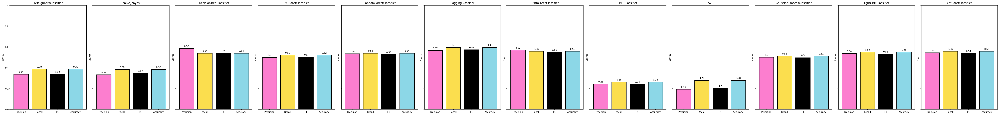

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

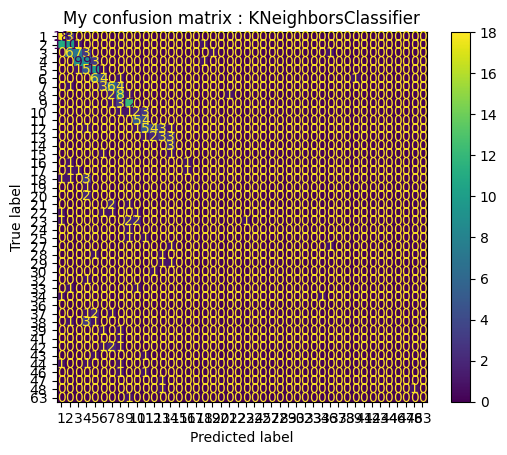

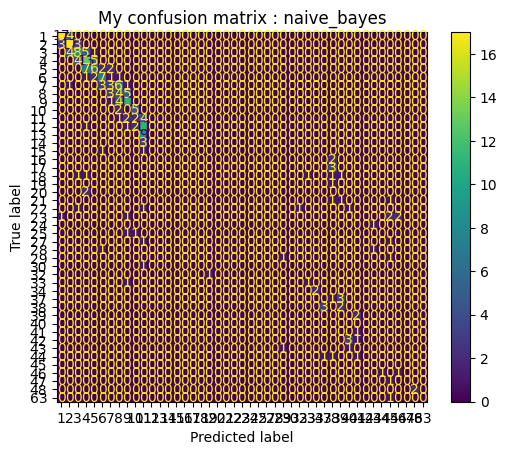

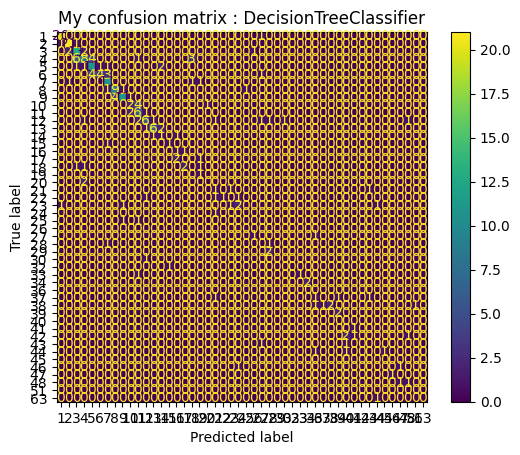

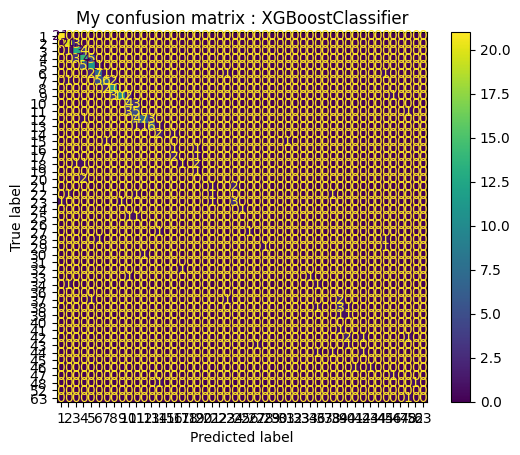

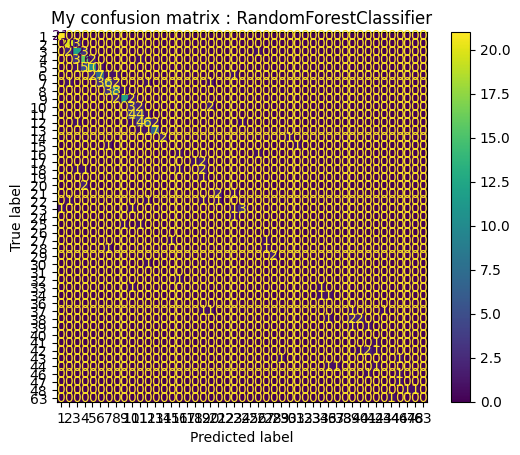

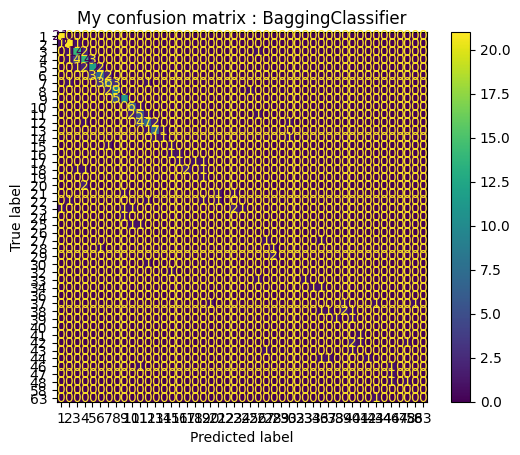

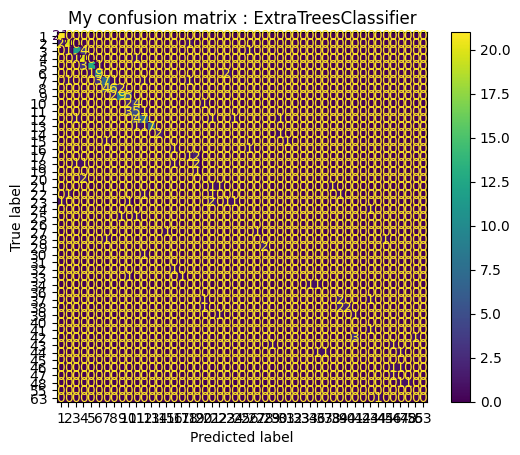

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


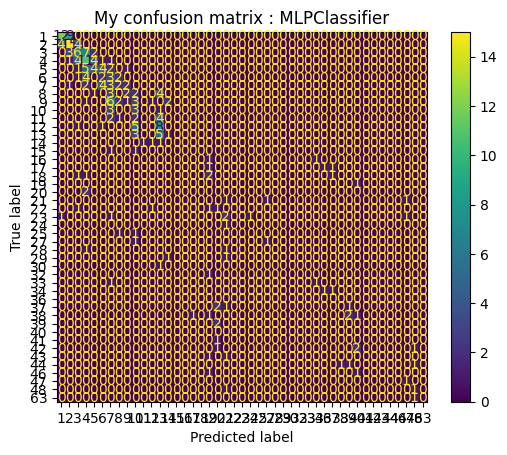

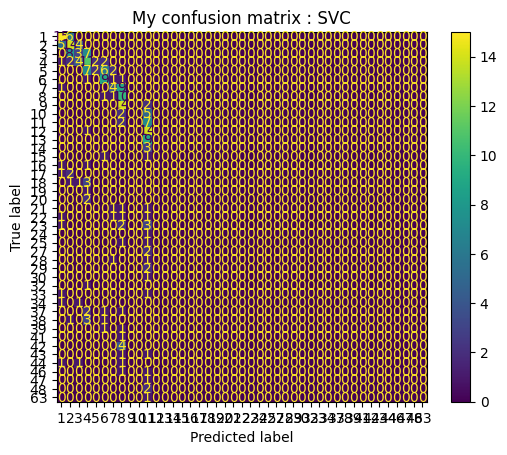

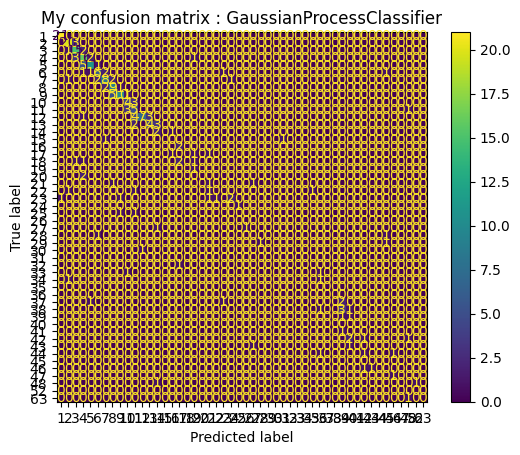

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[LightGBM] [Info] Start training from score -3.391895
[LightGBM] [

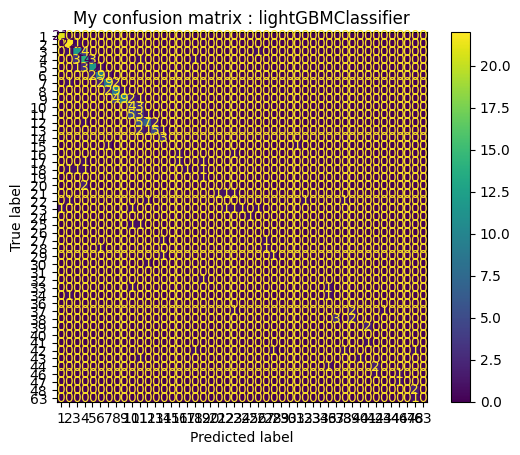

Learning rate set to 0.0794
0:	learn: 3.8639446	total: 36.5ms	remaining: 36.5s
1:	learn: 3.7397573	total: 61.1ms	remaining: 30.5s
2:	learn: 3.6458567	total: 87ms	remaining: 28.9s
3:	learn: 3.4756345	total: 111ms	remaining: 27.5s
4:	learn: 3.2762031	total: 137ms	remaining: 27.2s
5:	learn: 3.1932630	total: 160ms	remaining: 26.5s
6:	learn: 3.0686935	total: 184ms	remaining: 26.1s
7:	learn: 3.0092311	total: 221ms	remaining: 27.4s
8:	learn: 2.9030952	total: 244ms	remaining: 26.9s
9:	learn: 2.8204160	total: 253ms	remaining: 25s
10:	learn: 2.7632587	total: 276ms	remaining: 24.8s
11:	learn: 2.6971751	total: 300ms	remaining: 24.7s
12:	learn: 2.6249564	total: 325ms	remaining: 24.7s
13:	learn: 2.5727129	total: 348ms	remaining: 24.5s
14:	learn: 2.5335104	total: 372ms	remaining: 24.4s
15:	learn: 2.4933956	total: 410ms	remaining: 25.2s
16:	learn: 2.4523897	total: 445ms	remaining: 25.7s
17:	learn: 2.4073244	total: 472ms	remaining: 25.8s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2.3

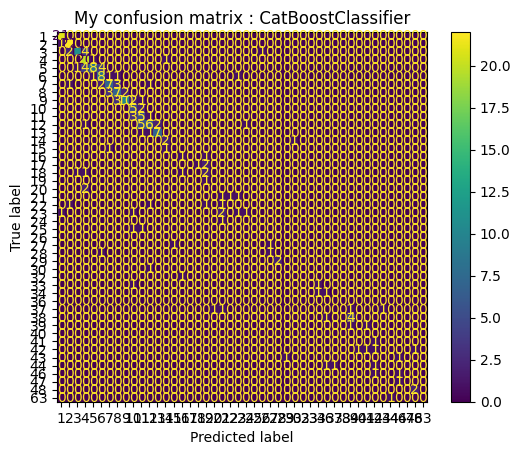

In [ ]:
for model,model_name in model_class:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_test = np.array(y_test)

    #หาค่า unique labels จากการรวม y_test และ y_pred
    unique_labels = np.unique(np.concatenate((y_test, y_pred), axis=None))
    labels = [str(label) for label in unique_labels]

    #คำนวณค่า Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot()

    #ใส่ชื่อตามชื่อของโมเดล
    plt.title("My confusion matrix : "+model_name)

    #แสดงผลกราฟ Confusion Matrix
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X_train, y_train)

  #Predict Model
  y_pred = model.predict(X_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000133 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000035 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 38.1ms	remaining: 38s
1:	learn: 3.7699887	total: 66.2ms	remaining: 33s
2:	learn: 3.6374395	total: 93ms	remaining: 30.9s
3:	learn: 3.4525588	total: 99.9ms	remaining: 24.9s
4:	learn: 3.3043578	total: 122ms	remaining: 24.3s
5:	learn: 3.1974232	total: 132ms	remaining: 21.8s
6:	learn: 3.1168060	total: 154ms	remaining: 21.8s
7:	learn: 3.0316053	total: 178ms	remaining: 22.1s
8:	learn: 2.9164232	total: 215ms	remaining: 23.7s
9:	learn: 2.8308825	total: 251ms	remaining: 24.9s
10:	learn: 2.7641192	total: 291ms	remaining: 26.2s
11:	learn: 2.7040077	total: 321ms	remaining: 26.4s
12:	learn: 2.6391498	total: 343ms	remaining: 26.1s
13:	learn: 2.5783828	total: 366ms	remaining: 25.8s
14:	learn: 2.5194223	total: 388ms	remaining: 25.5s
15:	learn: 2.4762742	total: 411ms	remaining: 25.3s
16:	learn: 2.4362766	total: 450ms	remaining: 26s
17:	learn: 2.4019272	total: 496ms	remaining: 27.1s
18:	learn: 2.3726398	total: 537ms	remaining: 27.7s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 22.6ms	remaining: 22.6s
1:	learn: 3.6812507	total: 44.4ms	remaining: 22.2s
2:	learn: 3.5943361	total: 66ms	remaining: 21.9s
3:	learn: 3.4173746	total: 74ms	remaining: 18.4s
4:	learn: 3.2722143	total: 98.3ms	remaining: 19.6s
5:	learn: 3.1947988	total: 120ms	remaining: 19.9s
6:	learn: 3.1147909	total: 142ms	remaining: 20.1s
7:	learn: 3.0563794	total: 164ms	remaining: 20.3s
8:	learn: 2.9807241	total: 186ms	remaining: 20.5s
9:	learn: 2.8957365	total: 226ms	remaining: 22.4s
10:	learn: 2.8284835	total: 263ms	remaining: 23.7s
11:	learn: 2.7719337	total: 301ms	remaining: 24.8s
12:	learn: 2.7037490	total: 340ms	remaining: 25.8s
13:	learn: 2.6334962	total: 368ms	remaining: 25.9s
14:	learn: 2.5791356	total: 394ms	remaining: 25.9s
15:	learn: 2.5369880	total: 416ms	remaining: 25.6s
16:	learn: 2.4966701	total: 451ms	remaining: 26.1s
17:	learn: 2.4538217	total: 490ms	remaining: 26.7s
18:	learn: 2.4011134	total: 515ms	remaining: 26.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 53.9ms	remaining: 26.9s
2:	learn: 3.6334421	total: 91.1ms	remaining: 30.3s
3:	learn: 3.4849033	total: 106ms	remaining: 26.3s
4:	learn: 3.3442909	total: 127ms	remaining: 25.3s
5:	learn: 3.2557597	total: 149ms	remaining: 24.7s
6:	learn: 3.1410990	total: 171ms	remaining: 24.2s
7:	learn: 3.0848395	total: 201ms	remaining: 24.9s
8:	learn: 3.0093885	total: 236ms	remaining: 26s
9:	learn: 2.9314518	total: 284ms	remaining: 28.1s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 361ms	remaining: 29.7s
12:	learn: 2.7327315	total: 383ms	remaining: 29s
13:	learn: 2.6843200	total: 405ms	remaining: 28.5s
14:	learn: 2.6309948	total: 427ms	remaining: 28s
15:	learn: 2.5896154	total: 450ms	remaining: 27.7s
16:	learn: 2.5443380	total: 472ms	remaining: 27.3s
17:	learn: 2.5020189	total: 502ms	remaining: 27.4s
18:	learn: 2.4589923	total: 542ms	remaining: 28s
19:	learn: 2.4106644	total: 571ms	remaining: 28s
20:	learn: 2.3709353	total: 593ms	remaining: 27.7s

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8064426	total: 32.5ms	remaining: 32.5s
1:	learn: 3.7095437	total: 65.5ms	remaining: 32.7s
2:	learn: 3.6234020	total: 92.3ms	remaining: 30.7s
3:	learn: 3.5219364	total: 115ms	remaining: 28.6s
4:	learn: 3.3261204	total: 137ms	remaining: 27.2s
5:	learn: 3.2046959	total: 158ms	remaining: 26.2s
6:	learn: 3.1324966	total: 182ms	remaining: 25.8s
7:	learn: 3.0746523	total: 226ms	remaining: 28.1s
8:	learn: 2.9722810	total: 266ms	remaining: 29.3s
9:	learn: 2.8863538	total: 282ms	remaining: 27.9s
10:	learn: 2.8240149	total: 319ms	remaining: 28.7s
11:	learn: 2.7591890	total: 341ms	remaining: 28.1s
12:	learn: 2.6853846	total: 373ms	remaining: 28.4s
13:	learn: 2.6191711	total: 396ms	remaining: 27.9s
14:	learn: 2.5691761	total: 419ms	remaining: 27.5s
15:	learn: 2.5250907	total: 456ms	remaining: 28.1s
16:	learn: 2.4830234	total: 487ms	remaining: 28.2s
17:	learn: 2.4407160	total: 513ms	remaining: 28s
18:	learn: 2.4025737	total: 535ms	remaining: 27.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3322320	total: 108ms	remaining: 21.6s
5:	learn: 3.2643425	total: 148ms	remaining: 24.6s
6:	learn: 3.1809232	total: 184ms	remaining: 26.2s
7:	learn: 3.1211707	total: 223ms	remaining: 27.7s
8:	learn: 3.0450874	total: 257ms	remaining: 28.3s
9:	learn: 2.9612655	total: 279ms	remaining: 27.6s
10:	learn: 2.8920670	total: 300ms	remaining: 27s
11:	learn: 2.8145660	total: 330ms	remaining: 27.2s
12:	learn: 2.7392359	total: 369ms	remaining: 28s
13:	learn: 2.6846049	total: 394ms	remaining: 27.8s
14:	learn: 2.6274903	total: 416ms	remaining: 27.3s
15:	learn: 2.5862957	total: 438ms	remaining: 26.9s
16:	learn: 2.5426484	total: 459ms	remaining: 26.5s
17:	learn: 2.4982743	total: 480ms	remaining: 26.2s
18:	learn: 2.4573390	total: 502ms	remaining: 25.9s
19:	learn: 2.4102792	total: 523ms	remaining: 25.6s
20:	learn: 2.3700533	total: 566ms	remaining: 26.4s
21:	learn: 2.3452094	total: 603ms	remaining: 26.8s
22:	learn: 2.3196629	total: 633ms	remaining: 26.9s
23:	learn: 2.2819446	total: 654ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.7ms	remaining: 22.6s
1:	learn: 3.7484080	total: 45.1ms	remaining: 22.5s
2:	learn: 3.6594905	total: 67.4ms	remaining: 22.4s
3:	learn: 3.4810880	total: 78.4ms	remaining: 19.5s
4:	learn: 3.3331988	total: 111ms	remaining: 22.1s
5:	learn: 3.2592621	total: 133ms	remaining: 22.1s
6:	learn: 3.1544492	total: 156ms	remaining: 22.1s
7:	learn: 3.0923563	total: 178ms	remaining: 22.1s
8:	learn: 3.0187806	total: 217ms	remaining: 23.9s
9:	learn: 2.9371069	total: 256ms	remaining: 25.3s
10:	learn: 2.8695088	total: 293ms	remaining: 26.3s
11:	learn: 2.8133799	total: 330ms	remaining: 27.1s
12:	learn: 2.7372023	total: 359ms	remaining: 27.3s
13:	learn: 2.6678466	total: 381ms	remaining: 26.8s
14:	learn: 2.6137397	total: 403ms	remaining: 26.5s
15:	learn: 2.5615789	total: 432ms	remaining: 26.6s
16:	learn: 2.5207092	total: 471ms	remaining: 27.2s
17:	learn: 2.4795757	total: 502ms	remaining: 27.4s
18:	learn: 2.4402746	total: 525ms	remaining: 27.1s
19:	lea

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3411053	total: 106ms	remaining: 21.1s
5:	learn: 3.2449077	total: 141ms	remaining: 23.4s
6:	learn: 3.1621918	total: 173ms	remaining: 24.5s
7:	learn: 3.1034455	total: 200ms	remaining: 24.8s
8:	learn: 2.9965094	total: 234ms	remaining: 25.7s
9:	learn: 2.9180163	total: 265ms	remaining: 26.3s
10:	learn: 2.8470785	total: 287ms	remaining: 25.8s
11:	learn: 2.7752889	total: 312ms	remaining: 25.7s
12:	learn: 2.7037633	total: 343ms	remaining: 26.1s
13:	learn: 2.6674419	total: 379ms	remaining: 26.7s
14:	learn: 2.6170536	total: 402ms	remaining: 26.4s
15:	learn: 2.5754001	total: 423ms	remaining: 26s
16:	learn: 2.5307902	total: 459ms	remaining: 26.5s
17:	learn: 2.4925670	total: 490ms	remaining: 26.8s
18:	learn: 2.4529037	total: 539ms	remaining: 27.8s
19:	learn: 2.4058253	total: 577ms	remaining: 28.3s
20:	learn: 2.3778239	total: 620ms	remaining: 28.9s
21:	learn: 2.3530449	total: 657ms	remaining: 29.2s
22:	learn: 2.3276181	total: 693ms	remaining: 29.4s
23:	learn: 2.2887251	total: 727ms	remai

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8381744	total: 34.7ms	remaining: 34.7s
1:	learn: 3.7004105	total: 69.9ms	remaining: 34.9s
2:	learn: 3.6104702	total: 104ms	remaining: 34.6s
3:	learn: 3.4342228	total: 111ms	remaining: 27.6s
4:	learn: 3.2911717	total: 132ms	remaining: 26.3s
5:	learn: 3.1853531	total: 141ms	remaining: 23.4s
6:	learn: 3.0793088	total: 163ms	remaining: 23.1s
7:	learn: 2.9817558	total: 185ms	remaining: 23s
8:	learn: 2.9069319	total: 228ms	remaining: 25.1s
9:	learn: 2.8229469	total: 266ms	remaining: 26.3s
10:	learn: 2.7578803	total: 302ms	remaining: 27.2s
11:	learn: 2.6971236	total: 339ms	remaining: 27.9s
12:	learn: 2.6305608	total: 361ms	remaining: 27.4s
13:	learn: 2.5662315	total: 397ms	remaining: 28s
14:	learn: 2.5042711	total: 427ms	remaining: 28.1s
15:	learn: 2.4615175	total: 462ms	remaining: 28.4s
16:	learn: 2.4086955	total: 501ms	remaining: 29s
17:	learn: 2.3754565	total: 563ms	remaining: 30.7s
18:	learn: 2.3465780	total: 611ms	remaining: 31.5s
19:	learn: 2.3213413	total: 653ms	remaining: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8480707	total: 47.8ms	remaining: 47.8s
1:	learn: 3.7115540	total: 106ms	remaining: 53s
2:	learn: 3.6234599	total: 160ms	remaining: 53.1s
3:	learn: 3.4455719	total: 175ms	remaining: 43.6s
4:	learn: 3.3004163	total: 219ms	remaining: 43.6s
5:	learn: 3.2153645	total: 266ms	remaining: 44.1s
6:	learn: 3.1139272	total: 311ms	remaining: 44s
7:	learn: 3.0567616	total: 354ms	remaining: 43.8s
8:	learn: 2.9830415	total: 397ms	remaining: 43.7s
9:	learn: 2.9030401	total: 441ms	remaining: 43.7s
10:	learn: 2.8363418	total: 487ms	remaining: 43.8s
11:	learn: 2.7784608	total: 529ms	remaining: 43.5s
12:	learn: 2.7119909	total: 574ms	remaining: 43.6s
13:	learn: 2.6411087	total: 628ms	remaining: 44.2s
14:	learn: 2.5881612	total: 675ms	remaining: 44.4s
15:	learn: 2.5343530	total: 725ms	remaining: 44.6s
16:	learn: 2.4885762	total: 772ms	remaining: 44.7s
17:	learn: 2.4427486	total: 812ms	remaining: 44.3s
18:	learn: 2.4027594	total: 863ms	remaining: 44.6s
19:	learn: 2.3559613	total: 914ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8682283	total: 41ms	remaining: 40.9s
1:	learn: 3.7300207	total: 78.6ms	remaining: 39.2s
2:	learn: 3.6436920	total: 117ms	remaining: 38.9s
3:	learn: 3.4961195	total: 133ms	remaining: 33.1s
4:	learn: 3.3991806	total: 182ms	remaining: 36.3s
5:	learn: 3.3201834	total: 239ms	remaining: 39.6s
6:	learn: 3.2351281	total: 294ms	remaining: 41.7s
7:	learn: 3.1767200	total: 357ms	remaining: 44.2s
8:	learn: 3.0617868	total: 400ms	remaining: 44.1s
9:	learn: 2.9782887	total: 445ms	remaining: 44.1s
10:	learn: 2.8993493	total: 497ms	remaining: 44.7s
11:	learn: 2.8252658	total: 545ms	remaining: 44.9s
12:	learn: 2.7444908	total: 588ms	remaining: 44.6s
13:	learn: 2.6702937	total: 621ms	remaining: 43.7s
14:	learn: 2.6138347	total: 673ms	remaining: 44.2s
15:	learn: 2.5591252	total: 722ms	remaining: 44.4s
16:	learn: 2.5154962	total: 775ms	remaining: 44.8s
17:	learn: 2.4740075	total: 821ms	remaining: 44.8s
18:	learn: 2.4343606	total: 862ms	remaining: 44.5s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 44.8ms	remaining: 44.8s
1:	learn: 3.7699887	total: 89.5ms	remaining: 44.7s
2:	learn: 3.6374395	total: 120ms	remaining: 40s
3:	learn: 3.4525588	total: 127ms	remaining: 31.7s
4:	learn: 3.3043578	total: 150ms	remaining: 29.8s
5:	learn: 3.1974232	total: 169ms	remaining: 27.9s
6:	learn: 3.1168060	total: 214ms	remaining: 30.4s
7:	learn: 3.0316053	total: 255ms	remaining: 31.6s
8:	learn: 2.9164232	total: 296ms	remaining: 32.6s
9:	learn: 2.8308825	total: 335ms	remaining: 33.1s
10:	learn: 2.7641192	total: 356ms	remaining: 32s
11:	learn: 2.7040077	total: 378ms	remaining: 31.2s
12:	learn: 2.6391498	total: 401ms	remaining: 30.5s
13:	learn: 2.5783828	total: 439ms	remaining: 30.9s
14:	learn: 2.5194223	total: 471ms	remaining: 30.9s
15:	learn: 2.4762742	total: 506ms	remaining: 31.1s
16:	learn: 2.4362766	total: 529ms	remaining: 30.6s
17:	learn: 2.4019272	total: 551ms	remaining: 30s
18:	learn: 2.3726398	total: 573ms	remaining: 29.6s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 35.3ms	remaining: 35.3s
1:	learn: 3.6812507	total: 58.8ms	remaining: 29.4s
2:	learn: 3.5943361	total: 81.6ms	remaining: 27.1s
3:	learn: 3.4173746	total: 91.5ms	remaining: 22.8s
4:	learn: 3.2722143	total: 113ms	remaining: 22.5s
5:	learn: 3.1947988	total: 145ms	remaining: 24.1s
6:	learn: 3.1147909	total: 167ms	remaining: 23.7s
7:	learn: 3.0563794	total: 205ms	remaining: 25.4s
8:	learn: 2.9807241	total: 243ms	remaining: 26.7s
9:	learn: 2.8957365	total: 279ms	remaining: 27.6s
10:	learn: 2.8284835	total: 312ms	remaining: 28s
11:	learn: 2.7719337	total: 350ms	remaining: 28.8s
12:	learn: 2.7037490	total: 378ms	remaining: 28.7s
13:	learn: 2.6334962	total: 400ms	remaining: 28.1s
14:	learn: 2.5791356	total: 441ms	remaining: 28.9s
15:	learn: 2.5369880	total: 473ms	remaining: 29.1s
16:	learn: 2.4966701	total: 499ms	remaining: 28.9s
17:	learn: 2.4538217	total: 521ms	remaining: 28.4s
18:	learn: 2.4011134	total: 542ms	remaining: 28s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 60.4ms	remaining: 30.1s
2:	learn: 3.6334421	total: 97.2ms	remaining: 32.3s
3:	learn: 3.4849033	total: 113ms	remaining: 28.1s
4:	learn: 3.3442909	total: 135ms	remaining: 26.8s
5:	learn: 3.2557597	total: 157ms	remaining: 26.1s
6:	learn: 3.1410990	total: 179ms	remaining: 25.4s
7:	learn: 3.0848395	total: 215ms	remaining: 26.6s
8:	learn: 3.0093885	total: 259ms	remaining: 28.5s
9:	learn: 2.9314518	total: 296ms	remaining: 29.3s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 372ms	remaining: 30.6s
12:	learn: 2.7327315	total: 395ms	remaining: 30s
13:	learn: 2.6843200	total: 418ms	remaining: 29.5s
14:	learn: 2.6309948	total: 442ms	remaining: 29s
15:	learn: 2.5896154	total: 475ms	remaining: 29.2s
16:	learn: 2.5443380	total: 507ms	remaining: 29.3s
17:	learn: 2.5020189	total: 545ms	remaining: 29.8s
18:	learn: 2.4589923	total: 569ms	remaining: 29.4s
19:	learn: 2.4106644	total: 591ms	remaining: 28.9s
20:	learn: 2.3709353	total: 612ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8064426	total: 42ms	remaining: 41.9s
1:	learn: 3.7095437	total: 75.2ms	remaining: 37.5s
2:	learn: 3.6234020	total: 106ms	remaining: 35.1s
3:	learn: 3.5219364	total: 128ms	remaining: 31.9s
4:	learn: 3.3261204	total: 150ms	remaining: 29.8s
5:	learn: 3.2046959	total: 171ms	remaining: 28.4s
6:	learn: 3.1324966	total: 200ms	remaining: 28.4s
7:	learn: 3.0746523	total: 237ms	remaining: 29.4s
8:	learn: 2.9722810	total: 278ms	remaining: 30.6s
9:	learn: 2.8863538	total: 290ms	remaining: 28.7s
10:	learn: 2.8240149	total: 326ms	remaining: 29.3s
11:	learn: 2.7591890	total: 356ms	remaining: 29.3s
12:	learn: 2.6853846	total: 378ms	remaining: 28.7s
13:	learn: 2.6191711	total: 400ms	remaining: 28.1s
14:	learn: 2.5691761	total: 422ms	remaining: 27.7s
15:	learn: 2.5250907	total: 444ms	remaining: 27.3s
16:	learn: 2.4830234	total: 466ms	remaining: 26.9s
17:	learn: 2.4407160	total: 502ms	remaining: 27.4s
18:	learn: 2.4025737	total: 549ms	remaining: 28.4s
19:	learn: 2.3586694	total: 581ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2:	learn: 3.6613275	total: 73.1ms	remaining: 24.3s
3:	learn: 3.4796160	total: 89ms	remaining: 22.2s
4:	learn: 3.3322320	total: 128ms	remaining: 25.4s
5:	learn: 3.2643425	total: 156ms	remaining: 25.8s
6:	learn: 3.1809232	total: 178ms	remaining: 25.3s
7:	learn: 3.1211707	total: 215ms	remaining: 26.6s
8:	learn: 3.0450874	total: 246ms	remaining: 27.1s
9:	learn: 2.9612655	total: 283ms	remaining: 28s
10:	learn: 2.8920670	total: 315ms	remaining: 28.3s
11:	learn: 2.8145660	total: 351ms	remaining: 28.9s
12:	learn: 2.7392359	total: 384ms	remaining: 29.2s
13:	learn: 2.6846049	total: 418ms	remaining: 29.4s
14:	learn: 2.6274903	total: 439ms	remaining: 28.8s
15:	learn: 2.5862957	total: 461ms	remaining: 28.4s
16:	learn: 2.5426484	total: 486ms	remaining: 28.1s
17:	learn: 2.4982743	total: 522ms	remaining: 28.5s
18:	learn: 2.4573390	total: 555ms	remaining: 28.7s
19:	learn: 2.4102792	total: 587ms	remaining: 28.8s
20:	learn: 2.3700533	total: 609ms	remaining: 28.4s
21:	learn: 2.3452094	total: 631ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.3ms	remaining: 22.3s
1:	learn: 3.7484080	total: 48.1ms	remaining: 24s
2:	learn: 3.6594905	total: 80ms	remaining: 26.6s
3:	learn: 3.4810880	total: 87.4ms	remaining: 21.8s
4:	learn: 3.3331988	total: 113ms	remaining: 22.5s
5:	learn: 3.2592621	total: 135ms	remaining: 22.4s
6:	learn: 3.1544492	total: 157ms	remaining: 22.3s
7:	learn: 3.0923563	total: 180ms	remaining: 22.3s
8:	learn: 3.0187806	total: 214ms	remaining: 23.5s
9:	learn: 2.9371069	total: 253ms	remaining: 25.1s
10:	learn: 2.8695088	total: 295ms	remaining: 26.5s
11:	learn: 2.8133799	total: 336ms	remaining: 27.6s
12:	learn: 2.7372023	total: 362ms	remaining: 27.5s
13:	learn: 2.6678466	total: 384ms	remaining: 27.1s
14:	learn: 2.6137397	total: 406ms	remaining: 26.7s
15:	learn: 2.5615789	total: 441ms	remaining: 27.1s
16:	learn: 2.5207092	total: 479ms	remaining: 27.7s
17:	learn: 2.4795757	total: 506ms	remaining: 27.6s
18:	learn: 2.4402746	total: 528ms	remaining: 27.3s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8344131	total: 29.8ms	remaining: 29.8s
1:	learn: 3.6971313	total: 51.4ms	remaining: 25.7s
2:	learn: 3.6103653	total: 73.3ms	remaining: 24.4s
3:	learn: 3.4367733	total: 80.2ms	remaining: 20s
4:	learn: 3.3411053	total: 104ms	remaining: 20.8s
5:	learn: 3.2449077	total: 126ms	remaining: 20.8s
6:	learn: 3.1621918	total: 148ms	remaining: 21s
7:	learn: 3.1034455	total: 170ms	remaining: 21s
8:	learn: 2.9965094	total: 203ms	remaining: 22.4s
9:	learn: 2.9180163	total: 241ms	remaining: 23.9s
10:	learn: 2.8470785	total: 281ms	remaining: 25.3s
11:	learn: 2.7752889	total: 317ms	remaining: 26.1s
12:	learn: 2.7037633	total: 349ms	remaining: 26.5s
13:	learn: 2.6674419	total: 371ms	remaining: 26.1s
14:	learn: 2.6170536	total: 392ms	remaining: 25.8s
15:	learn: 2.5754001	total: 424ms	remaining: 26.1s
16:	learn: 2.5307902	total: 463ms	remaining: 26.7s
17:	learn: 2.4925670	total: 502ms	remaining: 27.4s
18:	learn: 2.4529037	total: 530ms	remaining: 27.3s
19:	learn: 2.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8381744	total: 22.6ms	remaining: 22.6s
1:	learn: 3.7004105	total: 44.5ms	remaining: 22.2s
2:	learn: 3.6104702	total: 66.5ms	remaining: 22.1s
3:	learn: 3.4342228	total: 74.8ms	remaining: 18.6s
4:	learn: 3.2911717	total: 99.9ms	remaining: 19.9s
5:	learn: 3.1853531	total: 109ms	remaining: 18.1s
6:	learn: 3.0793088	total: 132ms	remaining: 18.7s
7:	learn: 2.9817558	total: 153ms	remaining: 19s
8:	learn: 2.9069319	total: 176ms	remaining: 19.4s
9:	learn: 2.8229469	total: 216ms	remaining: 21.4s
10:	learn: 2.7578803	total: 246ms	remaining: 22.1s
11:	learn: 2.6971236	total: 285ms	remaining: 23.5s
12:	learn: 2.6305608	total: 322ms	remaining: 24.4s
13:	learn: 2.5662315	total: 357ms	remaining: 25.2s
14:	learn: 2.5042711	total: 382ms	remaining: 25.1s
15:	learn: 2.4615175	total: 404ms	remaining: 24.8s
16:	learn: 2.4086955	total: 439ms	remaining: 25.4s
17:	learn: 2.3754565	total: 478ms	remaining: 26.1s
18:	learn: 2.3465780	total: 509ms	remaining: 26.3s
19:	lear

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8480707	total: 23.7ms	remaining: 23.6s
1:	learn: 3.7115540	total: 46.8ms	remaining: 23.4s
2:	learn: 3.6234599	total: 70.7ms	remaining: 23.5s
3:	learn: 3.4455719	total: 78.9ms	remaining: 19.6s
4:	learn: 3.3004163	total: 106ms	remaining: 21.1s
5:	learn: 3.2153645	total: 128ms	remaining: 21.2s
6:	learn: 3.1139272	total: 150ms	remaining: 21.2s
7:	learn: 3.0567616	total: 172ms	remaining: 21.3s
8:	learn: 2.9830415	total: 207ms	remaining: 22.8s
9:	learn: 2.9030401	total: 251ms	remaining: 24.9s
10:	learn: 2.8363418	total: 293ms	remaining: 26.3s
11:	learn: 2.7784608	total: 329ms	remaining: 27.1s
12:	learn: 2.7119909	total: 366ms	remaining: 27.8s
13:	learn: 2.6411087	total: 395ms	remaining: 27.8s
14:	learn: 2.5881612	total: 430ms	remaining: 28.2s
15:	learn: 2.5343530	total: 467ms	remaining: 28.7s
16:	learn: 2.4885762	total: 498ms	remaining: 28.8s
17:	learn: 2.4427486	total: 520ms	remaining: 28.4s
18:	learn: 2.4027594	total: 541ms	remaining: 28s
19:	learn

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
4:	learn: 3.3322320	total: 102ms	remaining: 20.3s
5:	learn: 3.2643425	total: 124ms	remaining: 20.5s
6:	learn: 3.1809232	total: 146ms	remaining: 20.7s
7:	learn: 3.1211707	total: 167ms	remaining: 20.8s
8:	learn: 3.0450874	total: 191ms	remaining: 21.1s
9:	learn: 2.9612655	total: 229ms	remaining: 22.6s
10:	learn: 2.8920670	total: 260ms	remaining: 23.4s
11:	learn: 2.8145660	total: 291ms	remaining: 24s
12:	learn: 2.7392359	total: 316ms	remaining: 24s
13:	learn: 2.6846049	total: 337ms	remaining: 23.7s
14:	learn: 2.6274903	total: 359ms	remaining: 23.5s
15:	learn: 2.5862957	total: 381ms	remaining: 23.4s
16:	learn: 2.5426484	total: 403ms	remaining: 23.3s
17:	learn: 2.4982743	total: 425ms	remaining: 23.2s
18:	learn: 2.4573390	total: 465ms	remaining: 24s
19:	learn: 2.4102792	total: 502ms	remaining: 24.6s
20:	learn: 2.3700533	total: 531ms	remaining: 24.8s
21:	learn: 2.3452094	total: 553ms	remaining: 24.6s
22:	learn: 2.3196629	total: 575ms	remaining

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_cross_2000.csv', index = False, header = True)

### **Delete Outlier**

#### **Convert Data**

In [ ]:
#ข้อมูลที่ตัด outlier
cutoutlier

In [ ]:
#แบ่งช่วงข้อมูลที่ delete outliner
cutoutlier['Class'] = pd.cut(cutoutlier['charges'], bins=range(0, int(cutoutlier['charges'].max()) + 2001, 2000), labels=False)

In [ ]:
#สร้างตัวแปร X1 และ y1
y1 = cutoutlier["Class"]
X1 = cutoutlier.iloc[:,:6].copy()

#แบ่งข้อมูลสำหรับ Train และ Test
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X1_train, y1_train)

    #Predict Model
    y1_pred = model.predict(X1_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y1_test, y1_pred, average='weighted')
    recall = recall_score(y1_test, y1_pred, average='weighted')
    f1 = f1_score(y1_test, y1_pred, average='weighted')
    accuracy = accuracy_score(y1_test, y1_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy', 'classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_2000.csv', index = False, header = True)

####**Barchart**

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block ที่เราแบ่งไว้
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

In [ ]:
#นับ class ที่แบ่งว่ามีทั้งหมดที่กลุ่ม
cutoutlier['Class'].value_counts().count()

In [ ]:
#ทำ loop เพื่อ fit model และ ทำ croos validation ออกมาทุก model
for model,model_name in model_class:
    model.fit(X1_train, y1_train)
    y1_pred = model.predict(X1_test)
    y1_test = np.array(y1_test)

    unique1_labels = np.unique(np.concatenate((y1_test, y1_pred), axis=None))
    labels1 = [str(label) for label in unique1_labels]

    cm1 = confusion_matrix(y1_test, y1_pred)
    disp1 = ConfusionMatrixDisplay(confusion_matrix=cm1, display_labels=labels1)
    disp1.plot()
    plt.title("My confusion matrix : "+model_name)
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X1_train, y1_train)

  #Predict Model
  y1_pred = model.predict(X1_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_cross_2000.csv', index = False, header = True)

## **3000 per range**


### **Original**

#### **Convert Data**

In [ ]:
#แบ่งข้อมูลเป็นช่วงละ 1000 แล้วเก็บไว้ในตัวแปร Class
df['Class'] = pd.cut(df['charges'], bins=range(0, int(df['charges'].max()) + 3001, 3000), labels=False)

In [ ]:
#สร้างตัวแปร X และ y
X = df.iloc[:,:6]
y = df['Class']

#แบ่งข้อมูลสำหรับ Train และ Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X_train, y_train)

    #Predict Model
    y_pred = model.predict(X_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    accuracy = accuracy_score(y_test, y_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.0794
0:	learn: 3.8639446	total: 29.6ms	remaining: 29.5s
1:	learn: 3.7397573	total: 54.2ms	remaining: 27.1s
2:	learn: 3.6458567	total: 79.3ms	remaining: 26.3s
3:	learn: 3.4756345	total: 104ms	remaining: 26s
4:	learn: 3.2762031	total: 129ms	remaining: 25.6s
5:	learn: 3.1932630	total: 156ms	remaining: 25.9s
6:	learn: 3.0686935	total: 187ms	remaining: 26.6s
7:	learn: 3.0092311	total: 232ms	remaining: 28.8s
8:	learn: 2.9030952	total: 257ms	remaining: 28.3s
9:	learn: 2.8204160	total: 265ms	remaining: 26.2s
10:	learn: 2.7632587	total: 288ms	remaining: 25.9s
11:	learn: 2.6971751	total: 312ms	remaining: 25.7s
12:	learn: 2.6249564	total: 336ms	remaining: 25.5s
13:	learn: 2.5727129	total: 361ms	remaining: 25.4s
14:	learn: 2.5335104	total: 387ms	remaining: 25.4s
15:	learn: 2.4933956	total: 411ms	remaining: 25.3s
16:	learn: 2.4523897	total: 444ms	remaining: 25.7s
17:	learn: 2.4073244	total: 469ms	remaining: 25.6s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_3000.csv', index = False, header = True)

####**Barchart**

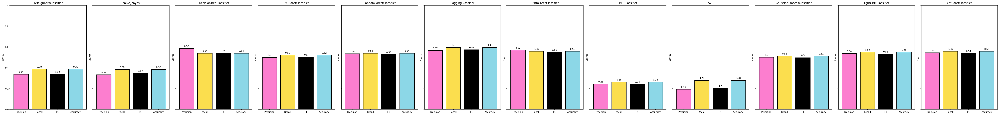

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

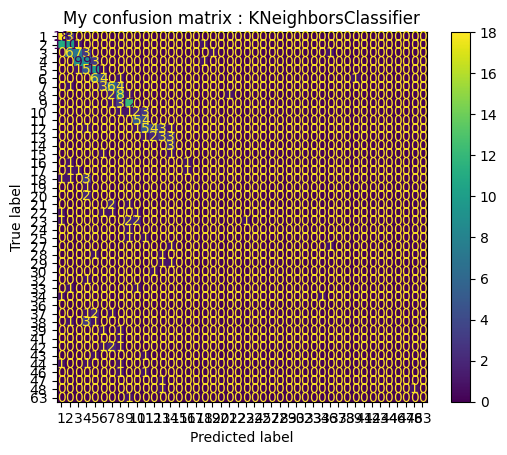

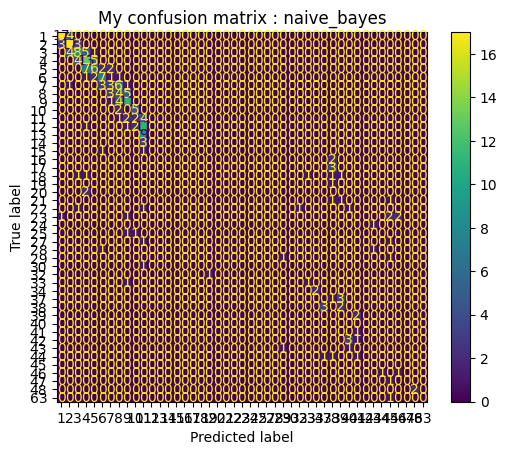

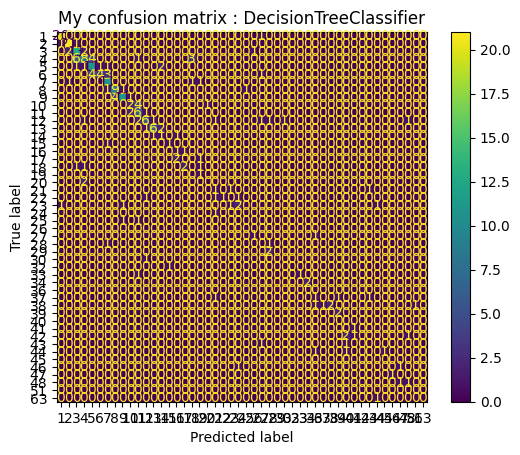

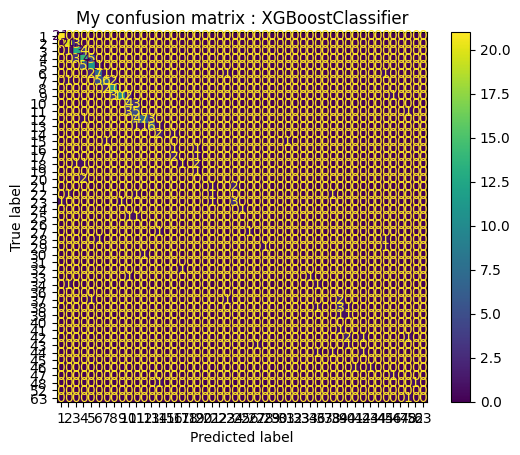

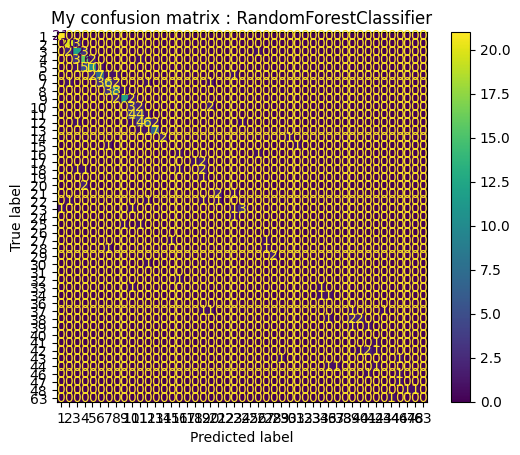

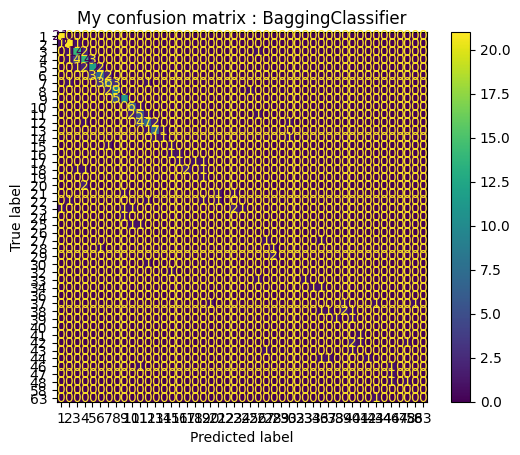

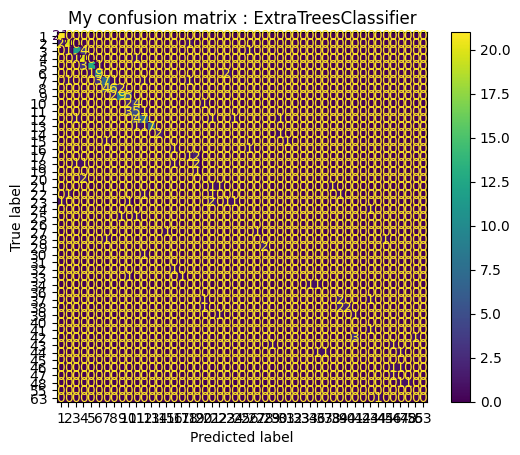

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


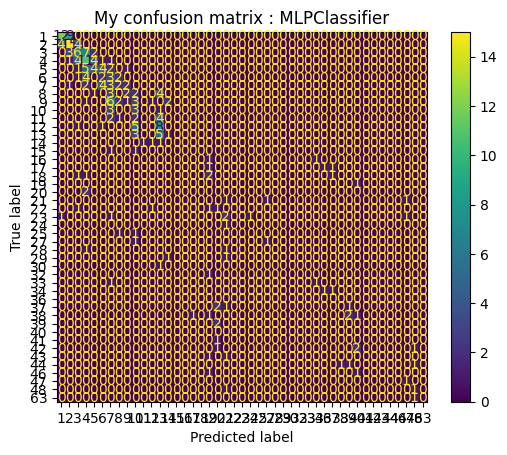

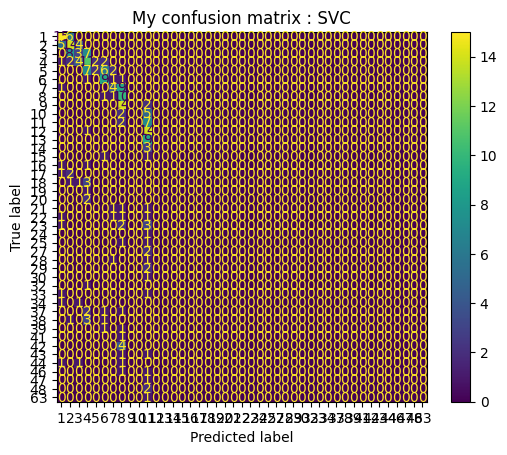

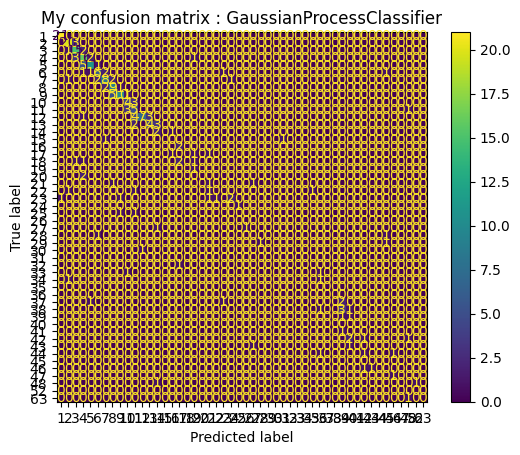

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[LightGBM] [Info] Start training from score -3.391895
[LightGBM] [

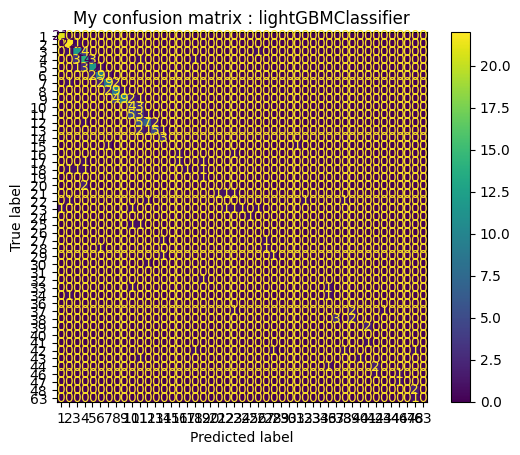

Learning rate set to 0.0794
0:	learn: 3.8639446	total: 36.5ms	remaining: 36.5s
1:	learn: 3.7397573	total: 61.1ms	remaining: 30.5s
2:	learn: 3.6458567	total: 87ms	remaining: 28.9s
3:	learn: 3.4756345	total: 111ms	remaining: 27.5s
4:	learn: 3.2762031	total: 137ms	remaining: 27.2s
5:	learn: 3.1932630	total: 160ms	remaining: 26.5s
6:	learn: 3.0686935	total: 184ms	remaining: 26.1s
7:	learn: 3.0092311	total: 221ms	remaining: 27.4s
8:	learn: 2.9030952	total: 244ms	remaining: 26.9s
9:	learn: 2.8204160	total: 253ms	remaining: 25s
10:	learn: 2.7632587	total: 276ms	remaining: 24.8s
11:	learn: 2.6971751	total: 300ms	remaining: 24.7s
12:	learn: 2.6249564	total: 325ms	remaining: 24.7s
13:	learn: 2.5727129	total: 348ms	remaining: 24.5s
14:	learn: 2.5335104	total: 372ms	remaining: 24.4s
15:	learn: 2.4933956	total: 410ms	remaining: 25.2s
16:	learn: 2.4523897	total: 445ms	remaining: 25.7s
17:	learn: 2.4073244	total: 472ms	remaining: 25.8s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2.3

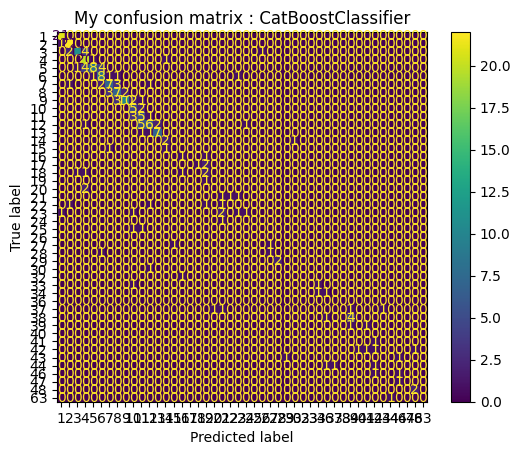

In [ ]:
for model,model_name in model_class:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_test = np.array(y_test)

    #หาค่า unique labels จากการรวม y_test และ y_pred
    unique_labels = np.unique(np.concatenate((y_test, y_pred), axis=None))
    labels = [str(label) for label in unique_labels]

    #คำนวณค่า Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot()

    #ใส่ชื่อตามชื่อของโมเดล
    plt.title("My confusion matrix : "+model_name)

    #แสดงผลกราฟ Confusion Matrix
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X_train, y_train)

  #Predict Model
  y_pred = model.predict(X_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000133 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000035 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 38.1ms	remaining: 38s
1:	learn: 3.7699887	total: 66.2ms	remaining: 33s
2:	learn: 3.6374395	total: 93ms	remaining: 30.9s
3:	learn: 3.4525588	total: 99.9ms	remaining: 24.9s
4:	learn: 3.3043578	total: 122ms	remaining: 24.3s
5:	learn: 3.1974232	total: 132ms	remaining: 21.8s
6:	learn: 3.1168060	total: 154ms	remaining: 21.8s
7:	learn: 3.0316053	total: 178ms	remaining: 22.1s
8:	learn: 2.9164232	total: 215ms	remaining: 23.7s
9:	learn: 2.8308825	total: 251ms	remaining: 24.9s
10:	learn: 2.7641192	total: 291ms	remaining: 26.2s
11:	learn: 2.7040077	total: 321ms	remaining: 26.4s
12:	learn: 2.6391498	total: 343ms	remaining: 26.1s
13:	learn: 2.5783828	total: 366ms	remaining: 25.8s
14:	learn: 2.5194223	total: 388ms	remaining: 25.5s
15:	learn: 2.4762742	total: 411ms	remaining: 25.3s
16:	learn: 2.4362766	total: 450ms	remaining: 26s
17:	learn: 2.4019272	total: 496ms	remaining: 27.1s
18:	learn: 2.3726398	total: 537ms	remaining: 27.7s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 22.6ms	remaining: 22.6s
1:	learn: 3.6812507	total: 44.4ms	remaining: 22.2s
2:	learn: 3.5943361	total: 66ms	remaining: 21.9s
3:	learn: 3.4173746	total: 74ms	remaining: 18.4s
4:	learn: 3.2722143	total: 98.3ms	remaining: 19.6s
5:	learn: 3.1947988	total: 120ms	remaining: 19.9s
6:	learn: 3.1147909	total: 142ms	remaining: 20.1s
7:	learn: 3.0563794	total: 164ms	remaining: 20.3s
8:	learn: 2.9807241	total: 186ms	remaining: 20.5s
9:	learn: 2.8957365	total: 226ms	remaining: 22.4s
10:	learn: 2.8284835	total: 263ms	remaining: 23.7s
11:	learn: 2.7719337	total: 301ms	remaining: 24.8s
12:	learn: 2.7037490	total: 340ms	remaining: 25.8s
13:	learn: 2.6334962	total: 368ms	remaining: 25.9s
14:	learn: 2.5791356	total: 394ms	remaining: 25.9s
15:	learn: 2.5369880	total: 416ms	remaining: 25.6s
16:	learn: 2.4966701	total: 451ms	remaining: 26.1s
17:	learn: 2.4538217	total: 490ms	remaining: 26.7s
18:	learn: 2.4011134	total: 515ms	remaining: 26.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 53.9ms	remaining: 26.9s
2:	learn: 3.6334421	total: 91.1ms	remaining: 30.3s
3:	learn: 3.4849033	total: 106ms	remaining: 26.3s
4:	learn: 3.3442909	total: 127ms	remaining: 25.3s
5:	learn: 3.2557597	total: 149ms	remaining: 24.7s
6:	learn: 3.1410990	total: 171ms	remaining: 24.2s
7:	learn: 3.0848395	total: 201ms	remaining: 24.9s
8:	learn: 3.0093885	total: 236ms	remaining: 26s
9:	learn: 2.9314518	total: 284ms	remaining: 28.1s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 361ms	remaining: 29.7s
12:	learn: 2.7327315	total: 383ms	remaining: 29s
13:	learn: 2.6843200	total: 405ms	remaining: 28.5s
14:	learn: 2.6309948	total: 427ms	remaining: 28s
15:	learn: 2.5896154	total: 450ms	remaining: 27.7s
16:	learn: 2.5443380	total: 472ms	remaining: 27.3s
17:	learn: 2.5020189	total: 502ms	remaining: 27.4s
18:	learn: 2.4589923	total: 542ms	remaining: 28s
19:	learn: 2.4106644	total: 571ms	remaining: 28s
20:	learn: 2.3709353	total: 593ms	remaining: 27.7s

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8064426	total: 32.5ms	remaining: 32.5s
1:	learn: 3.7095437	total: 65.5ms	remaining: 32.7s
2:	learn: 3.6234020	total: 92.3ms	remaining: 30.7s
3:	learn: 3.5219364	total: 115ms	remaining: 28.6s
4:	learn: 3.3261204	total: 137ms	remaining: 27.2s
5:	learn: 3.2046959	total: 158ms	remaining: 26.2s
6:	learn: 3.1324966	total: 182ms	remaining: 25.8s
7:	learn: 3.0746523	total: 226ms	remaining: 28.1s
8:	learn: 2.9722810	total: 266ms	remaining: 29.3s
9:	learn: 2.8863538	total: 282ms	remaining: 27.9s
10:	learn: 2.8240149	total: 319ms	remaining: 28.7s
11:	learn: 2.7591890	total: 341ms	remaining: 28.1s
12:	learn: 2.6853846	total: 373ms	remaining: 28.4s
13:	learn: 2.6191711	total: 396ms	remaining: 27.9s
14:	learn: 2.5691761	total: 419ms	remaining: 27.5s
15:	learn: 2.5250907	total: 456ms	remaining: 28.1s
16:	learn: 2.4830234	total: 487ms	remaining: 28.2s
17:	learn: 2.4407160	total: 513ms	remaining: 28s
18:	learn: 2.4025737	total: 535ms	remaining: 27.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3322320	total: 108ms	remaining: 21.6s
5:	learn: 3.2643425	total: 148ms	remaining: 24.6s
6:	learn: 3.1809232	total: 184ms	remaining: 26.2s
7:	learn: 3.1211707	total: 223ms	remaining: 27.7s
8:	learn: 3.0450874	total: 257ms	remaining: 28.3s
9:	learn: 2.9612655	total: 279ms	remaining: 27.6s
10:	learn: 2.8920670	total: 300ms	remaining: 27s
11:	learn: 2.8145660	total: 330ms	remaining: 27.2s
12:	learn: 2.7392359	total: 369ms	remaining: 28s
13:	learn: 2.6846049	total: 394ms	remaining: 27.8s
14:	learn: 2.6274903	total: 416ms	remaining: 27.3s
15:	learn: 2.5862957	total: 438ms	remaining: 26.9s
16:	learn: 2.5426484	total: 459ms	remaining: 26.5s
17:	learn: 2.4982743	total: 480ms	remaining: 26.2s
18:	learn: 2.4573390	total: 502ms	remaining: 25.9s
19:	learn: 2.4102792	total: 523ms	remaining: 25.6s
20:	learn: 2.3700533	total: 566ms	remaining: 26.4s
21:	learn: 2.3452094	total: 603ms	remaining: 26.8s
22:	learn: 2.3196629	total: 633ms	remaining: 26.9s
23:	learn: 2.2819446	total: 654ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.7ms	remaining: 22.6s
1:	learn: 3.7484080	total: 45.1ms	remaining: 22.5s
2:	learn: 3.6594905	total: 67.4ms	remaining: 22.4s
3:	learn: 3.4810880	total: 78.4ms	remaining: 19.5s
4:	learn: 3.3331988	total: 111ms	remaining: 22.1s
5:	learn: 3.2592621	total: 133ms	remaining: 22.1s
6:	learn: 3.1544492	total: 156ms	remaining: 22.1s
7:	learn: 3.0923563	total: 178ms	remaining: 22.1s
8:	learn: 3.0187806	total: 217ms	remaining: 23.9s
9:	learn: 2.9371069	total: 256ms	remaining: 25.3s
10:	learn: 2.8695088	total: 293ms	remaining: 26.3s
11:	learn: 2.8133799	total: 330ms	remaining: 27.1s
12:	learn: 2.7372023	total: 359ms	remaining: 27.3s
13:	learn: 2.6678466	total: 381ms	remaining: 26.8s
14:	learn: 2.6137397	total: 403ms	remaining: 26.5s
15:	learn: 2.5615789	total: 432ms	remaining: 26.6s
16:	learn: 2.5207092	total: 471ms	remaining: 27.2s
17:	learn: 2.4795757	total: 502ms	remaining: 27.4s
18:	learn: 2.4402746	total: 525ms	remaining: 27.1s
19:	lea

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3411053	total: 106ms	remaining: 21.1s
5:	learn: 3.2449077	total: 141ms	remaining: 23.4s
6:	learn: 3.1621918	total: 173ms	remaining: 24.5s
7:	learn: 3.1034455	total: 200ms	remaining: 24.8s
8:	learn: 2.9965094	total: 234ms	remaining: 25.7s
9:	learn: 2.9180163	total: 265ms	remaining: 26.3s
10:	learn: 2.8470785	total: 287ms	remaining: 25.8s
11:	learn: 2.7752889	total: 312ms	remaining: 25.7s
12:	learn: 2.7037633	total: 343ms	remaining: 26.1s
13:	learn: 2.6674419	total: 379ms	remaining: 26.7s
14:	learn: 2.6170536	total: 402ms	remaining: 26.4s
15:	learn: 2.5754001	total: 423ms	remaining: 26s
16:	learn: 2.5307902	total: 459ms	remaining: 26.5s
17:	learn: 2.4925670	total: 490ms	remaining: 26.8s
18:	learn: 2.4529037	total: 539ms	remaining: 27.8s
19:	learn: 2.4058253	total: 577ms	remaining: 28.3s
20:	learn: 2.3778239	total: 620ms	remaining: 28.9s
21:	learn: 2.3530449	total: 657ms	remaining: 29.2s
22:	learn: 2.3276181	total: 693ms	remaining: 29.4s
23:	learn: 2.2887251	total: 727ms	remai

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8381744	total: 34.7ms	remaining: 34.7s
1:	learn: 3.7004105	total: 69.9ms	remaining: 34.9s
2:	learn: 3.6104702	total: 104ms	remaining: 34.6s
3:	learn: 3.4342228	total: 111ms	remaining: 27.6s
4:	learn: 3.2911717	total: 132ms	remaining: 26.3s
5:	learn: 3.1853531	total: 141ms	remaining: 23.4s
6:	learn: 3.0793088	total: 163ms	remaining: 23.1s
7:	learn: 2.9817558	total: 185ms	remaining: 23s
8:	learn: 2.9069319	total: 228ms	remaining: 25.1s
9:	learn: 2.8229469	total: 266ms	remaining: 26.3s
10:	learn: 2.7578803	total: 302ms	remaining: 27.2s
11:	learn: 2.6971236	total: 339ms	remaining: 27.9s
12:	learn: 2.6305608	total: 361ms	remaining: 27.4s
13:	learn: 2.5662315	total: 397ms	remaining: 28s
14:	learn: 2.5042711	total: 427ms	remaining: 28.1s
15:	learn: 2.4615175	total: 462ms	remaining: 28.4s
16:	learn: 2.4086955	total: 501ms	remaining: 29s
17:	learn: 2.3754565	total: 563ms	remaining: 30.7s
18:	learn: 2.3465780	total: 611ms	remaining: 31.5s
19:	learn: 2.3213413	total: 653ms	remaining: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8480707	total: 47.8ms	remaining: 47.8s
1:	learn: 3.7115540	total: 106ms	remaining: 53s
2:	learn: 3.6234599	total: 160ms	remaining: 53.1s
3:	learn: 3.4455719	total: 175ms	remaining: 43.6s
4:	learn: 3.3004163	total: 219ms	remaining: 43.6s
5:	learn: 3.2153645	total: 266ms	remaining: 44.1s
6:	learn: 3.1139272	total: 311ms	remaining: 44s
7:	learn: 3.0567616	total: 354ms	remaining: 43.8s
8:	learn: 2.9830415	total: 397ms	remaining: 43.7s
9:	learn: 2.9030401	total: 441ms	remaining: 43.7s
10:	learn: 2.8363418	total: 487ms	remaining: 43.8s
11:	learn: 2.7784608	total: 529ms	remaining: 43.5s
12:	learn: 2.7119909	total: 574ms	remaining: 43.6s
13:	learn: 2.6411087	total: 628ms	remaining: 44.2s
14:	learn: 2.5881612	total: 675ms	remaining: 44.4s
15:	learn: 2.5343530	total: 725ms	remaining: 44.6s
16:	learn: 2.4885762	total: 772ms	remaining: 44.7s
17:	learn: 2.4427486	total: 812ms	remaining: 44.3s
18:	learn: 2.4027594	total: 863ms	remaining: 44.6s
19:	learn: 2.3559613	total: 914ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8682283	total: 41ms	remaining: 40.9s
1:	learn: 3.7300207	total: 78.6ms	remaining: 39.2s
2:	learn: 3.6436920	total: 117ms	remaining: 38.9s
3:	learn: 3.4961195	total: 133ms	remaining: 33.1s
4:	learn: 3.3991806	total: 182ms	remaining: 36.3s
5:	learn: 3.3201834	total: 239ms	remaining: 39.6s
6:	learn: 3.2351281	total: 294ms	remaining: 41.7s
7:	learn: 3.1767200	total: 357ms	remaining: 44.2s
8:	learn: 3.0617868	total: 400ms	remaining: 44.1s
9:	learn: 2.9782887	total: 445ms	remaining: 44.1s
10:	learn: 2.8993493	total: 497ms	remaining: 44.7s
11:	learn: 2.8252658	total: 545ms	remaining: 44.9s
12:	learn: 2.7444908	total: 588ms	remaining: 44.6s
13:	learn: 2.6702937	total: 621ms	remaining: 43.7s
14:	learn: 2.6138347	total: 673ms	remaining: 44.2s
15:	learn: 2.5591252	total: 722ms	remaining: 44.4s
16:	learn: 2.5154962	total: 775ms	remaining: 44.8s
17:	learn: 2.4740075	total: 821ms	remaining: 44.8s
18:	learn: 2.4343606	total: 862ms	remaining: 44.5s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 44.8ms	remaining: 44.8s
1:	learn: 3.7699887	total: 89.5ms	remaining: 44.7s
2:	learn: 3.6374395	total: 120ms	remaining: 40s
3:	learn: 3.4525588	total: 127ms	remaining: 31.7s
4:	learn: 3.3043578	total: 150ms	remaining: 29.8s
5:	learn: 3.1974232	total: 169ms	remaining: 27.9s
6:	learn: 3.1168060	total: 214ms	remaining: 30.4s
7:	learn: 3.0316053	total: 255ms	remaining: 31.6s
8:	learn: 2.9164232	total: 296ms	remaining: 32.6s
9:	learn: 2.8308825	total: 335ms	remaining: 33.1s
10:	learn: 2.7641192	total: 356ms	remaining: 32s
11:	learn: 2.7040077	total: 378ms	remaining: 31.2s
12:	learn: 2.6391498	total: 401ms	remaining: 30.5s
13:	learn: 2.5783828	total: 439ms	remaining: 30.9s
14:	learn: 2.5194223	total: 471ms	remaining: 30.9s
15:	learn: 2.4762742	total: 506ms	remaining: 31.1s
16:	learn: 2.4362766	total: 529ms	remaining: 30.6s
17:	learn: 2.4019272	total: 551ms	remaining: 30s
18:	learn: 2.3726398	total: 573ms	remaining: 29.6s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 35.3ms	remaining: 35.3s
1:	learn: 3.6812507	total: 58.8ms	remaining: 29.4s
2:	learn: 3.5943361	total: 81.6ms	remaining: 27.1s
3:	learn: 3.4173746	total: 91.5ms	remaining: 22.8s
4:	learn: 3.2722143	total: 113ms	remaining: 22.5s
5:	learn: 3.1947988	total: 145ms	remaining: 24.1s
6:	learn: 3.1147909	total: 167ms	remaining: 23.7s
7:	learn: 3.0563794	total: 205ms	remaining: 25.4s
8:	learn: 2.9807241	total: 243ms	remaining: 26.7s
9:	learn: 2.8957365	total: 279ms	remaining: 27.6s
10:	learn: 2.8284835	total: 312ms	remaining: 28s
11:	learn: 2.7719337	total: 350ms	remaining: 28.8s
12:	learn: 2.7037490	total: 378ms	remaining: 28.7s
13:	learn: 2.6334962	total: 400ms	remaining: 28.1s
14:	learn: 2.5791356	total: 441ms	remaining: 28.9s
15:	learn: 2.5369880	total: 473ms	remaining: 29.1s
16:	learn: 2.4966701	total: 499ms	remaining: 28.9s
17:	learn: 2.4538217	total: 521ms	remaining: 28.4s
18:	learn: 2.4011134	total: 542ms	remaining: 28s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 60.4ms	remaining: 30.1s
2:	learn: 3.6334421	total: 97.2ms	remaining: 32.3s
3:	learn: 3.4849033	total: 113ms	remaining: 28.1s
4:	learn: 3.3442909	total: 135ms	remaining: 26.8s
5:	learn: 3.2557597	total: 157ms	remaining: 26.1s
6:	learn: 3.1410990	total: 179ms	remaining: 25.4s
7:	learn: 3.0848395	total: 215ms	remaining: 26.6s
8:	learn: 3.0093885	total: 259ms	remaining: 28.5s
9:	learn: 2.9314518	total: 296ms	remaining: 29.3s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 372ms	remaining: 30.6s
12:	learn: 2.7327315	total: 395ms	remaining: 30s
13:	learn: 2.6843200	total: 418ms	remaining: 29.5s
14:	learn: 2.6309948	total: 442ms	remaining: 29s
15:	learn: 2.5896154	total: 475ms	remaining: 29.2s
16:	learn: 2.5443380	total: 507ms	remaining: 29.3s
17:	learn: 2.5020189	total: 545ms	remaining: 29.8s
18:	learn: 2.4589923	total: 569ms	remaining: 29.4s
19:	learn: 2.4106644	total: 591ms	remaining: 28.9s
20:	learn: 2.3709353	total: 612ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8064426	total: 42ms	remaining: 41.9s
1:	learn: 3.7095437	total: 75.2ms	remaining: 37.5s
2:	learn: 3.6234020	total: 106ms	remaining: 35.1s
3:	learn: 3.5219364	total: 128ms	remaining: 31.9s
4:	learn: 3.3261204	total: 150ms	remaining: 29.8s
5:	learn: 3.2046959	total: 171ms	remaining: 28.4s
6:	learn: 3.1324966	total: 200ms	remaining: 28.4s
7:	learn: 3.0746523	total: 237ms	remaining: 29.4s
8:	learn: 2.9722810	total: 278ms	remaining: 30.6s
9:	learn: 2.8863538	total: 290ms	remaining: 28.7s
10:	learn: 2.8240149	total: 326ms	remaining: 29.3s
11:	learn: 2.7591890	total: 356ms	remaining: 29.3s
12:	learn: 2.6853846	total: 378ms	remaining: 28.7s
13:	learn: 2.6191711	total: 400ms	remaining: 28.1s
14:	learn: 2.5691761	total: 422ms	remaining: 27.7s
15:	learn: 2.5250907	total: 444ms	remaining: 27.3s
16:	learn: 2.4830234	total: 466ms	remaining: 26.9s
17:	learn: 2.4407160	total: 502ms	remaining: 27.4s
18:	learn: 2.4025737	total: 549ms	remaining: 28.4s
19:	learn: 2.3586694	total: 581ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2:	learn: 3.6613275	total: 73.1ms	remaining: 24.3s
3:	learn: 3.4796160	total: 89ms	remaining: 22.2s
4:	learn: 3.3322320	total: 128ms	remaining: 25.4s
5:	learn: 3.2643425	total: 156ms	remaining: 25.8s
6:	learn: 3.1809232	total: 178ms	remaining: 25.3s
7:	learn: 3.1211707	total: 215ms	remaining: 26.6s
8:	learn: 3.0450874	total: 246ms	remaining: 27.1s
9:	learn: 2.9612655	total: 283ms	remaining: 28s
10:	learn: 2.8920670	total: 315ms	remaining: 28.3s
11:	learn: 2.8145660	total: 351ms	remaining: 28.9s
12:	learn: 2.7392359	total: 384ms	remaining: 29.2s
13:	learn: 2.6846049	total: 418ms	remaining: 29.4s
14:	learn: 2.6274903	total: 439ms	remaining: 28.8s
15:	learn: 2.5862957	total: 461ms	remaining: 28.4s
16:	learn: 2.5426484	total: 486ms	remaining: 28.1s
17:	learn: 2.4982743	total: 522ms	remaining: 28.5s
18:	learn: 2.4573390	total: 555ms	remaining: 28.7s
19:	learn: 2.4102792	total: 587ms	remaining: 28.8s
20:	learn: 2.3700533	total: 609ms	remaining: 28.4s
21:	learn: 2.3452094	total: 631ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.3ms	remaining: 22.3s
1:	learn: 3.7484080	total: 48.1ms	remaining: 24s
2:	learn: 3.6594905	total: 80ms	remaining: 26.6s
3:	learn: 3.4810880	total: 87.4ms	remaining: 21.8s
4:	learn: 3.3331988	total: 113ms	remaining: 22.5s
5:	learn: 3.2592621	total: 135ms	remaining: 22.4s
6:	learn: 3.1544492	total: 157ms	remaining: 22.3s
7:	learn: 3.0923563	total: 180ms	remaining: 22.3s
8:	learn: 3.0187806	total: 214ms	remaining: 23.5s
9:	learn: 2.9371069	total: 253ms	remaining: 25.1s
10:	learn: 2.8695088	total: 295ms	remaining: 26.5s
11:	learn: 2.8133799	total: 336ms	remaining: 27.6s
12:	learn: 2.7372023	total: 362ms	remaining: 27.5s
13:	learn: 2.6678466	total: 384ms	remaining: 27.1s
14:	learn: 2.6137397	total: 406ms	remaining: 26.7s
15:	learn: 2.5615789	total: 441ms	remaining: 27.1s
16:	learn: 2.5207092	total: 479ms	remaining: 27.7s
17:	learn: 2.4795757	total: 506ms	remaining: 27.6s
18:	learn: 2.4402746	total: 528ms	remaining: 27.3s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8344131	total: 29.8ms	remaining: 29.8s
1:	learn: 3.6971313	total: 51.4ms	remaining: 25.7s
2:	learn: 3.6103653	total: 73.3ms	remaining: 24.4s
3:	learn: 3.4367733	total: 80.2ms	remaining: 20s
4:	learn: 3.3411053	total: 104ms	remaining: 20.8s
5:	learn: 3.2449077	total: 126ms	remaining: 20.8s
6:	learn: 3.1621918	total: 148ms	remaining: 21s
7:	learn: 3.1034455	total: 170ms	remaining: 21s
8:	learn: 2.9965094	total: 203ms	remaining: 22.4s
9:	learn: 2.9180163	total: 241ms	remaining: 23.9s
10:	learn: 2.8470785	total: 281ms	remaining: 25.3s
11:	learn: 2.7752889	total: 317ms	remaining: 26.1s
12:	learn: 2.7037633	total: 349ms	remaining: 26.5s
13:	learn: 2.6674419	total: 371ms	remaining: 26.1s
14:	learn: 2.6170536	total: 392ms	remaining: 25.8s
15:	learn: 2.5754001	total: 424ms	remaining: 26.1s
16:	learn: 2.5307902	total: 463ms	remaining: 26.7s
17:	learn: 2.4925670	total: 502ms	remaining: 27.4s
18:	learn: 2.4529037	total: 530ms	remaining: 27.3s
19:	learn: 2.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8381744	total: 22.6ms	remaining: 22.6s
1:	learn: 3.7004105	total: 44.5ms	remaining: 22.2s
2:	learn: 3.6104702	total: 66.5ms	remaining: 22.1s
3:	learn: 3.4342228	total: 74.8ms	remaining: 18.6s
4:	learn: 3.2911717	total: 99.9ms	remaining: 19.9s
5:	learn: 3.1853531	total: 109ms	remaining: 18.1s
6:	learn: 3.0793088	total: 132ms	remaining: 18.7s
7:	learn: 2.9817558	total: 153ms	remaining: 19s
8:	learn: 2.9069319	total: 176ms	remaining: 19.4s
9:	learn: 2.8229469	total: 216ms	remaining: 21.4s
10:	learn: 2.7578803	total: 246ms	remaining: 22.1s
11:	learn: 2.6971236	total: 285ms	remaining: 23.5s
12:	learn: 2.6305608	total: 322ms	remaining: 24.4s
13:	learn: 2.5662315	total: 357ms	remaining: 25.2s
14:	learn: 2.5042711	total: 382ms	remaining: 25.1s
15:	learn: 2.4615175	total: 404ms	remaining: 24.8s
16:	learn: 2.4086955	total: 439ms	remaining: 25.4s
17:	learn: 2.3754565	total: 478ms	remaining: 26.1s
18:	learn: 2.3465780	total: 509ms	remaining: 26.3s
19:	lear

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8480707	total: 23.7ms	remaining: 23.6s
1:	learn: 3.7115540	total: 46.8ms	remaining: 23.4s
2:	learn: 3.6234599	total: 70.7ms	remaining: 23.5s
3:	learn: 3.4455719	total: 78.9ms	remaining: 19.6s
4:	learn: 3.3004163	total: 106ms	remaining: 21.1s
5:	learn: 3.2153645	total: 128ms	remaining: 21.2s
6:	learn: 3.1139272	total: 150ms	remaining: 21.2s
7:	learn: 3.0567616	total: 172ms	remaining: 21.3s
8:	learn: 2.9830415	total: 207ms	remaining: 22.8s
9:	learn: 2.9030401	total: 251ms	remaining: 24.9s
10:	learn: 2.8363418	total: 293ms	remaining: 26.3s
11:	learn: 2.7784608	total: 329ms	remaining: 27.1s
12:	learn: 2.7119909	total: 366ms	remaining: 27.8s
13:	learn: 2.6411087	total: 395ms	remaining: 27.8s
14:	learn: 2.5881612	total: 430ms	remaining: 28.2s
15:	learn: 2.5343530	total: 467ms	remaining: 28.7s
16:	learn: 2.4885762	total: 498ms	remaining: 28.8s
17:	learn: 2.4427486	total: 520ms	remaining: 28.4s
18:	learn: 2.4027594	total: 541ms	remaining: 28s
19:	learn

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
4:	learn: 3.3322320	total: 102ms	remaining: 20.3s
5:	learn: 3.2643425	total: 124ms	remaining: 20.5s
6:	learn: 3.1809232	total: 146ms	remaining: 20.7s
7:	learn: 3.1211707	total: 167ms	remaining: 20.8s
8:	learn: 3.0450874	total: 191ms	remaining: 21.1s
9:	learn: 2.9612655	total: 229ms	remaining: 22.6s
10:	learn: 2.8920670	total: 260ms	remaining: 23.4s
11:	learn: 2.8145660	total: 291ms	remaining: 24s
12:	learn: 2.7392359	total: 316ms	remaining: 24s
13:	learn: 2.6846049	total: 337ms	remaining: 23.7s
14:	learn: 2.6274903	total: 359ms	remaining: 23.5s
15:	learn: 2.5862957	total: 381ms	remaining: 23.4s
16:	learn: 2.5426484	total: 403ms	remaining: 23.3s
17:	learn: 2.4982743	total: 425ms	remaining: 23.2s
18:	learn: 2.4573390	total: 465ms	remaining: 24s
19:	learn: 2.4102792	total: 502ms	remaining: 24.6s
20:	learn: 2.3700533	total: 531ms	remaining: 24.8s
21:	learn: 2.3452094	total: 553ms	remaining: 24.6s
22:	learn: 2.3196629	total: 575ms	remaining

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_cross_3000.csv', index = False, header = True)

### **Delete Outlier**

#### **Convert Data**

In [ ]:
#ข้อมูลที่ตัด outlier
cutoutlier

In [ ]:
#แบ่งช่วงข้อมูลที่ delete outliner
cutoutlier['Class'] = pd.cut(cutoutlier['charges'], bins=range(0, int(cutoutlier['charges'].max()) + 3001, 3000), labels=False)

In [ ]:
#สร้างตัวแปร X1 และ y1
y1 = cutoutlier["Class"]
X1 = cutoutlier.iloc[:,:6].copy()

#แบ่งข้อมูลสำหรับ Train และ Test
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X1_train, y1_train)

    #Predict Model
    y1_pred = model.predict(X1_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y1_test, y1_pred, average='weighted')
    recall = recall_score(y1_test, y1_pred, average='weighted')
    f1 = f1_score(y1_test, y1_pred, average='weighted')
    accuracy = accuracy_score(y1_test, y1_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy', 'classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_3000.csv', index = False, header = True)

####**Barchart**

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block ที่เราแบ่งไว้
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

In [ ]:
#นับ class ที่แบ่งว่ามีทั้งหมดที่กลุ่ม
cutoutlier['Class'].value_counts().count()

In [ ]:
#ทำ loop เพื่อ fit model และ ทำ croos validation ออกมาทุก model
for model,model_name in model_class:
    model.fit(X1_train, y1_train)
    y1_pred = model.predict(X1_test)
    y1_test = np.array(y1_test)

    unique1_labels = np.unique(np.concatenate((y1_test, y1_pred), axis=None))
    labels1 = [str(label) for label in unique1_labels]

    cm1 = confusion_matrix(y1_test, y1_pred)
    disp1 = ConfusionMatrixDisplay(confusion_matrix=cm1, display_labels=labels1)
    disp1.plot()
    plt.title("My confusion matrix : "+model_name)
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X1_train, y1_train)

  #Predict Model
  y1_pred = model.predict(X1_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_cross_3000.csv', index = False, header = True)

## **4000 per range**


### **Original**

#### **Convert Data**

In [ ]:
#แบ่งข้อมูลเป็นช่วงละ 1000 แล้วเก็บไว้ในตัวแปร Class
df['Class'] = pd.cut(df['charges'], bins=range(0, int(df['charges'].max()) + 4001, 4000), labels=False)

In [ ]:
#สร้างตัวแปร X และ y
X = df.iloc[:,:6]
y = df['Class']

#แบ่งข้อมูลสำหรับ Train และ Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X_train, y_train)

    #Predict Model
    y_pred = model.predict(X_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    accuracy = accuracy_score(y_test, y_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.0794
0:	learn: 3.8639446	total: 29.6ms	remaining: 29.5s
1:	learn: 3.7397573	total: 54.2ms	remaining: 27.1s
2:	learn: 3.6458567	total: 79.3ms	remaining: 26.3s
3:	learn: 3.4756345	total: 104ms	remaining: 26s
4:	learn: 3.2762031	total: 129ms	remaining: 25.6s
5:	learn: 3.1932630	total: 156ms	remaining: 25.9s
6:	learn: 3.0686935	total: 187ms	remaining: 26.6s
7:	learn: 3.0092311	total: 232ms	remaining: 28.8s
8:	learn: 2.9030952	total: 257ms	remaining: 28.3s
9:	learn: 2.8204160	total: 265ms	remaining: 26.2s
10:	learn: 2.7632587	total: 288ms	remaining: 25.9s
11:	learn: 2.6971751	total: 312ms	remaining: 25.7s
12:	learn: 2.6249564	total: 336ms	remaining: 25.5s
13:	learn: 2.5727129	total: 361ms	remaining: 25.4s
14:	learn: 2.5335104	total: 387ms	remaining: 25.4s
15:	learn: 2.4933956	total: 411ms	remaining: 25.3s
16:	learn: 2.4523897	total: 444ms	remaining: 25.7s
17:	learn: 2.4073244	total: 469ms	remaining: 25.6s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_4000.csv', index = False, header = True)

####**Barchart**

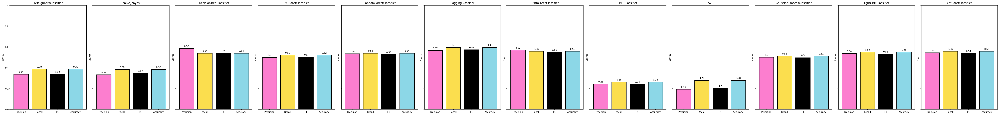

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

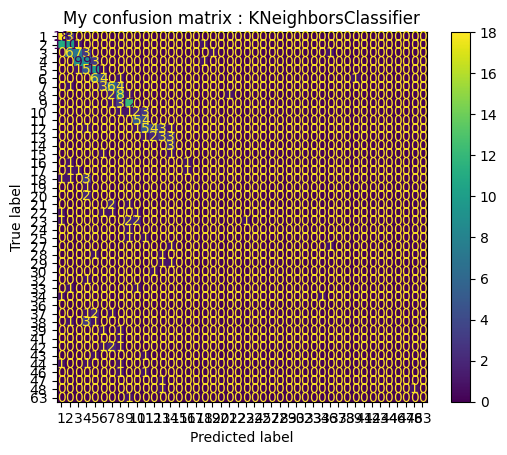

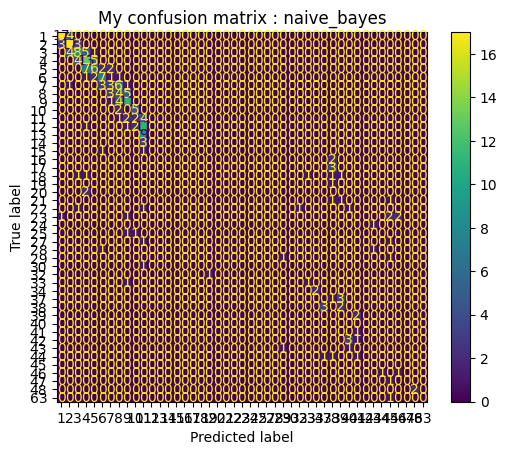

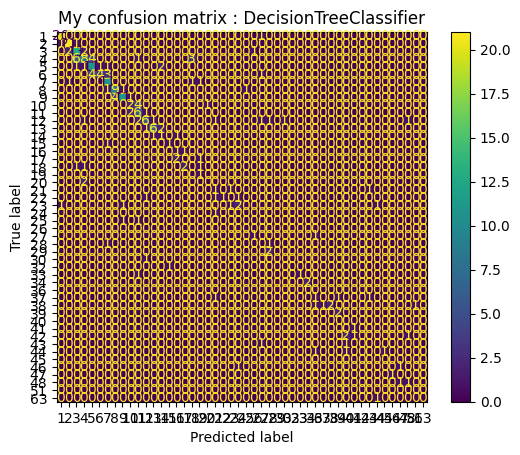

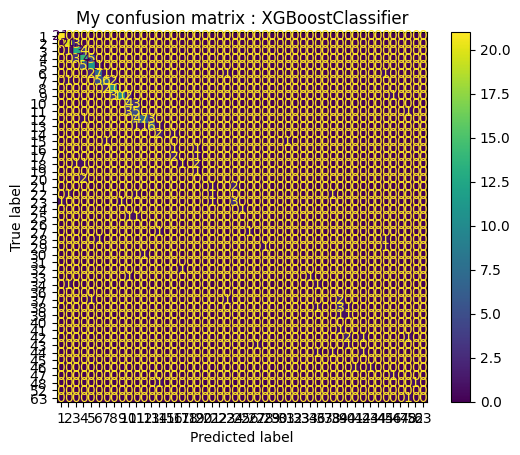

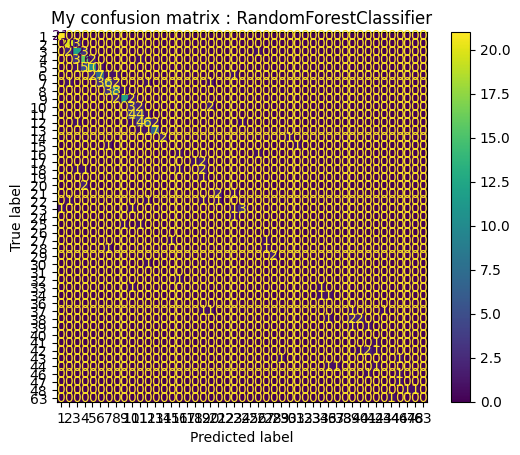

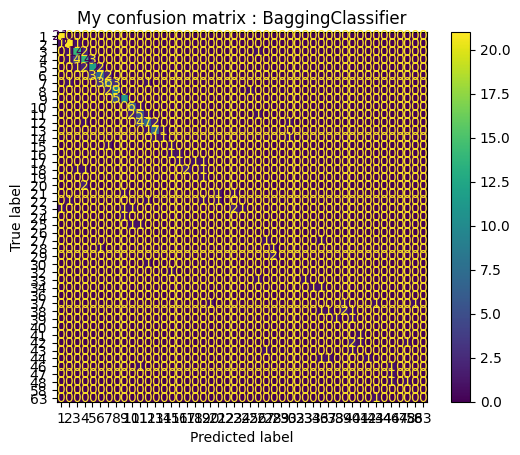

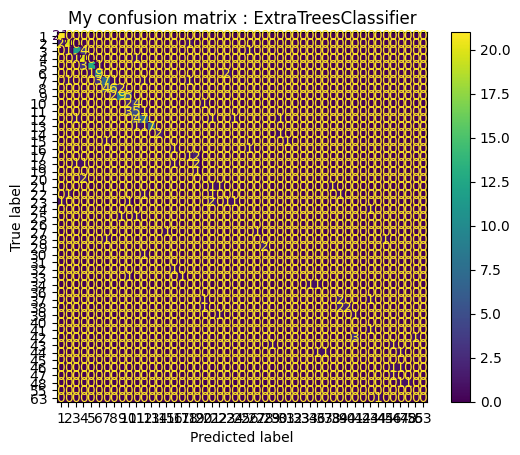

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


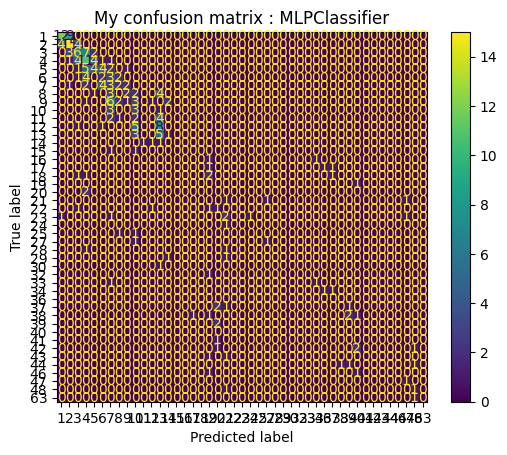

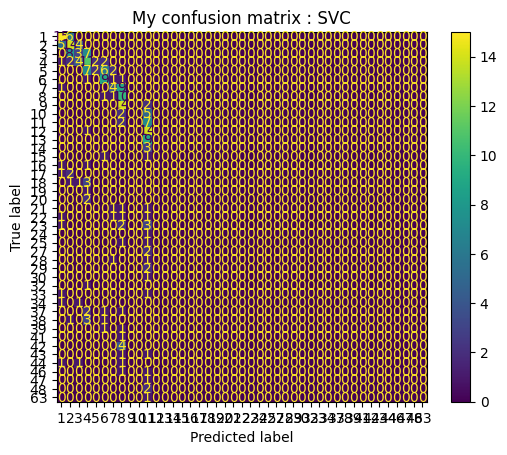

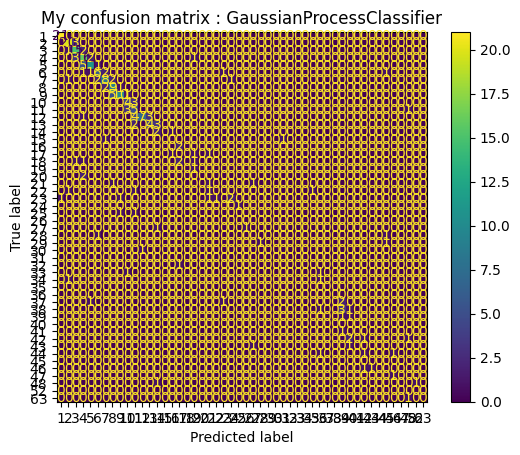

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[LightGBM] [Info] Start training from score -3.391895
[LightGBM] [

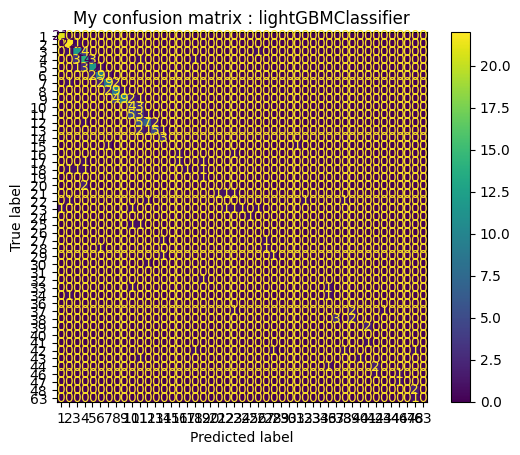

Learning rate set to 0.0794
0:	learn: 3.8639446	total: 36.5ms	remaining: 36.5s
1:	learn: 3.7397573	total: 61.1ms	remaining: 30.5s
2:	learn: 3.6458567	total: 87ms	remaining: 28.9s
3:	learn: 3.4756345	total: 111ms	remaining: 27.5s
4:	learn: 3.2762031	total: 137ms	remaining: 27.2s
5:	learn: 3.1932630	total: 160ms	remaining: 26.5s
6:	learn: 3.0686935	total: 184ms	remaining: 26.1s
7:	learn: 3.0092311	total: 221ms	remaining: 27.4s
8:	learn: 2.9030952	total: 244ms	remaining: 26.9s
9:	learn: 2.8204160	total: 253ms	remaining: 25s
10:	learn: 2.7632587	total: 276ms	remaining: 24.8s
11:	learn: 2.6971751	total: 300ms	remaining: 24.7s
12:	learn: 2.6249564	total: 325ms	remaining: 24.7s
13:	learn: 2.5727129	total: 348ms	remaining: 24.5s
14:	learn: 2.5335104	total: 372ms	remaining: 24.4s
15:	learn: 2.4933956	total: 410ms	remaining: 25.2s
16:	learn: 2.4523897	total: 445ms	remaining: 25.7s
17:	learn: 2.4073244	total: 472ms	remaining: 25.8s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2.3

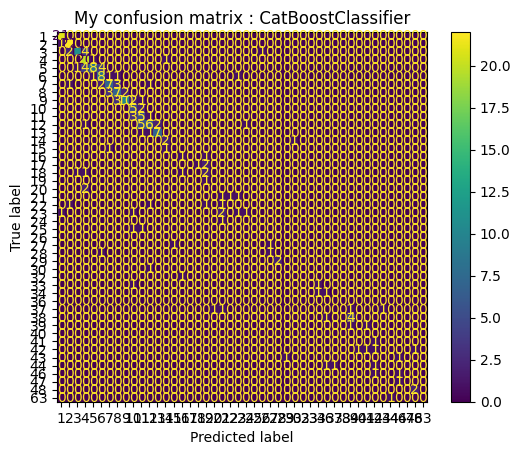

In [ ]:
for model,model_name in model_class:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_test = np.array(y_test)

    #หาค่า unique labels จากการรวม y_test และ y_pred
    unique_labels = np.unique(np.concatenate((y_test, y_pred), axis=None))
    labels = [str(label) for label in unique_labels]

    #คำนวณค่า Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot()

    #ใส่ชื่อตามชื่อของโมเดล
    plt.title("My confusion matrix : "+model_name)

    #แสดงผลกราฟ Confusion Matrix
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X_train, y_train)

  #Predict Model
  y_pred = model.predict(X_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000133 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000035 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 38.1ms	remaining: 38s
1:	learn: 3.7699887	total: 66.2ms	remaining: 33s
2:	learn: 3.6374395	total: 93ms	remaining: 30.9s
3:	learn: 3.4525588	total: 99.9ms	remaining: 24.9s
4:	learn: 3.3043578	total: 122ms	remaining: 24.3s
5:	learn: 3.1974232	total: 132ms	remaining: 21.8s
6:	learn: 3.1168060	total: 154ms	remaining: 21.8s
7:	learn: 3.0316053	total: 178ms	remaining: 22.1s
8:	learn: 2.9164232	total: 215ms	remaining: 23.7s
9:	learn: 2.8308825	total: 251ms	remaining: 24.9s
10:	learn: 2.7641192	total: 291ms	remaining: 26.2s
11:	learn: 2.7040077	total: 321ms	remaining: 26.4s
12:	learn: 2.6391498	total: 343ms	remaining: 26.1s
13:	learn: 2.5783828	total: 366ms	remaining: 25.8s
14:	learn: 2.5194223	total: 388ms	remaining: 25.5s
15:	learn: 2.4762742	total: 411ms	remaining: 25.3s
16:	learn: 2.4362766	total: 450ms	remaining: 26s
17:	learn: 2.4019272	total: 496ms	remaining: 27.1s
18:	learn: 2.3726398	total: 537ms	remaining: 27.7s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 22.6ms	remaining: 22.6s
1:	learn: 3.6812507	total: 44.4ms	remaining: 22.2s
2:	learn: 3.5943361	total: 66ms	remaining: 21.9s
3:	learn: 3.4173746	total: 74ms	remaining: 18.4s
4:	learn: 3.2722143	total: 98.3ms	remaining: 19.6s
5:	learn: 3.1947988	total: 120ms	remaining: 19.9s
6:	learn: 3.1147909	total: 142ms	remaining: 20.1s
7:	learn: 3.0563794	total: 164ms	remaining: 20.3s
8:	learn: 2.9807241	total: 186ms	remaining: 20.5s
9:	learn: 2.8957365	total: 226ms	remaining: 22.4s
10:	learn: 2.8284835	total: 263ms	remaining: 23.7s
11:	learn: 2.7719337	total: 301ms	remaining: 24.8s
12:	learn: 2.7037490	total: 340ms	remaining: 25.8s
13:	learn: 2.6334962	total: 368ms	remaining: 25.9s
14:	learn: 2.5791356	total: 394ms	remaining: 25.9s
15:	learn: 2.5369880	total: 416ms	remaining: 25.6s
16:	learn: 2.4966701	total: 451ms	remaining: 26.1s
17:	learn: 2.4538217	total: 490ms	remaining: 26.7s
18:	learn: 2.4011134	total: 515ms	remaining: 26.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 53.9ms	remaining: 26.9s
2:	learn: 3.6334421	total: 91.1ms	remaining: 30.3s
3:	learn: 3.4849033	total: 106ms	remaining: 26.3s
4:	learn: 3.3442909	total: 127ms	remaining: 25.3s
5:	learn: 3.2557597	total: 149ms	remaining: 24.7s
6:	learn: 3.1410990	total: 171ms	remaining: 24.2s
7:	learn: 3.0848395	total: 201ms	remaining: 24.9s
8:	learn: 3.0093885	total: 236ms	remaining: 26s
9:	learn: 2.9314518	total: 284ms	remaining: 28.1s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 361ms	remaining: 29.7s
12:	learn: 2.7327315	total: 383ms	remaining: 29s
13:	learn: 2.6843200	total: 405ms	remaining: 28.5s
14:	learn: 2.6309948	total: 427ms	remaining: 28s
15:	learn: 2.5896154	total: 450ms	remaining: 27.7s
16:	learn: 2.5443380	total: 472ms	remaining: 27.3s
17:	learn: 2.5020189	total: 502ms	remaining: 27.4s
18:	learn: 2.4589923	total: 542ms	remaining: 28s
19:	learn: 2.4106644	total: 571ms	remaining: 28s
20:	learn: 2.3709353	total: 593ms	remaining: 27.7s

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8064426	total: 32.5ms	remaining: 32.5s
1:	learn: 3.7095437	total: 65.5ms	remaining: 32.7s
2:	learn: 3.6234020	total: 92.3ms	remaining: 30.7s
3:	learn: 3.5219364	total: 115ms	remaining: 28.6s
4:	learn: 3.3261204	total: 137ms	remaining: 27.2s
5:	learn: 3.2046959	total: 158ms	remaining: 26.2s
6:	learn: 3.1324966	total: 182ms	remaining: 25.8s
7:	learn: 3.0746523	total: 226ms	remaining: 28.1s
8:	learn: 2.9722810	total: 266ms	remaining: 29.3s
9:	learn: 2.8863538	total: 282ms	remaining: 27.9s
10:	learn: 2.8240149	total: 319ms	remaining: 28.7s
11:	learn: 2.7591890	total: 341ms	remaining: 28.1s
12:	learn: 2.6853846	total: 373ms	remaining: 28.4s
13:	learn: 2.6191711	total: 396ms	remaining: 27.9s
14:	learn: 2.5691761	total: 419ms	remaining: 27.5s
15:	learn: 2.5250907	total: 456ms	remaining: 28.1s
16:	learn: 2.4830234	total: 487ms	remaining: 28.2s
17:	learn: 2.4407160	total: 513ms	remaining: 28s
18:	learn: 2.4025737	total: 535ms	remaining: 27.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3322320	total: 108ms	remaining: 21.6s
5:	learn: 3.2643425	total: 148ms	remaining: 24.6s
6:	learn: 3.1809232	total: 184ms	remaining: 26.2s
7:	learn: 3.1211707	total: 223ms	remaining: 27.7s
8:	learn: 3.0450874	total: 257ms	remaining: 28.3s
9:	learn: 2.9612655	total: 279ms	remaining: 27.6s
10:	learn: 2.8920670	total: 300ms	remaining: 27s
11:	learn: 2.8145660	total: 330ms	remaining: 27.2s
12:	learn: 2.7392359	total: 369ms	remaining: 28s
13:	learn: 2.6846049	total: 394ms	remaining: 27.8s
14:	learn: 2.6274903	total: 416ms	remaining: 27.3s
15:	learn: 2.5862957	total: 438ms	remaining: 26.9s
16:	learn: 2.5426484	total: 459ms	remaining: 26.5s
17:	learn: 2.4982743	total: 480ms	remaining: 26.2s
18:	learn: 2.4573390	total: 502ms	remaining: 25.9s
19:	learn: 2.4102792	total: 523ms	remaining: 25.6s
20:	learn: 2.3700533	total: 566ms	remaining: 26.4s
21:	learn: 2.3452094	total: 603ms	remaining: 26.8s
22:	learn: 2.3196629	total: 633ms	remaining: 26.9s
23:	learn: 2.2819446	total: 654ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.7ms	remaining: 22.6s
1:	learn: 3.7484080	total: 45.1ms	remaining: 22.5s
2:	learn: 3.6594905	total: 67.4ms	remaining: 22.4s
3:	learn: 3.4810880	total: 78.4ms	remaining: 19.5s
4:	learn: 3.3331988	total: 111ms	remaining: 22.1s
5:	learn: 3.2592621	total: 133ms	remaining: 22.1s
6:	learn: 3.1544492	total: 156ms	remaining: 22.1s
7:	learn: 3.0923563	total: 178ms	remaining: 22.1s
8:	learn: 3.0187806	total: 217ms	remaining: 23.9s
9:	learn: 2.9371069	total: 256ms	remaining: 25.3s
10:	learn: 2.8695088	total: 293ms	remaining: 26.3s
11:	learn: 2.8133799	total: 330ms	remaining: 27.1s
12:	learn: 2.7372023	total: 359ms	remaining: 27.3s
13:	learn: 2.6678466	total: 381ms	remaining: 26.8s
14:	learn: 2.6137397	total: 403ms	remaining: 26.5s
15:	learn: 2.5615789	total: 432ms	remaining: 26.6s
16:	learn: 2.5207092	total: 471ms	remaining: 27.2s
17:	learn: 2.4795757	total: 502ms	remaining: 27.4s
18:	learn: 2.4402746	total: 525ms	remaining: 27.1s
19:	lea

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3411053	total: 106ms	remaining: 21.1s
5:	learn: 3.2449077	total: 141ms	remaining: 23.4s
6:	learn: 3.1621918	total: 173ms	remaining: 24.5s
7:	learn: 3.1034455	total: 200ms	remaining: 24.8s
8:	learn: 2.9965094	total: 234ms	remaining: 25.7s
9:	learn: 2.9180163	total: 265ms	remaining: 26.3s
10:	learn: 2.8470785	total: 287ms	remaining: 25.8s
11:	learn: 2.7752889	total: 312ms	remaining: 25.7s
12:	learn: 2.7037633	total: 343ms	remaining: 26.1s
13:	learn: 2.6674419	total: 379ms	remaining: 26.7s
14:	learn: 2.6170536	total: 402ms	remaining: 26.4s
15:	learn: 2.5754001	total: 423ms	remaining: 26s
16:	learn: 2.5307902	total: 459ms	remaining: 26.5s
17:	learn: 2.4925670	total: 490ms	remaining: 26.8s
18:	learn: 2.4529037	total: 539ms	remaining: 27.8s
19:	learn: 2.4058253	total: 577ms	remaining: 28.3s
20:	learn: 2.3778239	total: 620ms	remaining: 28.9s
21:	learn: 2.3530449	total: 657ms	remaining: 29.2s
22:	learn: 2.3276181	total: 693ms	remaining: 29.4s
23:	learn: 2.2887251	total: 727ms	remai

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8381744	total: 34.7ms	remaining: 34.7s
1:	learn: 3.7004105	total: 69.9ms	remaining: 34.9s
2:	learn: 3.6104702	total: 104ms	remaining: 34.6s
3:	learn: 3.4342228	total: 111ms	remaining: 27.6s
4:	learn: 3.2911717	total: 132ms	remaining: 26.3s
5:	learn: 3.1853531	total: 141ms	remaining: 23.4s
6:	learn: 3.0793088	total: 163ms	remaining: 23.1s
7:	learn: 2.9817558	total: 185ms	remaining: 23s
8:	learn: 2.9069319	total: 228ms	remaining: 25.1s
9:	learn: 2.8229469	total: 266ms	remaining: 26.3s
10:	learn: 2.7578803	total: 302ms	remaining: 27.2s
11:	learn: 2.6971236	total: 339ms	remaining: 27.9s
12:	learn: 2.6305608	total: 361ms	remaining: 27.4s
13:	learn: 2.5662315	total: 397ms	remaining: 28s
14:	learn: 2.5042711	total: 427ms	remaining: 28.1s
15:	learn: 2.4615175	total: 462ms	remaining: 28.4s
16:	learn: 2.4086955	total: 501ms	remaining: 29s
17:	learn: 2.3754565	total: 563ms	remaining: 30.7s
18:	learn: 2.3465780	total: 611ms	remaining: 31.5s
19:	learn: 2.3213413	total: 653ms	remaining: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8480707	total: 47.8ms	remaining: 47.8s
1:	learn: 3.7115540	total: 106ms	remaining: 53s
2:	learn: 3.6234599	total: 160ms	remaining: 53.1s
3:	learn: 3.4455719	total: 175ms	remaining: 43.6s
4:	learn: 3.3004163	total: 219ms	remaining: 43.6s
5:	learn: 3.2153645	total: 266ms	remaining: 44.1s
6:	learn: 3.1139272	total: 311ms	remaining: 44s
7:	learn: 3.0567616	total: 354ms	remaining: 43.8s
8:	learn: 2.9830415	total: 397ms	remaining: 43.7s
9:	learn: 2.9030401	total: 441ms	remaining: 43.7s
10:	learn: 2.8363418	total: 487ms	remaining: 43.8s
11:	learn: 2.7784608	total: 529ms	remaining: 43.5s
12:	learn: 2.7119909	total: 574ms	remaining: 43.6s
13:	learn: 2.6411087	total: 628ms	remaining: 44.2s
14:	learn: 2.5881612	total: 675ms	remaining: 44.4s
15:	learn: 2.5343530	total: 725ms	remaining: 44.6s
16:	learn: 2.4885762	total: 772ms	remaining: 44.7s
17:	learn: 2.4427486	total: 812ms	remaining: 44.3s
18:	learn: 2.4027594	total: 863ms	remaining: 44.6s
19:	learn: 2.3559613	total: 914ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8682283	total: 41ms	remaining: 40.9s
1:	learn: 3.7300207	total: 78.6ms	remaining: 39.2s
2:	learn: 3.6436920	total: 117ms	remaining: 38.9s
3:	learn: 3.4961195	total: 133ms	remaining: 33.1s
4:	learn: 3.3991806	total: 182ms	remaining: 36.3s
5:	learn: 3.3201834	total: 239ms	remaining: 39.6s
6:	learn: 3.2351281	total: 294ms	remaining: 41.7s
7:	learn: 3.1767200	total: 357ms	remaining: 44.2s
8:	learn: 3.0617868	total: 400ms	remaining: 44.1s
9:	learn: 2.9782887	total: 445ms	remaining: 44.1s
10:	learn: 2.8993493	total: 497ms	remaining: 44.7s
11:	learn: 2.8252658	total: 545ms	remaining: 44.9s
12:	learn: 2.7444908	total: 588ms	remaining: 44.6s
13:	learn: 2.6702937	total: 621ms	remaining: 43.7s
14:	learn: 2.6138347	total: 673ms	remaining: 44.2s
15:	learn: 2.5591252	total: 722ms	remaining: 44.4s
16:	learn: 2.5154962	total: 775ms	remaining: 44.8s
17:	learn: 2.4740075	total: 821ms	remaining: 44.8s
18:	learn: 2.4343606	total: 862ms	remaining: 44.5s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 44.8ms	remaining: 44.8s
1:	learn: 3.7699887	total: 89.5ms	remaining: 44.7s
2:	learn: 3.6374395	total: 120ms	remaining: 40s
3:	learn: 3.4525588	total: 127ms	remaining: 31.7s
4:	learn: 3.3043578	total: 150ms	remaining: 29.8s
5:	learn: 3.1974232	total: 169ms	remaining: 27.9s
6:	learn: 3.1168060	total: 214ms	remaining: 30.4s
7:	learn: 3.0316053	total: 255ms	remaining: 31.6s
8:	learn: 2.9164232	total: 296ms	remaining: 32.6s
9:	learn: 2.8308825	total: 335ms	remaining: 33.1s
10:	learn: 2.7641192	total: 356ms	remaining: 32s
11:	learn: 2.7040077	total: 378ms	remaining: 31.2s
12:	learn: 2.6391498	total: 401ms	remaining: 30.5s
13:	learn: 2.5783828	total: 439ms	remaining: 30.9s
14:	learn: 2.5194223	total: 471ms	remaining: 30.9s
15:	learn: 2.4762742	total: 506ms	remaining: 31.1s
16:	learn: 2.4362766	total: 529ms	remaining: 30.6s
17:	learn: 2.4019272	total: 551ms	remaining: 30s
18:	learn: 2.3726398	total: 573ms	remaining: 29.6s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 35.3ms	remaining: 35.3s
1:	learn: 3.6812507	total: 58.8ms	remaining: 29.4s
2:	learn: 3.5943361	total: 81.6ms	remaining: 27.1s
3:	learn: 3.4173746	total: 91.5ms	remaining: 22.8s
4:	learn: 3.2722143	total: 113ms	remaining: 22.5s
5:	learn: 3.1947988	total: 145ms	remaining: 24.1s
6:	learn: 3.1147909	total: 167ms	remaining: 23.7s
7:	learn: 3.0563794	total: 205ms	remaining: 25.4s
8:	learn: 2.9807241	total: 243ms	remaining: 26.7s
9:	learn: 2.8957365	total: 279ms	remaining: 27.6s
10:	learn: 2.8284835	total: 312ms	remaining: 28s
11:	learn: 2.7719337	total: 350ms	remaining: 28.8s
12:	learn: 2.7037490	total: 378ms	remaining: 28.7s
13:	learn: 2.6334962	total: 400ms	remaining: 28.1s
14:	learn: 2.5791356	total: 441ms	remaining: 28.9s
15:	learn: 2.5369880	total: 473ms	remaining: 29.1s
16:	learn: 2.4966701	total: 499ms	remaining: 28.9s
17:	learn: 2.4538217	total: 521ms	remaining: 28.4s
18:	learn: 2.4011134	total: 542ms	remaining: 28s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 60.4ms	remaining: 30.1s
2:	learn: 3.6334421	total: 97.2ms	remaining: 32.3s
3:	learn: 3.4849033	total: 113ms	remaining: 28.1s
4:	learn: 3.3442909	total: 135ms	remaining: 26.8s
5:	learn: 3.2557597	total: 157ms	remaining: 26.1s
6:	learn: 3.1410990	total: 179ms	remaining: 25.4s
7:	learn: 3.0848395	total: 215ms	remaining: 26.6s
8:	learn: 3.0093885	total: 259ms	remaining: 28.5s
9:	learn: 2.9314518	total: 296ms	remaining: 29.3s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 372ms	remaining: 30.6s
12:	learn: 2.7327315	total: 395ms	remaining: 30s
13:	learn: 2.6843200	total: 418ms	remaining: 29.5s
14:	learn: 2.6309948	total: 442ms	remaining: 29s
15:	learn: 2.5896154	total: 475ms	remaining: 29.2s
16:	learn: 2.5443380	total: 507ms	remaining: 29.3s
17:	learn: 2.5020189	total: 545ms	remaining: 29.8s
18:	learn: 2.4589923	total: 569ms	remaining: 29.4s
19:	learn: 2.4106644	total: 591ms	remaining: 28.9s
20:	learn: 2.3709353	total: 612ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8064426	total: 42ms	remaining: 41.9s
1:	learn: 3.7095437	total: 75.2ms	remaining: 37.5s
2:	learn: 3.6234020	total: 106ms	remaining: 35.1s
3:	learn: 3.5219364	total: 128ms	remaining: 31.9s
4:	learn: 3.3261204	total: 150ms	remaining: 29.8s
5:	learn: 3.2046959	total: 171ms	remaining: 28.4s
6:	learn: 3.1324966	total: 200ms	remaining: 28.4s
7:	learn: 3.0746523	total: 237ms	remaining: 29.4s
8:	learn: 2.9722810	total: 278ms	remaining: 30.6s
9:	learn: 2.8863538	total: 290ms	remaining: 28.7s
10:	learn: 2.8240149	total: 326ms	remaining: 29.3s
11:	learn: 2.7591890	total: 356ms	remaining: 29.3s
12:	learn: 2.6853846	total: 378ms	remaining: 28.7s
13:	learn: 2.6191711	total: 400ms	remaining: 28.1s
14:	learn: 2.5691761	total: 422ms	remaining: 27.7s
15:	learn: 2.5250907	total: 444ms	remaining: 27.3s
16:	learn: 2.4830234	total: 466ms	remaining: 26.9s
17:	learn: 2.4407160	total: 502ms	remaining: 27.4s
18:	learn: 2.4025737	total: 549ms	remaining: 28.4s
19:	learn: 2.3586694	total: 581ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2:	learn: 3.6613275	total: 73.1ms	remaining: 24.3s
3:	learn: 3.4796160	total: 89ms	remaining: 22.2s
4:	learn: 3.3322320	total: 128ms	remaining: 25.4s
5:	learn: 3.2643425	total: 156ms	remaining: 25.8s
6:	learn: 3.1809232	total: 178ms	remaining: 25.3s
7:	learn: 3.1211707	total: 215ms	remaining: 26.6s
8:	learn: 3.0450874	total: 246ms	remaining: 27.1s
9:	learn: 2.9612655	total: 283ms	remaining: 28s
10:	learn: 2.8920670	total: 315ms	remaining: 28.3s
11:	learn: 2.8145660	total: 351ms	remaining: 28.9s
12:	learn: 2.7392359	total: 384ms	remaining: 29.2s
13:	learn: 2.6846049	total: 418ms	remaining: 29.4s
14:	learn: 2.6274903	total: 439ms	remaining: 28.8s
15:	learn: 2.5862957	total: 461ms	remaining: 28.4s
16:	learn: 2.5426484	total: 486ms	remaining: 28.1s
17:	learn: 2.4982743	total: 522ms	remaining: 28.5s
18:	learn: 2.4573390	total: 555ms	remaining: 28.7s
19:	learn: 2.4102792	total: 587ms	remaining: 28.8s
20:	learn: 2.3700533	total: 609ms	remaining: 28.4s
21:	learn: 2.3452094	total: 631ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.3ms	remaining: 22.3s
1:	learn: 3.7484080	total: 48.1ms	remaining: 24s
2:	learn: 3.6594905	total: 80ms	remaining: 26.6s
3:	learn: 3.4810880	total: 87.4ms	remaining: 21.8s
4:	learn: 3.3331988	total: 113ms	remaining: 22.5s
5:	learn: 3.2592621	total: 135ms	remaining: 22.4s
6:	learn: 3.1544492	total: 157ms	remaining: 22.3s
7:	learn: 3.0923563	total: 180ms	remaining: 22.3s
8:	learn: 3.0187806	total: 214ms	remaining: 23.5s
9:	learn: 2.9371069	total: 253ms	remaining: 25.1s
10:	learn: 2.8695088	total: 295ms	remaining: 26.5s
11:	learn: 2.8133799	total: 336ms	remaining: 27.6s
12:	learn: 2.7372023	total: 362ms	remaining: 27.5s
13:	learn: 2.6678466	total: 384ms	remaining: 27.1s
14:	learn: 2.6137397	total: 406ms	remaining: 26.7s
15:	learn: 2.5615789	total: 441ms	remaining: 27.1s
16:	learn: 2.5207092	total: 479ms	remaining: 27.7s
17:	learn: 2.4795757	total: 506ms	remaining: 27.6s
18:	learn: 2.4402746	total: 528ms	remaining: 27.3s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8344131	total: 29.8ms	remaining: 29.8s
1:	learn: 3.6971313	total: 51.4ms	remaining: 25.7s
2:	learn: 3.6103653	total: 73.3ms	remaining: 24.4s
3:	learn: 3.4367733	total: 80.2ms	remaining: 20s
4:	learn: 3.3411053	total: 104ms	remaining: 20.8s
5:	learn: 3.2449077	total: 126ms	remaining: 20.8s
6:	learn: 3.1621918	total: 148ms	remaining: 21s
7:	learn: 3.1034455	total: 170ms	remaining: 21s
8:	learn: 2.9965094	total: 203ms	remaining: 22.4s
9:	learn: 2.9180163	total: 241ms	remaining: 23.9s
10:	learn: 2.8470785	total: 281ms	remaining: 25.3s
11:	learn: 2.7752889	total: 317ms	remaining: 26.1s
12:	learn: 2.7037633	total: 349ms	remaining: 26.5s
13:	learn: 2.6674419	total: 371ms	remaining: 26.1s
14:	learn: 2.6170536	total: 392ms	remaining: 25.8s
15:	learn: 2.5754001	total: 424ms	remaining: 26.1s
16:	learn: 2.5307902	total: 463ms	remaining: 26.7s
17:	learn: 2.4925670	total: 502ms	remaining: 27.4s
18:	learn: 2.4529037	total: 530ms	remaining: 27.3s
19:	learn: 2.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8381744	total: 22.6ms	remaining: 22.6s
1:	learn: 3.7004105	total: 44.5ms	remaining: 22.2s
2:	learn: 3.6104702	total: 66.5ms	remaining: 22.1s
3:	learn: 3.4342228	total: 74.8ms	remaining: 18.6s
4:	learn: 3.2911717	total: 99.9ms	remaining: 19.9s
5:	learn: 3.1853531	total: 109ms	remaining: 18.1s
6:	learn: 3.0793088	total: 132ms	remaining: 18.7s
7:	learn: 2.9817558	total: 153ms	remaining: 19s
8:	learn: 2.9069319	total: 176ms	remaining: 19.4s
9:	learn: 2.8229469	total: 216ms	remaining: 21.4s
10:	learn: 2.7578803	total: 246ms	remaining: 22.1s
11:	learn: 2.6971236	total: 285ms	remaining: 23.5s
12:	learn: 2.6305608	total: 322ms	remaining: 24.4s
13:	learn: 2.5662315	total: 357ms	remaining: 25.2s
14:	learn: 2.5042711	total: 382ms	remaining: 25.1s
15:	learn: 2.4615175	total: 404ms	remaining: 24.8s
16:	learn: 2.4086955	total: 439ms	remaining: 25.4s
17:	learn: 2.3754565	total: 478ms	remaining: 26.1s
18:	learn: 2.3465780	total: 509ms	remaining: 26.3s
19:	lear

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8480707	total: 23.7ms	remaining: 23.6s
1:	learn: 3.7115540	total: 46.8ms	remaining: 23.4s
2:	learn: 3.6234599	total: 70.7ms	remaining: 23.5s
3:	learn: 3.4455719	total: 78.9ms	remaining: 19.6s
4:	learn: 3.3004163	total: 106ms	remaining: 21.1s
5:	learn: 3.2153645	total: 128ms	remaining: 21.2s
6:	learn: 3.1139272	total: 150ms	remaining: 21.2s
7:	learn: 3.0567616	total: 172ms	remaining: 21.3s
8:	learn: 2.9830415	total: 207ms	remaining: 22.8s
9:	learn: 2.9030401	total: 251ms	remaining: 24.9s
10:	learn: 2.8363418	total: 293ms	remaining: 26.3s
11:	learn: 2.7784608	total: 329ms	remaining: 27.1s
12:	learn: 2.7119909	total: 366ms	remaining: 27.8s
13:	learn: 2.6411087	total: 395ms	remaining: 27.8s
14:	learn: 2.5881612	total: 430ms	remaining: 28.2s
15:	learn: 2.5343530	total: 467ms	remaining: 28.7s
16:	learn: 2.4885762	total: 498ms	remaining: 28.8s
17:	learn: 2.4427486	total: 520ms	remaining: 28.4s
18:	learn: 2.4027594	total: 541ms	remaining: 28s
19:	learn

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
4:	learn: 3.3322320	total: 102ms	remaining: 20.3s
5:	learn: 3.2643425	total: 124ms	remaining: 20.5s
6:	learn: 3.1809232	total: 146ms	remaining: 20.7s
7:	learn: 3.1211707	total: 167ms	remaining: 20.8s
8:	learn: 3.0450874	total: 191ms	remaining: 21.1s
9:	learn: 2.9612655	total: 229ms	remaining: 22.6s
10:	learn: 2.8920670	total: 260ms	remaining: 23.4s
11:	learn: 2.8145660	total: 291ms	remaining: 24s
12:	learn: 2.7392359	total: 316ms	remaining: 24s
13:	learn: 2.6846049	total: 337ms	remaining: 23.7s
14:	learn: 2.6274903	total: 359ms	remaining: 23.5s
15:	learn: 2.5862957	total: 381ms	remaining: 23.4s
16:	learn: 2.5426484	total: 403ms	remaining: 23.3s
17:	learn: 2.4982743	total: 425ms	remaining: 23.2s
18:	learn: 2.4573390	total: 465ms	remaining: 24s
19:	learn: 2.4102792	total: 502ms	remaining: 24.6s
20:	learn: 2.3700533	total: 531ms	remaining: 24.8s
21:	learn: 2.3452094	total: 553ms	remaining: 24.6s
22:	learn: 2.3196629	total: 575ms	remaining

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_cross_4000.csv', index = False, header = True)

### **Delete Outlier**

#### **Convert Data**

In [ ]:
#ข้อมูลที่ตัด outlier
cutoutlier

In [ ]:
#แบ่งช่วงข้อมูลที่ delete outliner
cutoutlier['Class'] = pd.cut(cutoutlier['charges'], bins=range(0, int(cutoutlier['charges'].max()) + 4001, 4000), labels=False)

In [ ]:
#สร้างตัวแปร X1 และ y1
y1 = cutoutlier["Class"]
X1 = cutoutlier.iloc[:,:6].copy()

#แบ่งข้อมูลสำหรับ Train และ Test
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X1_train, y1_train)

    #Predict Model
    y1_pred = model.predict(X1_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y1_test, y1_pred, average='weighted')
    recall = recall_score(y1_test, y1_pred, average='weighted')
    f1 = f1_score(y1_test, y1_pred, average='weighted')
    accuracy = accuracy_score(y1_test, y1_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy', 'classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_4000.csv', index = False, header = True)

####**Barchart**

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block ที่เราแบ่งไว้
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

In [ ]:
#นับ class ที่แบ่งว่ามีทั้งหมดที่กลุ่ม
cutoutlier['Class'].value_counts().count()

In [ ]:
#ทำ loop เพื่อ fit model และ ทำ croos validation ออกมาทุก model
for model,model_name in model_class:
    model.fit(X1_train, y1_train)
    y1_pred = model.predict(X1_test)
    y1_test = np.array(y1_test)

    unique1_labels = np.unique(np.concatenate((y1_test, y1_pred), axis=None))
    labels1 = [str(label) for label in unique1_labels]

    cm1 = confusion_matrix(y1_test, y1_pred)
    disp1 = ConfusionMatrixDisplay(confusion_matrix=cm1, display_labels=labels1)
    disp1.plot()
    plt.title("My confusion matrix : "+model_name)
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X1_train, y1_train)

  #Predict Model
  y1_pred = model.predict(X1_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_cross_4000.csv', index = False, header = True)

## **5000 per range**


### **Original**

#### **Convert Data**

In [ ]:
#แบ่งข้อมูลเป็นช่วงละ 1000 แล้วเก็บไว้ในตัวแปร Class
df['Class'] = pd.cut(df['charges'], bins=range(0, int(df['charges'].max()) + 5001, 5000), labels=False)

In [ ]:
#สร้างตัวแปร X และ y
X = df.iloc[:,:6]
y = df['Class']

#แบ่งข้อมูลสำหรับ Train และ Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X_train, y_train)

    #Predict Model
    y_pred = model.predict(X_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    accuracy = accuracy_score(y_test, y_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.0794
0:	learn: 3.8639446	total: 29.6ms	remaining: 29.5s
1:	learn: 3.7397573	total: 54.2ms	remaining: 27.1s
2:	learn: 3.6458567	total: 79.3ms	remaining: 26.3s
3:	learn: 3.4756345	total: 104ms	remaining: 26s
4:	learn: 3.2762031	total: 129ms	remaining: 25.6s
5:	learn: 3.1932630	total: 156ms	remaining: 25.9s
6:	learn: 3.0686935	total: 187ms	remaining: 26.6s
7:	learn: 3.0092311	total: 232ms	remaining: 28.8s
8:	learn: 2.9030952	total: 257ms	remaining: 28.3s
9:	learn: 2.8204160	total: 265ms	remaining: 26.2s
10:	learn: 2.7632587	total: 288ms	remaining: 25.9s
11:	learn: 2.6971751	total: 312ms	remaining: 25.7s
12:	learn: 2.6249564	total: 336ms	remaining: 25.5s
13:	learn: 2.5727129	total: 361ms	remaining: 25.4s
14:	learn: 2.5335104	total: 387ms	remaining: 25.4s
15:	learn: 2.4933956	total: 411ms	remaining: 25.3s
16:	learn: 2.4523897	total: 444ms	remaining: 25.7s
17:	learn: 2.4073244	total: 469ms	remaining: 25.6s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_5000.csv', index = False, header = True)

####**Barchart**

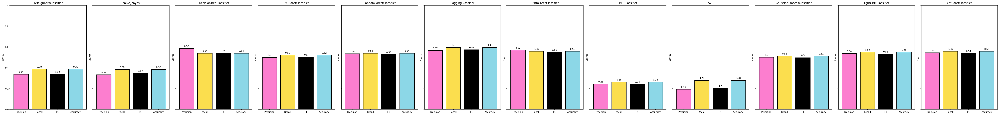

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

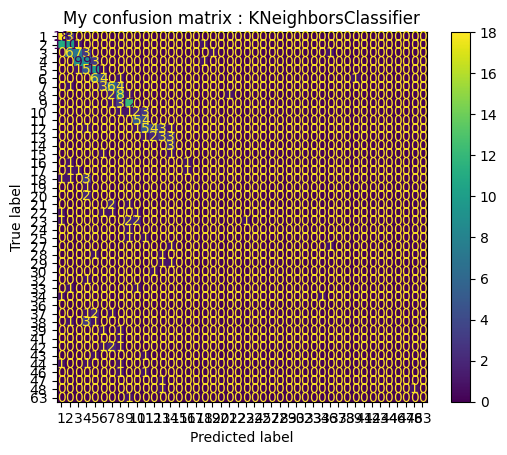

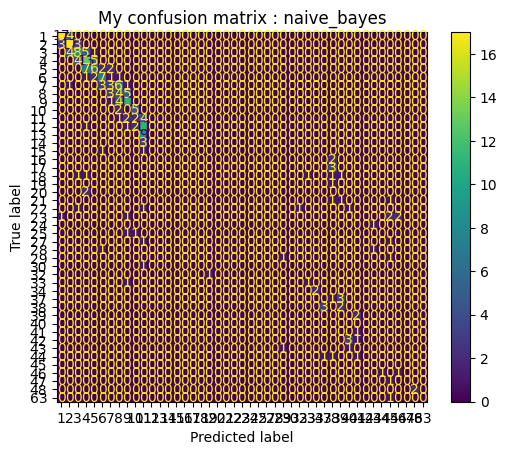

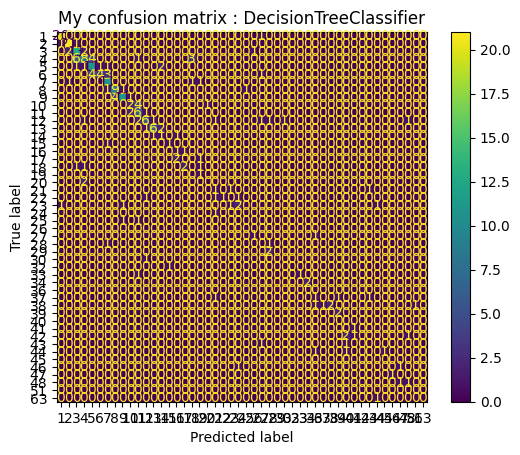

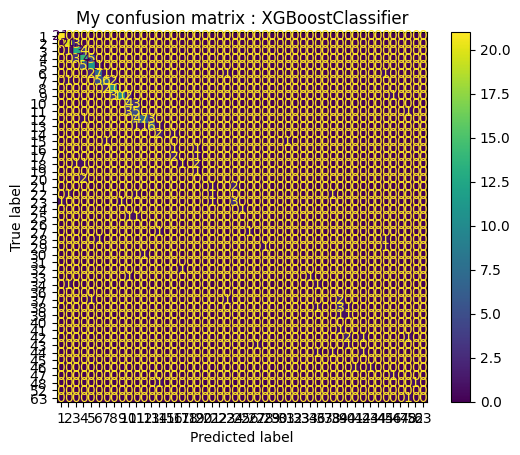

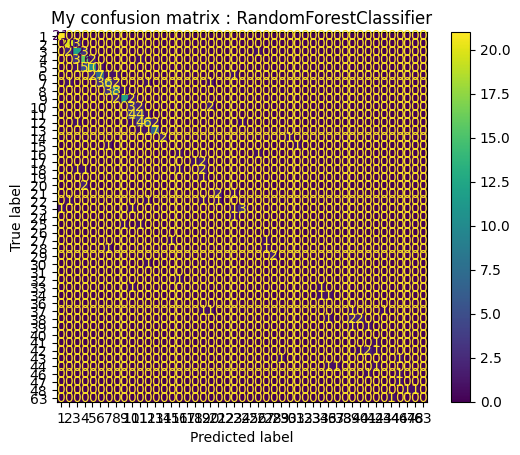

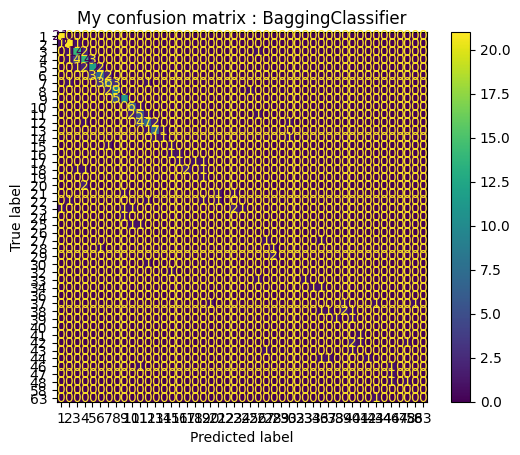

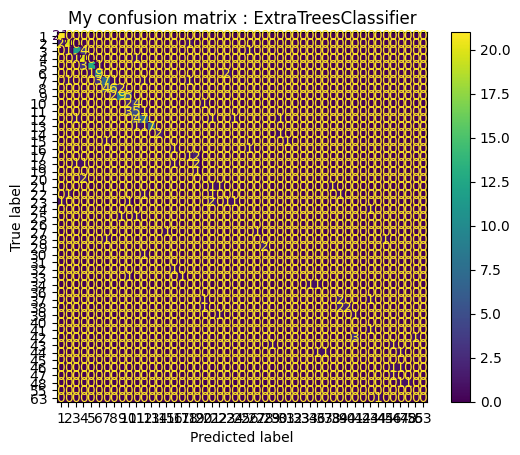

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


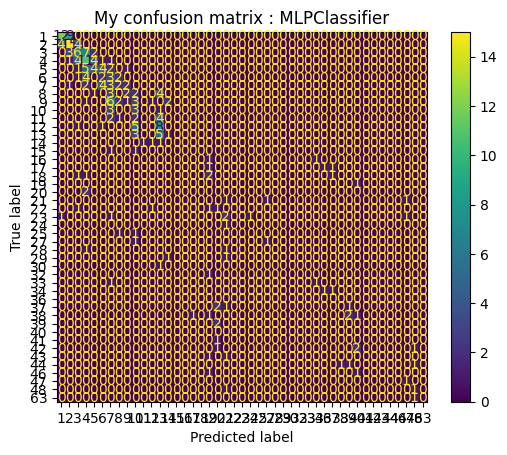

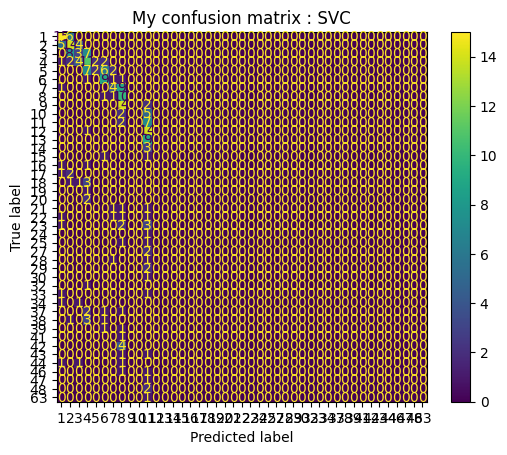

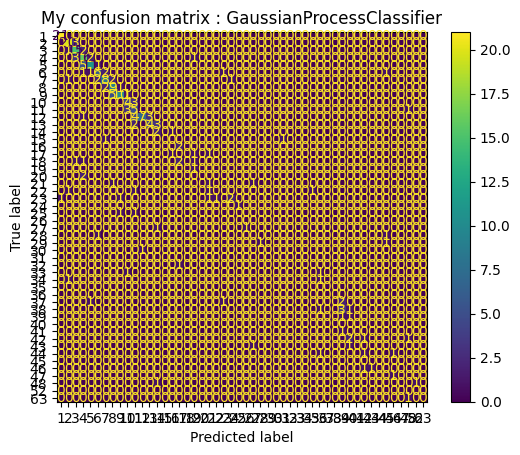

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[LightGBM] [Info] Start training from score -3.391895
[LightGBM] [

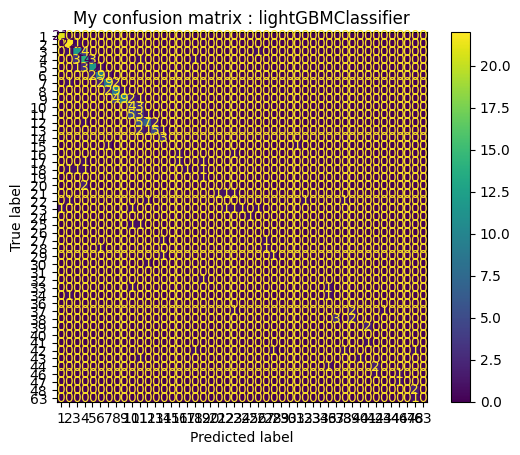

Learning rate set to 0.0794
0:	learn: 3.8639446	total: 36.5ms	remaining: 36.5s
1:	learn: 3.7397573	total: 61.1ms	remaining: 30.5s
2:	learn: 3.6458567	total: 87ms	remaining: 28.9s
3:	learn: 3.4756345	total: 111ms	remaining: 27.5s
4:	learn: 3.2762031	total: 137ms	remaining: 27.2s
5:	learn: 3.1932630	total: 160ms	remaining: 26.5s
6:	learn: 3.0686935	total: 184ms	remaining: 26.1s
7:	learn: 3.0092311	total: 221ms	remaining: 27.4s
8:	learn: 2.9030952	total: 244ms	remaining: 26.9s
9:	learn: 2.8204160	total: 253ms	remaining: 25s
10:	learn: 2.7632587	total: 276ms	remaining: 24.8s
11:	learn: 2.6971751	total: 300ms	remaining: 24.7s
12:	learn: 2.6249564	total: 325ms	remaining: 24.7s
13:	learn: 2.5727129	total: 348ms	remaining: 24.5s
14:	learn: 2.5335104	total: 372ms	remaining: 24.4s
15:	learn: 2.4933956	total: 410ms	remaining: 25.2s
16:	learn: 2.4523897	total: 445ms	remaining: 25.7s
17:	learn: 2.4073244	total: 472ms	remaining: 25.8s
18:	learn: 2.3698757	total: 496ms	remaining: 25.6s
19:	learn: 2.3

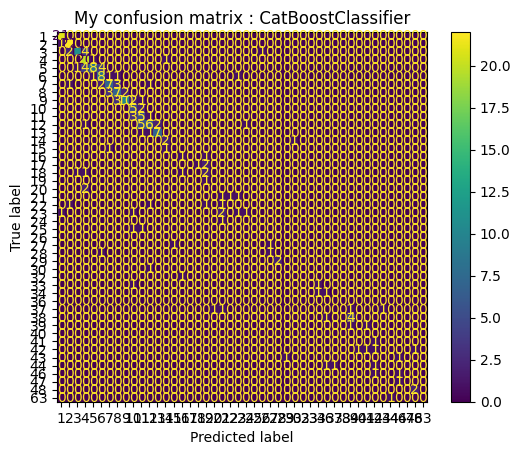

In [ ]:
for model,model_name in model_class:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_test = np.array(y_test)

    #หาค่า unique labels จากการรวม y_test และ y_pred
    unique_labels = np.unique(np.concatenate((y_test, y_pred), axis=None))
    labels = [str(label) for label in unique_labels]

    #คำนวณค่า Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot()

    #ใส่ชื่อตามชื่อของโมเดล
    plt.title("My confusion matrix : "+model_name)

    #แสดงผลกราฟ Confusion Matrix
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X_train, y_train)

  #Predict Model
  y_pred = model.predict(X_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 6
[LightGBM] [Info] Start training from score -2.712734
[LightGBM] [Info] Start training from score -2.644681
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.755906
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.864540
[LightGBM] [Info] Start training from score -2.986430
[LightGBM] [Info] Start training from score -2.785759
[LightGBM] [Info] Start training from score -3.104213
[LightGBM] [Info] Start training from score -3.005122
[LightGBM] [Info] Start training from score -2.801027
[LightGBM] [Info] Start training from score -3.237744
[L

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000133 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000035 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.206492
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.711170
[LightGBM] [Info] Start training from score -2.607374
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.502758
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.726919
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.181174
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.259135
[LightGBM] [Info] Start training from score -3.343693
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -2.978233
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.156481
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.742919
[LightGBM] [Info] Start training from score -2.579594
[LightGBM] [Info] Start training from score -2.881069
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -3.132384
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.232467
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.827002
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.899761
[LightGBM] [Info] Start training from score -2.938228
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.680399
[LightGBM] [Info] Start training from score -2.635947
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.862720
[LightGBM] [Info] Start training from score -2.998852
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.085864
[LightGBM] [Info] Start training from score -3.108853
[LightGBM] [Info] Start training from score -2.775709
[LightGBM] [Info] Start training from score -3.232467
[LightGBM] [Info] Start training from score -3.468856
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 319
[LightGBM] [Info] Number of data points in the train set: 963, number of used features: 6
[LightGBM] [Info] Start training from score -2.695666
[LightGBM] [Info] Start training from score -2.665361
[LightGBM] [Info] Start training from score -2.918810
[LightGBM] [Info] Start training from score -2.792516
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.844702
[LightGBM] [Info] Start training from score -3.041412
[LightGBM] [Info] Start training from score -2.759180
[LightGBM] [Info] Start training from score -3.063391
[LightGBM] [Info] Start training from score -2.958030
[LightGBM] [Info] Start training from score -2.809610
[LightGBM] [Info] Start training from score -3.314705
[LightGBM] [Info] Start training from score -3.373546
[LightGBM] [I

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 38.1ms	remaining: 38s
1:	learn: 3.7699887	total: 66.2ms	remaining: 33s
2:	learn: 3.6374395	total: 93ms	remaining: 30.9s
3:	learn: 3.4525588	total: 99.9ms	remaining: 24.9s
4:	learn: 3.3043578	total: 122ms	remaining: 24.3s
5:	learn: 3.1974232	total: 132ms	remaining: 21.8s
6:	learn: 3.1168060	total: 154ms	remaining: 21.8s
7:	learn: 3.0316053	total: 178ms	remaining: 22.1s
8:	learn: 2.9164232	total: 215ms	remaining: 23.7s
9:	learn: 2.8308825	total: 251ms	remaining: 24.9s
10:	learn: 2.7641192	total: 291ms	remaining: 26.2s
11:	learn: 2.7040077	total: 321ms	remaining: 26.4s
12:	learn: 2.6391498	total: 343ms	remaining: 26.1s
13:	learn: 2.5783828	total: 366ms	remaining: 25.8s
14:	learn: 2.5194223	total: 388ms	remaining: 25.5s
15:	learn: 2.4762742	total: 411ms	remaining: 25.3s
16:	learn: 2.4362766	total: 450ms	remaining: 26s
17:	learn: 2.4019272	total: 496ms	remaining: 27.1s
18:	learn: 2.3726398	total: 537ms	remaining: 27.7s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 22.6ms	remaining: 22.6s
1:	learn: 3.6812507	total: 44.4ms	remaining: 22.2s
2:	learn: 3.5943361	total: 66ms	remaining: 21.9s
3:	learn: 3.4173746	total: 74ms	remaining: 18.4s
4:	learn: 3.2722143	total: 98.3ms	remaining: 19.6s
5:	learn: 3.1947988	total: 120ms	remaining: 19.9s
6:	learn: 3.1147909	total: 142ms	remaining: 20.1s
7:	learn: 3.0563794	total: 164ms	remaining: 20.3s
8:	learn: 2.9807241	total: 186ms	remaining: 20.5s
9:	learn: 2.8957365	total: 226ms	remaining: 22.4s
10:	learn: 2.8284835	total: 263ms	remaining: 23.7s
11:	learn: 2.7719337	total: 301ms	remaining: 24.8s
12:	learn: 2.7037490	total: 340ms	remaining: 25.8s
13:	learn: 2.6334962	total: 368ms	remaining: 25.9s
14:	learn: 2.5791356	total: 394ms	remaining: 25.9s
15:	learn: 2.5369880	total: 416ms	remaining: 25.6s
16:	learn: 2.4966701	total: 451ms	remaining: 26.1s
17:	learn: 2.4538217	total: 490ms	remaining: 26.7s
18:	learn: 2.4011134	total: 515ms	remaining: 26.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 53.9ms	remaining: 26.9s
2:	learn: 3.6334421	total: 91.1ms	remaining: 30.3s
3:	learn: 3.4849033	total: 106ms	remaining: 26.3s
4:	learn: 3.3442909	total: 127ms	remaining: 25.3s
5:	learn: 3.2557597	total: 149ms	remaining: 24.7s
6:	learn: 3.1410990	total: 171ms	remaining: 24.2s
7:	learn: 3.0848395	total: 201ms	remaining: 24.9s
8:	learn: 3.0093885	total: 236ms	remaining: 26s
9:	learn: 2.9314518	total: 284ms	remaining: 28.1s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 361ms	remaining: 29.7s
12:	learn: 2.7327315	total: 383ms	remaining: 29s
13:	learn: 2.6843200	total: 405ms	remaining: 28.5s
14:	learn: 2.6309948	total: 427ms	remaining: 28s
15:	learn: 2.5896154	total: 450ms	remaining: 27.7s
16:	learn: 2.5443380	total: 472ms	remaining: 27.3s
17:	learn: 2.5020189	total: 502ms	remaining: 27.4s
18:	learn: 2.4589923	total: 542ms	remaining: 28s
19:	learn: 2.4106644	total: 571ms	remaining: 28s
20:	learn: 2.3709353	total: 593ms	remaining: 27.7s

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8064426	total: 32.5ms	remaining: 32.5s
1:	learn: 3.7095437	total: 65.5ms	remaining: 32.7s
2:	learn: 3.6234020	total: 92.3ms	remaining: 30.7s
3:	learn: 3.5219364	total: 115ms	remaining: 28.6s
4:	learn: 3.3261204	total: 137ms	remaining: 27.2s
5:	learn: 3.2046959	total: 158ms	remaining: 26.2s
6:	learn: 3.1324966	total: 182ms	remaining: 25.8s
7:	learn: 3.0746523	total: 226ms	remaining: 28.1s
8:	learn: 2.9722810	total: 266ms	remaining: 29.3s
9:	learn: 2.8863538	total: 282ms	remaining: 27.9s
10:	learn: 2.8240149	total: 319ms	remaining: 28.7s
11:	learn: 2.7591890	total: 341ms	remaining: 28.1s
12:	learn: 2.6853846	total: 373ms	remaining: 28.4s
13:	learn: 2.6191711	total: 396ms	remaining: 27.9s
14:	learn: 2.5691761	total: 419ms	remaining: 27.5s
15:	learn: 2.5250907	total: 456ms	remaining: 28.1s
16:	learn: 2.4830234	total: 487ms	remaining: 28.2s
17:	learn: 2.4407160	total: 513ms	remaining: 28s
18:	learn: 2.4025737	total: 535ms	remaining: 27.6s
19:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3322320	total: 108ms	remaining: 21.6s
5:	learn: 3.2643425	total: 148ms	remaining: 24.6s
6:	learn: 3.1809232	total: 184ms	remaining: 26.2s
7:	learn: 3.1211707	total: 223ms	remaining: 27.7s
8:	learn: 3.0450874	total: 257ms	remaining: 28.3s
9:	learn: 2.9612655	total: 279ms	remaining: 27.6s
10:	learn: 2.8920670	total: 300ms	remaining: 27s
11:	learn: 2.8145660	total: 330ms	remaining: 27.2s
12:	learn: 2.7392359	total: 369ms	remaining: 28s
13:	learn: 2.6846049	total: 394ms	remaining: 27.8s
14:	learn: 2.6274903	total: 416ms	remaining: 27.3s
15:	learn: 2.5862957	total: 438ms	remaining: 26.9s
16:	learn: 2.5426484	total: 459ms	remaining: 26.5s
17:	learn: 2.4982743	total: 480ms	remaining: 26.2s
18:	learn: 2.4573390	total: 502ms	remaining: 25.9s
19:	learn: 2.4102792	total: 523ms	remaining: 25.6s
20:	learn: 2.3700533	total: 566ms	remaining: 26.4s
21:	learn: 2.3452094	total: 603ms	remaining: 26.8s
22:	learn: 2.3196629	total: 633ms	remaining: 26.9s
23:	learn: 2.2819446	total: 654ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.7ms	remaining: 22.6s
1:	learn: 3.7484080	total: 45.1ms	remaining: 22.5s
2:	learn: 3.6594905	total: 67.4ms	remaining: 22.4s
3:	learn: 3.4810880	total: 78.4ms	remaining: 19.5s
4:	learn: 3.3331988	total: 111ms	remaining: 22.1s
5:	learn: 3.2592621	total: 133ms	remaining: 22.1s
6:	learn: 3.1544492	total: 156ms	remaining: 22.1s
7:	learn: 3.0923563	total: 178ms	remaining: 22.1s
8:	learn: 3.0187806	total: 217ms	remaining: 23.9s
9:	learn: 2.9371069	total: 256ms	remaining: 25.3s
10:	learn: 2.8695088	total: 293ms	remaining: 26.3s
11:	learn: 2.8133799	total: 330ms	remaining: 27.1s
12:	learn: 2.7372023	total: 359ms	remaining: 27.3s
13:	learn: 2.6678466	total: 381ms	remaining: 26.8s
14:	learn: 2.6137397	total: 403ms	remaining: 26.5s
15:	learn: 2.5615789	total: 432ms	remaining: 26.6s
16:	learn: 2.5207092	total: 471ms	remaining: 27.2s
17:	learn: 2.4795757	total: 502ms	remaining: 27.4s
18:	learn: 2.4402746	total: 525ms	remaining: 27.1s
19:	lea

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4:	learn: 3.3411053	total: 106ms	remaining: 21.1s
5:	learn: 3.2449077	total: 141ms	remaining: 23.4s
6:	learn: 3.1621918	total: 173ms	remaining: 24.5s
7:	learn: 3.1034455	total: 200ms	remaining: 24.8s
8:	learn: 2.9965094	total: 234ms	remaining: 25.7s
9:	learn: 2.9180163	total: 265ms	remaining: 26.3s
10:	learn: 2.8470785	total: 287ms	remaining: 25.8s
11:	learn: 2.7752889	total: 312ms	remaining: 25.7s
12:	learn: 2.7037633	total: 343ms	remaining: 26.1s
13:	learn: 2.6674419	total: 379ms	remaining: 26.7s
14:	learn: 2.6170536	total: 402ms	remaining: 26.4s
15:	learn: 2.5754001	total: 423ms	remaining: 26s
16:	learn: 2.5307902	total: 459ms	remaining: 26.5s
17:	learn: 2.4925670	total: 490ms	remaining: 26.8s
18:	learn: 2.4529037	total: 539ms	remaining: 27.8s
19:	learn: 2.4058253	total: 577ms	remaining: 28.3s
20:	learn: 2.3778239	total: 620ms	remaining: 28.9s
21:	learn: 2.3530449	total: 657ms	remaining: 29.2s
22:	learn: 2.3276181	total: 693ms	remaining: 29.4s
23:	learn: 2.2887251	total: 727ms	remai

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8381744	total: 34.7ms	remaining: 34.7s
1:	learn: 3.7004105	total: 69.9ms	remaining: 34.9s
2:	learn: 3.6104702	total: 104ms	remaining: 34.6s
3:	learn: 3.4342228	total: 111ms	remaining: 27.6s
4:	learn: 3.2911717	total: 132ms	remaining: 26.3s
5:	learn: 3.1853531	total: 141ms	remaining: 23.4s
6:	learn: 3.0793088	total: 163ms	remaining: 23.1s
7:	learn: 2.9817558	total: 185ms	remaining: 23s
8:	learn: 2.9069319	total: 228ms	remaining: 25.1s
9:	learn: 2.8229469	total: 266ms	remaining: 26.3s
10:	learn: 2.7578803	total: 302ms	remaining: 27.2s
11:	learn: 2.6971236	total: 339ms	remaining: 27.9s
12:	learn: 2.6305608	total: 361ms	remaining: 27.4s
13:	learn: 2.5662315	total: 397ms	remaining: 28s
14:	learn: 2.5042711	total: 427ms	remaining: 28.1s
15:	learn: 2.4615175	total: 462ms	remaining: 28.4s
16:	learn: 2.4086955	total: 501ms	remaining: 29s
17:	learn: 2.3754565	total: 563ms	remaining: 30.7s
18:	learn: 2.3465780	total: 611ms	remaining: 31.5s
19:	learn: 2.3213413	total: 653ms	remaining: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8480707	total: 47.8ms	remaining: 47.8s
1:	learn: 3.7115540	total: 106ms	remaining: 53s
2:	learn: 3.6234599	total: 160ms	remaining: 53.1s
3:	learn: 3.4455719	total: 175ms	remaining: 43.6s
4:	learn: 3.3004163	total: 219ms	remaining: 43.6s
5:	learn: 3.2153645	total: 266ms	remaining: 44.1s
6:	learn: 3.1139272	total: 311ms	remaining: 44s
7:	learn: 3.0567616	total: 354ms	remaining: 43.8s
8:	learn: 2.9830415	total: 397ms	remaining: 43.7s
9:	learn: 2.9030401	total: 441ms	remaining: 43.7s
10:	learn: 2.8363418	total: 487ms	remaining: 43.8s
11:	learn: 2.7784608	total: 529ms	remaining: 43.5s
12:	learn: 2.7119909	total: 574ms	remaining: 43.6s
13:	learn: 2.6411087	total: 628ms	remaining: 44.2s
14:	learn: 2.5881612	total: 675ms	remaining: 44.4s
15:	learn: 2.5343530	total: 725ms	remaining: 44.6s
16:	learn: 2.4885762	total: 772ms	remaining: 44.7s
17:	learn: 2.4427486	total: 812ms	remaining: 44.3s
18:	learn: 2.4027594	total: 863ms	remaining: 44.6s
19:	learn: 2.3559613	total: 914ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8682283	total: 41ms	remaining: 40.9s
1:	learn: 3.7300207	total: 78.6ms	remaining: 39.2s
2:	learn: 3.6436920	total: 117ms	remaining: 38.9s
3:	learn: 3.4961195	total: 133ms	remaining: 33.1s
4:	learn: 3.3991806	total: 182ms	remaining: 36.3s
5:	learn: 3.3201834	total: 239ms	remaining: 39.6s
6:	learn: 3.2351281	total: 294ms	remaining: 41.7s
7:	learn: 3.1767200	total: 357ms	remaining: 44.2s
8:	learn: 3.0617868	total: 400ms	remaining: 44.1s
9:	learn: 2.9782887	total: 445ms	remaining: 44.1s
10:	learn: 2.8993493	total: 497ms	remaining: 44.7s
11:	learn: 2.8252658	total: 545ms	remaining: 44.9s
12:	learn: 2.7444908	total: 588ms	remaining: 44.6s
13:	learn: 2.6702937	total: 621ms	remaining: 43.7s
14:	learn: 2.6138347	total: 673ms	remaining: 44.2s
15:	learn: 2.5591252	total: 722ms	remaining: 44.4s
16:	learn: 2.5154962	total: 775ms	remaining: 44.8s
17:	learn: 2.4740075	total: 821ms	remaining: 44.8s
18:	learn: 2.4343606	total: 862ms	remaining: 44.5s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8674912	total: 44.8ms	remaining: 44.8s
1:	learn: 3.7699887	total: 89.5ms	remaining: 44.7s
2:	learn: 3.6374395	total: 120ms	remaining: 40s
3:	learn: 3.4525588	total: 127ms	remaining: 31.7s
4:	learn: 3.3043578	total: 150ms	remaining: 29.8s
5:	learn: 3.1974232	total: 169ms	remaining: 27.9s
6:	learn: 3.1168060	total: 214ms	remaining: 30.4s
7:	learn: 3.0316053	total: 255ms	remaining: 31.6s
8:	learn: 2.9164232	total: 296ms	remaining: 32.6s
9:	learn: 2.8308825	total: 335ms	remaining: 33.1s
10:	learn: 2.7641192	total: 356ms	remaining: 32s
11:	learn: 2.7040077	total: 378ms	remaining: 31.2s
12:	learn: 2.6391498	total: 401ms	remaining: 30.5s
13:	learn: 2.5783828	total: 439ms	remaining: 30.9s
14:	learn: 2.5194223	total: 471ms	remaining: 30.9s
15:	learn: 2.4762742	total: 506ms	remaining: 31.1s
16:	learn: 2.4362766	total: 529ms	remaining: 30.6s
17:	learn: 2.4019272	total: 551ms	remaining: 30s
18:	learn: 2.3726398	total: 573ms	remaining: 29.6s
19:	learn: 2.33

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8219467	total: 35.3ms	remaining: 35.3s
1:	learn: 3.6812507	total: 58.8ms	remaining: 29.4s
2:	learn: 3.5943361	total: 81.6ms	remaining: 27.1s
3:	learn: 3.4173746	total: 91.5ms	remaining: 22.8s
4:	learn: 3.2722143	total: 113ms	remaining: 22.5s
5:	learn: 3.1947988	total: 145ms	remaining: 24.1s
6:	learn: 3.1147909	total: 167ms	remaining: 23.7s
7:	learn: 3.0563794	total: 205ms	remaining: 25.4s
8:	learn: 2.9807241	total: 243ms	remaining: 26.7s
9:	learn: 2.8957365	total: 279ms	remaining: 27.6s
10:	learn: 2.8284835	total: 312ms	remaining: 28s
11:	learn: 2.7719337	total: 350ms	remaining: 28.8s
12:	learn: 2.7037490	total: 378ms	remaining: 28.7s
13:	learn: 2.6334962	total: 400ms	remaining: 28.1s
14:	learn: 2.5791356	total: 441ms	remaining: 28.9s
15:	learn: 2.5369880	total: 473ms	remaining: 29.1s
16:	learn: 2.4966701	total: 499ms	remaining: 28.9s
17:	learn: 2.4538217	total: 521ms	remaining: 28.4s
18:	learn: 2.4011134	total: 542ms	remaining: 28s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1:	learn: 3.7210019	total: 60.4ms	remaining: 30.1s
2:	learn: 3.6334421	total: 97.2ms	remaining: 32.3s
3:	learn: 3.4849033	total: 113ms	remaining: 28.1s
4:	learn: 3.3442909	total: 135ms	remaining: 26.8s
5:	learn: 3.2557597	total: 157ms	remaining: 26.1s
6:	learn: 3.1410990	total: 179ms	remaining: 25.4s
7:	learn: 3.0848395	total: 215ms	remaining: 26.6s
8:	learn: 3.0093885	total: 259ms	remaining: 28.5s
9:	learn: 2.9314518	total: 296ms	remaining: 29.3s
10:	learn: 2.8652797	total: 334ms	remaining: 30s
11:	learn: 2.8141299	total: 372ms	remaining: 30.6s
12:	learn: 2.7327315	total: 395ms	remaining: 30s
13:	learn: 2.6843200	total: 418ms	remaining: 29.5s
14:	learn: 2.6309948	total: 442ms	remaining: 29s
15:	learn: 2.5896154	total: 475ms	remaining: 29.2s
16:	learn: 2.5443380	total: 507ms	remaining: 29.3s
17:	learn: 2.5020189	total: 545ms	remaining: 29.8s
18:	learn: 2.4589923	total: 569ms	remaining: 29.4s
19:	learn: 2.4106644	total: 591ms	remaining: 28.9s
20:	learn: 2.3709353	total: 612ms	remaining:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0:	learn: 3.8064426	total: 42ms	remaining: 41.9s
1:	learn: 3.7095437	total: 75.2ms	remaining: 37.5s
2:	learn: 3.6234020	total: 106ms	remaining: 35.1s
3:	learn: 3.5219364	total: 128ms	remaining: 31.9s
4:	learn: 3.3261204	total: 150ms	remaining: 29.8s
5:	learn: 3.2046959	total: 171ms	remaining: 28.4s
6:	learn: 3.1324966	total: 200ms	remaining: 28.4s
7:	learn: 3.0746523	total: 237ms	remaining: 29.4s
8:	learn: 2.9722810	total: 278ms	remaining: 30.6s
9:	learn: 2.8863538	total: 290ms	remaining: 28.7s
10:	learn: 2.8240149	total: 326ms	remaining: 29.3s
11:	learn: 2.7591890	total: 356ms	remaining: 29.3s
12:	learn: 2.6853846	total: 378ms	remaining: 28.7s
13:	learn: 2.6191711	total: 400ms	remaining: 28.1s
14:	learn: 2.5691761	total: 422ms	remaining: 27.7s
15:	learn: 2.5250907	total: 444ms	remaining: 27.3s
16:	learn: 2.4830234	total: 466ms	remaining: 26.9s
17:	learn: 2.4407160	total: 502ms	remaining: 27.4s
18:	learn: 2.4025737	total: 549ms	remaining: 28.4s
19:	learn: 2.3586694	total: 581ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2:	learn: 3.6613275	total: 73.1ms	remaining: 24.3s
3:	learn: 3.4796160	total: 89ms	remaining: 22.2s
4:	learn: 3.3322320	total: 128ms	remaining: 25.4s
5:	learn: 3.2643425	total: 156ms	remaining: 25.8s
6:	learn: 3.1809232	total: 178ms	remaining: 25.3s
7:	learn: 3.1211707	total: 215ms	remaining: 26.6s
8:	learn: 3.0450874	total: 246ms	remaining: 27.1s
9:	learn: 2.9612655	total: 283ms	remaining: 28s
10:	learn: 2.8920670	total: 315ms	remaining: 28.3s
11:	learn: 2.8145660	total: 351ms	remaining: 28.9s
12:	learn: 2.7392359	total: 384ms	remaining: 29.2s
13:	learn: 2.6846049	total: 418ms	remaining: 29.4s
14:	learn: 2.6274903	total: 439ms	remaining: 28.8s
15:	learn: 2.5862957	total: 461ms	remaining: 28.4s
16:	learn: 2.5426484	total: 486ms	remaining: 28.1s
17:	learn: 2.4982743	total: 522ms	remaining: 28.5s
18:	learn: 2.4573390	total: 555ms	remaining: 28.7s
19:	learn: 2.4102792	total: 587ms	remaining: 28.8s
20:	learn: 2.3700533	total: 609ms	remaining: 28.4s
21:	learn: 2.3452094	total: 631ms	remaini

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8690866	total: 22.3ms	remaining: 22.3s
1:	learn: 3.7484080	total: 48.1ms	remaining: 24s
2:	learn: 3.6594905	total: 80ms	remaining: 26.6s
3:	learn: 3.4810880	total: 87.4ms	remaining: 21.8s
4:	learn: 3.3331988	total: 113ms	remaining: 22.5s
5:	learn: 3.2592621	total: 135ms	remaining: 22.4s
6:	learn: 3.1544492	total: 157ms	remaining: 22.3s
7:	learn: 3.0923563	total: 180ms	remaining: 22.3s
8:	learn: 3.0187806	total: 214ms	remaining: 23.5s
9:	learn: 2.9371069	total: 253ms	remaining: 25.1s
10:	learn: 2.8695088	total: 295ms	remaining: 26.5s
11:	learn: 2.8133799	total: 336ms	remaining: 27.6s
12:	learn: 2.7372023	total: 362ms	remaining: 27.5s
13:	learn: 2.6678466	total: 384ms	remaining: 27.1s
14:	learn: 2.6137397	total: 406ms	remaining: 26.7s
15:	learn: 2.5615789	total: 441ms	remaining: 27.1s
16:	learn: 2.5207092	total: 479ms	remaining: 27.7s
17:	learn: 2.4795757	total: 506ms	remaining: 27.6s
18:	learn: 2.4402746	total: 528ms	remaining: 27.3s
19:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8344131	total: 29.8ms	remaining: 29.8s
1:	learn: 3.6971313	total: 51.4ms	remaining: 25.7s
2:	learn: 3.6103653	total: 73.3ms	remaining: 24.4s
3:	learn: 3.4367733	total: 80.2ms	remaining: 20s
4:	learn: 3.3411053	total: 104ms	remaining: 20.8s
5:	learn: 3.2449077	total: 126ms	remaining: 20.8s
6:	learn: 3.1621918	total: 148ms	remaining: 21s
7:	learn: 3.1034455	total: 170ms	remaining: 21s
8:	learn: 2.9965094	total: 203ms	remaining: 22.4s
9:	learn: 2.9180163	total: 241ms	remaining: 23.9s
10:	learn: 2.8470785	total: 281ms	remaining: 25.3s
11:	learn: 2.7752889	total: 317ms	remaining: 26.1s
12:	learn: 2.7037633	total: 349ms	remaining: 26.5s
13:	learn: 2.6674419	total: 371ms	remaining: 26.1s
14:	learn: 2.6170536	total: 392ms	remaining: 25.8s
15:	learn: 2.5754001	total: 424ms	remaining: 26.1s
16:	learn: 2.5307902	total: 463ms	remaining: 26.7s
17:	learn: 2.4925670	total: 502ms	remaining: 27.4s
18:	learn: 2.4529037	total: 530ms	remaining: 27.3s
19:	learn: 2.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8381744	total: 22.6ms	remaining: 22.6s
1:	learn: 3.7004105	total: 44.5ms	remaining: 22.2s
2:	learn: 3.6104702	total: 66.5ms	remaining: 22.1s
3:	learn: 3.4342228	total: 74.8ms	remaining: 18.6s
4:	learn: 3.2911717	total: 99.9ms	remaining: 19.9s
5:	learn: 3.1853531	total: 109ms	remaining: 18.1s
6:	learn: 3.0793088	total: 132ms	remaining: 18.7s
7:	learn: 2.9817558	total: 153ms	remaining: 19s
8:	learn: 2.9069319	total: 176ms	remaining: 19.4s
9:	learn: 2.8229469	total: 216ms	remaining: 21.4s
10:	learn: 2.7578803	total: 246ms	remaining: 22.1s
11:	learn: 2.6971236	total: 285ms	remaining: 23.5s
12:	learn: 2.6305608	total: 322ms	remaining: 24.4s
13:	learn: 2.5662315	total: 357ms	remaining: 25.2s
14:	learn: 2.5042711	total: 382ms	remaining: 25.1s
15:	learn: 2.4615175	total: 404ms	remaining: 24.8s
16:	learn: 2.4086955	total: 439ms	remaining: 25.4s
17:	learn: 2.3754565	total: 478ms	remaining: 26.1s
18:	learn: 2.3465780	total: 509ms	remaining: 26.3s
19:	lear

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Learning rate set to 0.078975
0:	learn: 3.8480707	total: 23.7ms	remaining: 23.6s
1:	learn: 3.7115540	total: 46.8ms	remaining: 23.4s
2:	learn: 3.6234599	total: 70.7ms	remaining: 23.5s
3:	learn: 3.4455719	total: 78.9ms	remaining: 19.6s
4:	learn: 3.3004163	total: 106ms	remaining: 21.1s
5:	learn: 3.2153645	total: 128ms	remaining: 21.2s
6:	learn: 3.1139272	total: 150ms	remaining: 21.2s
7:	learn: 3.0567616	total: 172ms	remaining: 21.3s
8:	learn: 2.9830415	total: 207ms	remaining: 22.8s
9:	learn: 2.9030401	total: 251ms	remaining: 24.9s
10:	learn: 2.8363418	total: 293ms	remaining: 26.3s
11:	learn: 2.7784608	total: 329ms	remaining: 27.1s
12:	learn: 2.7119909	total: 366ms	remaining: 27.8s
13:	learn: 2.6411087	total: 395ms	remaining: 27.8s
14:	learn: 2.5881612	total: 430ms	remaining: 28.2s
15:	learn: 2.5343530	total: 467ms	remaining: 28.7s
16:	learn: 2.4885762	total: 498ms	remaining: 28.8s
17:	learn: 2.4427486	total: 520ms	remaining: 28.4s
18:	learn: 2.4027594	total: 541ms	remaining: 28s
19:	learn

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Streaming output truncated to the last 5000 lines.
4:	learn: 3.3322320	total: 102ms	remaining: 20.3s
5:	learn: 3.2643425	total: 124ms	remaining: 20.5s
6:	learn: 3.1809232	total: 146ms	remaining: 20.7s
7:	learn: 3.1211707	total: 167ms	remaining: 20.8s
8:	learn: 3.0450874	total: 191ms	remaining: 21.1s
9:	learn: 2.9612655	total: 229ms	remaining: 22.6s
10:	learn: 2.8920670	total: 260ms	remaining: 23.4s
11:	learn: 2.8145660	total: 291ms	remaining: 24s
12:	learn: 2.7392359	total: 316ms	remaining: 24s
13:	learn: 2.6846049	total: 337ms	remaining: 23.7s
14:	learn: 2.6274903	total: 359ms	remaining: 23.5s
15:	learn: 2.5862957	total: 381ms	remaining: 23.4s
16:	learn: 2.5426484	total: 403ms	remaining: 23.3s
17:	learn: 2.4982743	total: 425ms	remaining: 23.2s
18:	learn: 2.4573390	total: 465ms	remaining: 24s
19:	learn: 2.4102792	total: 502ms	remaining: 24.6s
20:	learn: 2.3700533	total: 531ms	remaining: 24.8s
21:	learn: 2.3452094	total: 553ms	remaining: 24.6s
22:	learn: 2.3196629	total: 575ms	remaining

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/original_cross_5000.csv', index = False, header = True)

### **Delete Outlier**

#### **Convert Data**

In [ ]:
#ข้อมูลที่ตัด outlier
cutoutlier

In [ ]:
#แบ่งช่วงข้อมูลที่ delete outliner
cutoutlier['Class'] = pd.cut(cutoutlier['charges'], bins=range(0, int(cutoutlier['charges'].max()) + 5001, 5000), labels=False)

In [ ]:
#สร้างตัวแปร X1 และ y1
y1 = cutoutlier["Class"]
X1 = cutoutlier.iloc[:,:6].copy()

#แบ่งข้อมูลสำหรับ Train และ Test
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

#### **Fit Model**

In [ ]:
model_scores = []

#สร้าง loop เพื่อให้สามารถ fit model ได้ตาม model_class ที่สร้างไว้ และวัดประสิทธิภาพทั้ง 4 ตัวและเก็บไว้ใน model_scores
for model, name in model_class:
    #Fit models
    model.fit(X1_train, y1_train)

    #Predict Model
    y1_pred = model.predict(X1_test)

    #คำนวณค่า precision, recall, f1, accuracy
    precision = precision_score(y1_test, y1_pred, average='weighted')
    recall = recall_score(y1_test, y1_pred, average='weighted')
    f1 = f1_score(y1_test, y1_pred, average='weighted')
    accuracy = accuracy_score(y1_test, y1_pred)

    #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
    model_scores.append([precision, recall, f1, accuracy , name])

####**Perfomance**

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy', 'classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_5000.csv', index = False, header = True)

####**Barchart**

In [ ]:
#สร้าง block ไว้ 1 แถว 12 คอลัมน์ โดยกราฟมีขนาด 60,7 , sharey=True คือ การทำให้แกน y ของทุกอันมีขอบเขตเท่ากัน
fig, axes = plt.subplots(1,12, figsize=(60, 7), sharey=True)

# วนลูปทุกโมเดลและทุกคะแนน
# i คือ index
for i, scores in enumerate(model_scores):
    #สร้างกราฟแท่งที่แสดง 4 ค่า axesคือการเข้าถึง block ที่เราแบ่งไว้
    axes[i].bar(['Precision', 'Recall', 'F1', 'Accuracy'], scores[:-1], color=['#FC7ECF', '#FBDE4E', 'black', '#8CD7E7'], linewidth=2, edgecolor = "black")

    #ปรับแต่งแกน x
    axes[i].set_xticks(range(4)) #กำหนดแกน x ให้มี 4 ขีด
    axes[i].set_xticklabels(['Precision', 'Recall', 'F1', 'Accuracy']) #ให้แต่ละขีดในแกน x มีชื่อตามนี้

    # ใส่เลขบนแต่ละแท่ง
    for j, score in enumerate(scores[:-1]): #scores[:-1] คือเอาค่าตั้งแต่แรกถึงอันรองสุดท้าย
        axes[i].text(j, score + 0.02, round(score, 2), ha='center', va='center')
        #ใส่ข้อความที่ตน.j ในblock ที่ i, ตำแหน่งของข้อความคือห่างจากปลายแท่ง 0.02(score + 0.02),
        #ค่าที่จะแสดง(ปัดทศนิยมให้เป็น 2 ตย), ให้ข้อความอยู่ตรงกลาง, จัดให้ข้อความอยู่ตรงกลางของตำแหน่งที่กำหนด


    # เพิ่มชื่อ subplot(ใส่ชื่อโดย Name อยู่ตำแหน่ง -1)
    axes[i].set_title(scores[-1])

    # เพิ่มชื่อแกน y
    axes[i].set_ylabel("Scores")

    # กำหนดแกน y เริ่มต้นที่ 0 และสิ้นสุดที่ 1
    axes[i].set_ylim(0, 1)

# ปรับระยะห่างของ subplot เพื่อให้กราฟดูสวยงามและไม่ล้นหน้า.
plt.tight_layout()

plt.show()

####**Confusion Matrix**

In [ ]:
#นับ class ที่แบ่งว่ามีทั้งหมดที่กลุ่ม
cutoutlier['Class'].value_counts().count()

In [ ]:
#ทำ loop เพื่อ fit model และ ทำ croos validation ออกมาทุก model
for model,model_name in model_class:
    model.fit(X1_train, y1_train)
    y1_pred = model.predict(X1_test)
    y1_test = np.array(y1_test)

    unique1_labels = np.unique(np.concatenate((y1_test, y1_pred), axis=None))
    labels1 = [str(label) for label in unique1_labels]

    cm1 = confusion_matrix(y1_test, y1_pred)
    disp1 = ConfusionMatrixDisplay(confusion_matrix=cm1, display_labels=labels1)
    disp1.plot()
    plt.title("My confusion matrix : "+model_name)
    plt.show()

#### **Cross Validation**

In [ ]:
model_scores = []

#ทำ KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

#ใช้ loop ทำการ fit model และวัดประสิทธิภาพทั้ง 4 อย่าง คือ   Precision, Recall, F1-score, Accuracy
for model, name in model_class:
  #Fit models
  model.fit(X1_train, y1_train)

  #Predict Model
  y1_pred = model.predict(X1_test)

  #คำนวณค่า precision, recall, f1, accuracy
  precision_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='precision_macro')
  recall_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='recall_macro')
  f1_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='f1_macro')
  accuracy_scores = cross_val_score(model, X1_train, y1_train, cv=kf, scoring='accuracy')

  #เก็บค่า precision, recall, f1, accuracy ไว้ใน list
  model_scores.append([precision_scores.mean(), recall_scores.mean(), f1_scores.mean(), accuracy_scores.mean(), name])

In [ ]:
#แปลง Data ที่ได้ให้เป็น Data Frame
dscore_class = pd.DataFrame(model_scores, columns = ['precision','recall','f1','accuracy','classification'])

#เรียงข้อมูลจากมากไปน้อยด้วย F1 Score
dscore_class = dscore_class.sort_values(by='f1', ascending=False)

#load ข้อมูลไปทำ Visulization
dscore_class.to_csv('/content/gdrive/MyDrive/SDA 3.2/Tool/Project/File csv/cut_outliner_cross_5000.csv', index = False, header = True)